# **Feature Engineering Notebook**


## Objectives

The main objective of this project is to engineer features for regression

## Input Data

The feature engineering process will be applied to the following datasets:
- Training Data: [TrainSet.csv](inputs/datasets/cleaned/TrainSet.csv)
- Testing Data: [TestSet.csv](inputs/datasets/cleaned/TestSet.csv)

## Outputs

The outcome of this feature engineering task will be a list of variables to be engineered or modified for subsequent model development.

## CRISP-DM Phase: Data Preparation

In the context of the Cross-Industry Standard Process for Data Mining (CRISP-DM), this project is currently in the data preparation phase. This phase involves:

1. Data Cleaning: Addressing missing values, outliers, and ensuring data quality.
2. Understanding Target Variables: Identifying the variables to be predicted for Classification and Regression, and assessing data relationships for Clustering.
3. Feature Categorization: Distinguishing between categorical and numerical features.
4. Data Exploration: Gaining a comprehensive understanding of the dataset's strucls.
 [TestSet
a relationships."


---

# Change working directory

* We are assuming you will store the notebooks in a subfolder, therefore when running the notebook in the editor, you will need to change the working directory

We need to change the working directory from its current folder to its parent folder
* We access the current directory with os.getcwd()

In [1]:
import os
current_dir = os.getcwd()
current_dir

'/workspaces/PP5-Housing-issue/jupyter_notebooks'

We want to make the parent of the current directory the new current directory
* os.path.dirname() gets the parent directory
* os.chir() defines the new current directory

In [2]:
os.chdir(os.path.dirname(current_dir))
print("You set a new current directory")

You set a new current directory


Confirm the new current directory

In [3]:
current_dir = os.getcwd()
current_dir

'/workspaces/PP5-Housing-issue'

# Load Cleaned Data

- Train Set

In [4]:
import pandas as pd
train_set_path = "outputs/datasets/cleaned/TrainSetCleaned.csv"
TrainSet = pd.read_csv(train_set_path)
TrainSet.head(3)

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd,SalePrice
0,1828,0.0,3.0,Av,48,Unf,1774,774,Unf,2007.0,...,11694,90.0,452.0,108,5,9,1822,2007,2007,314813
1,894,0.0,2.0,No,0,Unf,894,308,Unf,1962.0,...,6600,60.0,0.0,0,5,5,894,1962,1962,109500
2,964,0.0,2.0,No,713,ALQ,163,432,Unf,1921.0,...,13360,80.0,0.0,0,7,5,876,1921,2006,163500


- Test Set

In [5]:
test_set_path = 'outputs/datasets/cleaned/TestSetCleaned.csv'
TestSet = pd.read_csv(test_set_path)
TestSet.head(3)

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd,SalePrice
0,2515,0.0,4.0,No,1219,Rec,816,484,Unf,1975.0,...,32668,69.0,0.0,0,3,6,2035,1957,1975,200624
1,958,620.0,3.0,No,403,BLQ,238,240,Unf,1941.0,...,9490,79.0,0.0,0,7,6,806,1941,1950,133000
2,979,224.0,3.0,No,185,LwQ,524,352,Unf,1950.0,...,7015,69.0,161.0,0,4,5,709,1950,1950,110000


---

# Data Exploration


we need to scrutinize our data to identify suitable transformations that can enhance the distribution and make it more amenable for modeling. In this context, we will investigate various data transformations, such as power, logarithm (log), Box-Cox, and Yeo-Johnson, to discern which one(s) can effectively improve the distribution of our data


## Power Transformation

- The power transformation raises each data point to a specified power.
- It is useful for reducing the impact of extreme values and stabilizing the variance in the data.
- Common power transformations include square root (power = 0.5), cube root (power = 1/3), and inverse (power = -1).

## Logarithm (Log) Transformation

- The logarithm transformation takes the natural logarithm of each data point.
- It is useful for handling data that has exponential growth, reducing the impact of extreme values, and making data more normally distributed.
- Log transformations are commonly used in financial and economic data analysis.

## Box-Cox Transformation

- The Box-Cox transformation is a family of power transformations that includes the power transformation as a special case.
- It requires that the data values be strictly positive; consider other transformations for zero or negative values.
- The transformation parameter (lambda, λ) is estimated from the data to optimize the normality of the transformed data.

## Yeo-Johnson Transformation

- The Yeo-Johnson transformation is an extension of the Box-Cox transformation and is more flexible since it allows for both positive and negative values.
- Like Box-Cox, the transformation parameter (λ) is estimated to optimize the normality of the transformed data.




In [6]:
from ydata_profiling import ProfileReport
pandas_report = ProfileReport(df=TrainSet, minimal=True)
pandas_report.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Correlation and PPS Analysis
* 
got from code institute solution 

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import ppscore as pps



def heatmap_corr(df, threshold, figsize=(20, 12), font_annot=8):
    if len(df.columns) > 1:
        mask = np.zeros_like(df, dtype=np.bool)
        mask[np.triu_indices_from(mask)] = True
        mask[abs(df) < threshold] = True

        fig, axes = plt.subplots(figsize=figsize)
        sns.heatmap(df, annot=True, xticklabels=True, yticklabels=True,
                    mask=mask, cmap='viridis', annot_kws={"size": font_annot}, ax=axes,
                    linewidth=0.5
                    )
        axes.set_yticklabels(df.columns, rotation=0)
        plt.ylim(len(df.columns), 0)
        plt.show()


def heatmap_pps(df, threshold, figsize=(20, 12), font_annot=8):
    if len(df.columns) > 1:
        mask = np.zeros_like(df, dtype=np.bool)
        mask[abs(df) < threshold] = True
        fig, ax = plt.subplots(figsize=figsize)
        ax = sns.heatmap(df, annot=True, xticklabels=True, yticklabels=True,
                         mask=mask, cmap='rocket_r', annot_kws={"size": font_annot},
                         linewidth=0.05, linecolor='grey')
        plt.ylim(len(df.columns), 0)
        plt.show()


def CalculateCorrAndPPS(df):
    df_corr_spearman = df.corr(method="spearman")
    df_corr_pearson = df.corr(method="pearson")

    pps_matrix_raw = pps.matrix(df)
    pps_matrix = pps_matrix_raw.filter(['x', 'y', 'ppscore']).pivot(columns='x', index='y', values='ppscore')

    pps_score_stats = pps_matrix_raw.query("ppscore < 1").filter(['ppscore']).describe().T
    print("PPS threshold - check PPS score IQR to decide threshold for heatmap \n")
    print(pps_score_stats.round(3))

    return df_corr_pearson, df_corr_spearman, pps_matrix


def DisplayCorrAndPPS(df_corr_pearson, df_corr_spearman, pps_matrix, CorrThreshold, PPS_Threshold,
                      figsize=(20, 12), font_annot=8):

    print("\n")
    print("* Analyse how the target variable for your ML models are correlated with other variables (features and target)")
    print("* Analyse multi-colinearity, that is, how the features are correlated among themselves")

    print("\n")
    print("*** Heatmap: Spearman Correlation ***")
    print("It evaluates monotonic relationship \n")
    heatmap_corr(df=df_corr_spearman, threshold=CorrThreshold, figsize=figsize, font_annot=font_annot)

    print("\n")
    print("*** Heatmap: Pearson Correlation ***")
    print("It evaluates the linear relationship between two continuous variables \n")
    heatmap_corr(df=df_corr_pearson, threshold=CorrThreshold, figsize=figsize, font_annot=font_annot)

    print("\n")
    print("*** Heatmap: Power Predictive Score (PPS) ***")
    print(f"PPS detects linear or non-linear relationships between two columns.\n"
          f"The score ranges from 0 (no predictive power) to 1 (perfect predictive power) \n")
    heatmap_pps(df=pps_matrix, threshold=PPS_Threshold, figsize=figsize, font_annot=font_annot)

In [8]:
df_corr_pearson, df_corr_spearman, pps_matrix = CalculateCorrAndPPS(TrainSet)

PPS threshold - check PPS score IQR to decide threshold for heatmap 

         count   mean    std  min  25%  50%    75%    max
ppscore  462.0  0.059  0.105  0.0  0.0  0.0  0.075  0.618




* Analyse how the target variable for your ML models are correlated with other variables (features and target)
* Analyse multi-colinearity, that is, how the features are correlated among themselves


*** Heatmap: Spearman Correlation ***
It evaluates monotonic relationship 



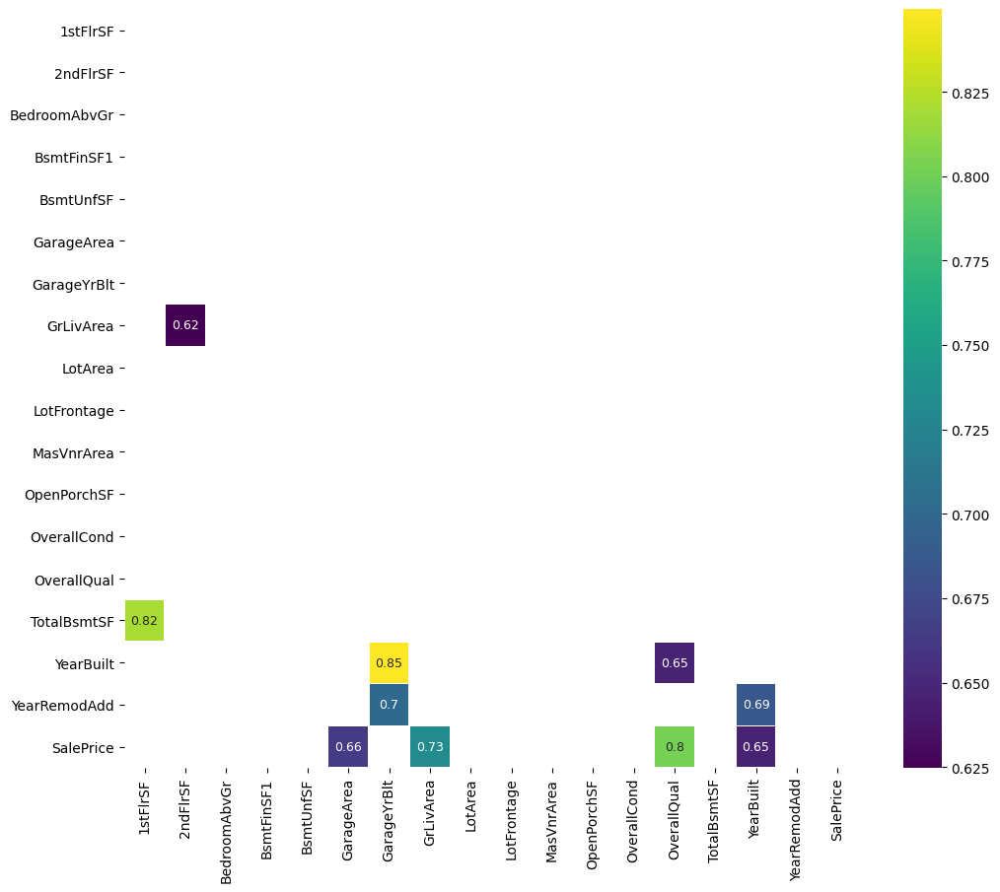



*** Heatmap: Pearson Correlation ***
It evaluates the linear relationship between two continuous variables 



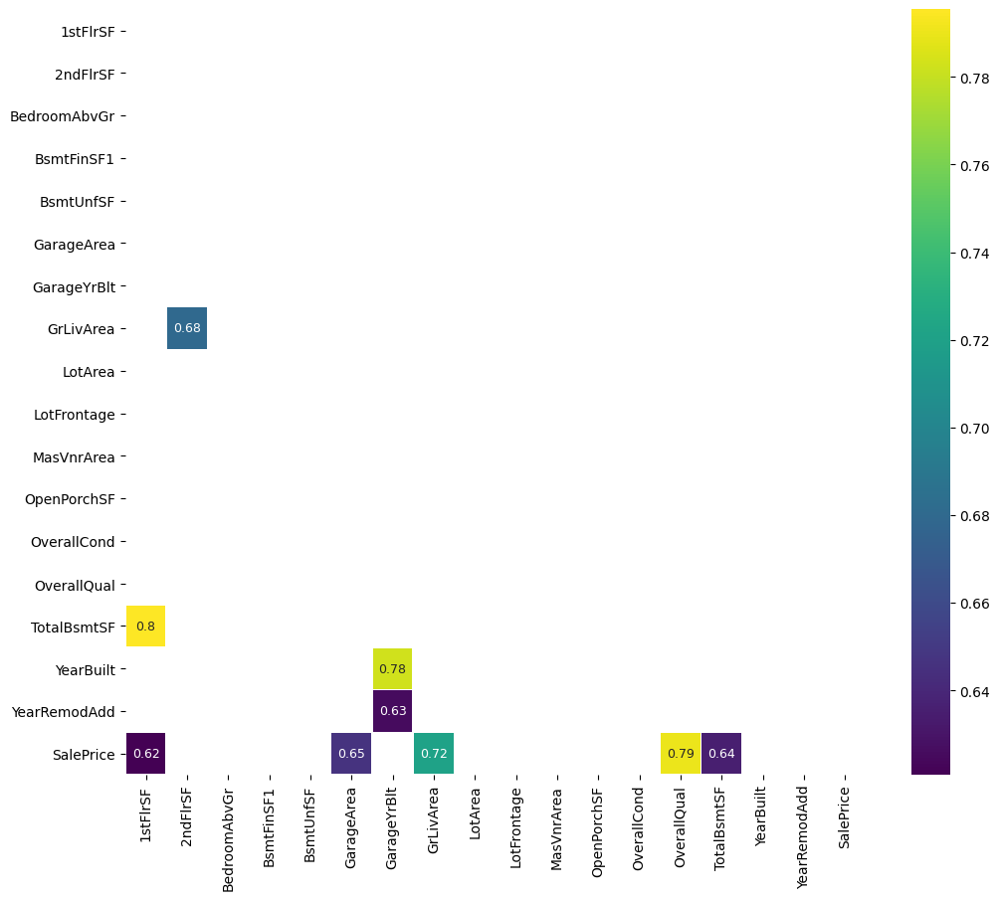



*** Heatmap: Power Predictive Score (PPS) ***
PPS detects linear or non-linear relationships between two columns.
The score ranges from 0 (no predictive power) to 1 (perfect predictive power) 



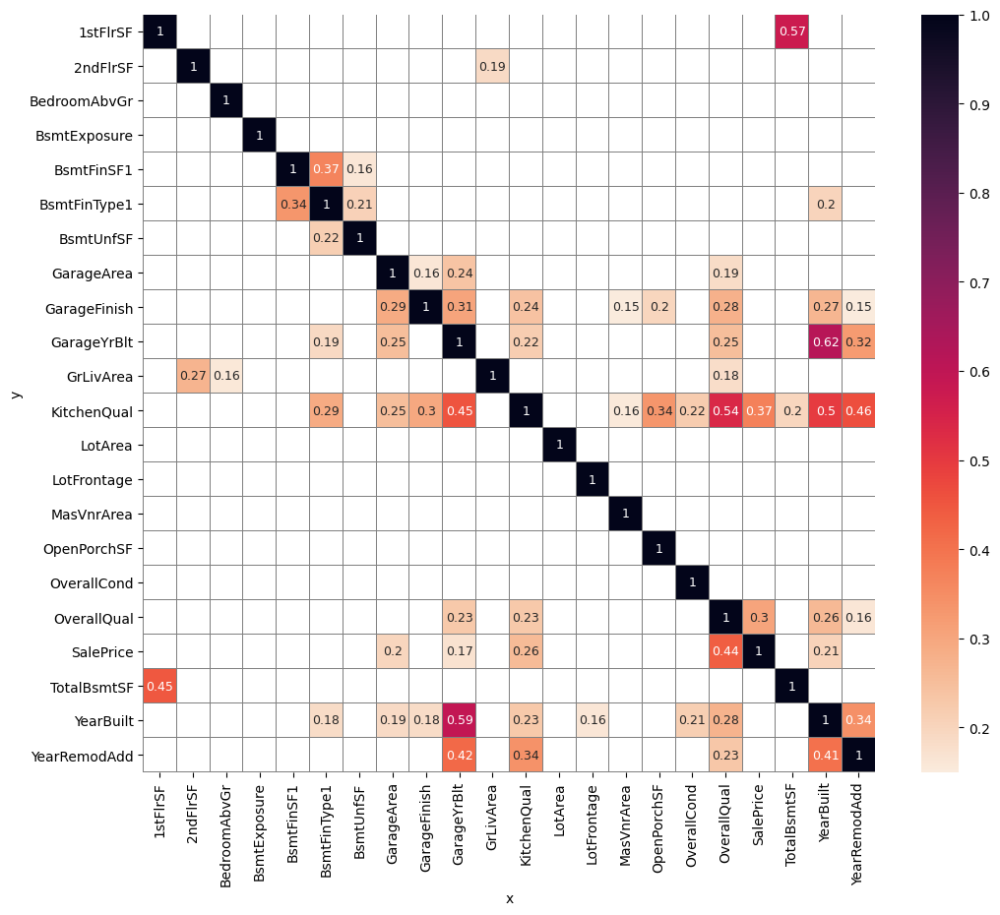

In [9]:
%matplotlib inline
DisplayCorrAndPPS(df_corr_pearson = df_corr_pearson,
                  df_corr_spearman = df_corr_spearman, 
                  pps_matrix = pps_matrix,
                  CorrThreshold = 0.6, PPS_Threshold =0.15,
                  figsize=(12,10), font_annot=9)

# Feature Engineering

Costum function from churno meter (Code institute)

In [10]:
import scipy.stats as stats
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import warnings
from feature_engine import transformation as vt
from feature_engine.outliers import Winsorizer
from feature_engine.encoding import OrdinalEncoder
sns.set(style="whitegrid")
warnings.filterwarnings('ignore')


def FeatureEngineeringAnalysis(df, analysis_type=None):
    """
    - used for quick feature engineering on numerical and categorical variables
    to decide which transformation can better transform the distribution shape
    - Once transformed, use a reporting tool, like ydata-profiling, to evaluate distributions
    """
    check_missing_values(df)
    allowed_types = ['numerical', 'ordinal_encoder', 'outlier_winsorizer']
    check_user_entry_on_analysis_type(analysis_type, allowed_types)
    list_column_transformers = define_list_column_transformers(analysis_type)

    # Loop in each variable and engineer the data according to the analysis type
    df_feat_eng = pd.DataFrame([])
    for column in df.columns:
        # create additional columns (column_method) to apply the methods
        df_feat_eng = pd.concat([df_feat_eng, df[column]], axis=1)
        for method in list_column_transformers:
            df_feat_eng[f"{column}_{method}"] = df[column]

        # Apply transformers in respective column_transformers
        df_feat_eng, list_applied_transformers = apply_transformers(
            analysis_type, df_feat_eng, column)

        # For each variable, assess how the transformations perform
        transformer_evaluation(
            column, list_applied_transformers, analysis_type, df_feat_eng)

    return df_feat_eng


def check_user_entry_on_analysis_type(analysis_type, allowed_types):
    """ Check analysis type """
    if analysis_type is None:
        raise SystemExit(
            f"You should pass analysis_type parameter as one of the following options: {allowed_types}")
    if analysis_type not in allowed_types:
        raise SystemExit(
            f"analysis_type argument should be one of these options: {allowed_types}")


def check_missing_values(df):
    if df.isna().sum().sum() != 0:
        raise SystemExit(
            f"There is a missing value in your dataset. Please handle that before getting into feature engineering.")


def define_list_column_transformers(analysis_type):
    """ Set suffix columns according to analysis_type"""
    if analysis_type == 'numerical':
        list_column_transformers = [
            "log_e", "log_10", "reciprocal", "power", "box_cox", "yeo_johnson"]

    elif analysis_type == 'ordinal_encoder':
        list_column_transformers = ["ordinal_encoder"]

    elif analysis_type == 'outlier_winsorizer':
        list_column_transformers = ['iqr']

    return list_column_transformers


def apply_transformers(analysis_type, df_feat_eng, column):
    for col in df_feat_eng.select_dtypes(include='category').columns:
        df_feat_eng[col] = df_feat_eng[col].astype('object')

    if analysis_type == 'numerical':
        df_feat_eng, list_applied_transformers = FeatEngineering_Numerical(
            df_feat_eng, column)

    elif analysis_type == 'outlier_winsorizer':
        df_feat_eng, list_applied_transformers = FeatEngineering_OutlierWinsorizer(
            df_feat_eng, column)

    elif analysis_type == 'ordinal_encoder':
        df_feat_eng, list_applied_transformers = FeatEngineering_CategoricalEncoder(
            df_feat_eng, column)

    return df_feat_eng, list_applied_transformers


def transformer_evaluation(column, list_applied_transformers, analysis_type, df_feat_eng):
    # For each variable, assess how the transformations perform
    print(f"* Variable Analyzed: {column}")
    print(f"* Applied transformation: {list_applied_transformers} \n")
    for col in [column] + list_applied_transformers:

        if analysis_type != 'ordinal_encoder':
            DiagnosticPlots_Numerical(df_feat_eng, col)

        else:
            if col == column:
                DiagnosticPlots_Categories(df_feat_eng, col)
            else:
                DiagnosticPlots_Numerical(df_feat_eng, col)

        print("\n")


def DiagnosticPlots_Categories(df_feat_eng, col):
    plt.figure(figsize=(4, 3))
    sns.countplot(data=df_feat_eng, x=col, palette=[
                  '#432371'], order=df_feat_eng[col].value_counts().index)
    plt.xticks(rotation=90)
    plt.suptitle(f"{col}", fontsize=30, y=1.05)
    plt.show()
    print("\n")


def DiagnosticPlots_Numerical(df, variable):
    fig, axes = plt.subplots(1, 3, figsize=(12, 4))
    sns.histplot(data=df, x=variable, kde=True, element="step", ax=axes[0])
    stats.probplot(df[variable], dist="norm", plot=axes[1])
    sns.boxplot(x=df[variable], ax=axes[2])

    axes[0].set_title('Histogram')
    axes[1].set_title('QQ Plot')
    axes[2].set_title('Boxplot')
    fig.suptitle(f"{variable}", fontsize=30, y=1.05)
    plt.tight_layout()
    plt.show()


def FeatEngineering_CategoricalEncoder(df_feat_eng, column):
    list_methods_worked = []
    try:
        encoder = OrdinalEncoder(encoding_method='arbitrary', variables=[
                                 f"{column}_ordinal_encoder"])
        df_feat_eng = encoder.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_ordinal_encoder")

    except Exception:
        df_feat_eng.drop([f"{column}_ordinal_encoder"], axis=1, inplace=True)

    return df_feat_eng, list_methods_worked


def FeatEngineering_OutlierWinsorizer(df_feat_eng, column):
    list_methods_worked = []

    # Winsorizer iqr
    try:
        disc = Winsorizer(
            capping_method='iqr', tail='both', fold=1.5, variables=[f"{column}_iqr"])
        df_feat_eng = disc.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_iqr")
    except Exception:
        df_feat_eng.drop([f"{column}_iqr"], axis=1, inplace=True)

    return df_feat_eng, list_methods_worked


def FeatEngineering_Numerical(df_feat_eng, column):
    list_methods_worked = []

    # LogTransformer base e
    try:
        lt = vt.LogTransformer(variables=[f"{column}_log_e"])
        df_feat_eng = lt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_log_e")
    except Exception:
        df_feat_eng.drop([f"{column}_log_e"], axis=1, inplace=True)

    # LogTransformer base 10
    try:
        lt = vt.LogTransformer(variables=[f"{column}_log_10"], base='10')
        df_feat_eng = lt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_log_10")
    except Exception:
        df_feat_eng.drop([f"{column}_log_10"], axis=1, inplace=True)

    # ReciprocalTransformer
    try:
        rt = vt.ReciprocalTransformer(variables=[f"{column}_reciprocal"])
        df_feat_eng = rt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_reciprocal")
    except Exception:
        df_feat_eng.drop([f"{column}_reciprocal"], axis=1, inplace=True)

    # PowerTransformer
    try:
        pt = vt.PowerTransformer(variables=[f"{column}_power"])
        df_feat_eng = pt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_power")
    except Exception:
        df_feat_eng.drop([f"{column}_power"], axis=1, inplace=True)

    # BoxCoxTransformer
    try:
        bct = vt.BoxCoxTransformer(variables=[f"{column}_box_cox"])
        df_feat_eng = bct.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_box_cox")
    except Exception:
        df_feat_eng.drop([f"{column}_box_cox"], axis=1, inplace=True)

    # YeoJohnsonTransformer
    try:
        yjt = vt.YeoJohnsonTransformer(variables=[f"{column}_yeo_johnson"])
        df_feat_eng = yjt.fit_transform(df_feat_eng)
        list_methods_worked.append(f"{column}_yeo_johnson")
    except Exception:
        df_feat_eng.drop([f"{column}_yeo_johnson"], axis=1, inplace=True)

    return df_feat_eng, list_methods_worked

# Feature Engineering transformation
* Categorical Encoding
* Numerical Transformation
* Handle outliers
* Smart Correlation Selectiontion

## Categorical Encoding

- get the object type 

In [11]:
categorical = (TrainSet.select_dtypes(include=['object']).columns.to_list())
categorical

['BsmtExposure', 'BsmtFinType1', 'GarageFinish', 'KitchenQual']

In [12]:
df_method = TrainSet[categorical].copy()
df_method.head()

,BsmtExposure,BsmtFinType1,GarageFinish,KitchenQual
0,Av,Unf,Unf,Gd
1,No,Unf,Unf,TA
2,No,ALQ,Unf,TA
3,No,GLQ,RFn,Gd
4,No,Unf,RFn,Gd


* Variable Analyzed: BsmtExposure
* Applied transformation: ['BsmtExposure_ordinal_encoder'] 



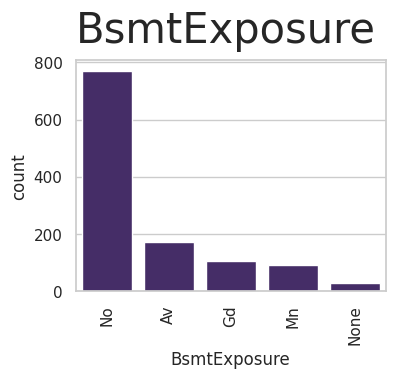

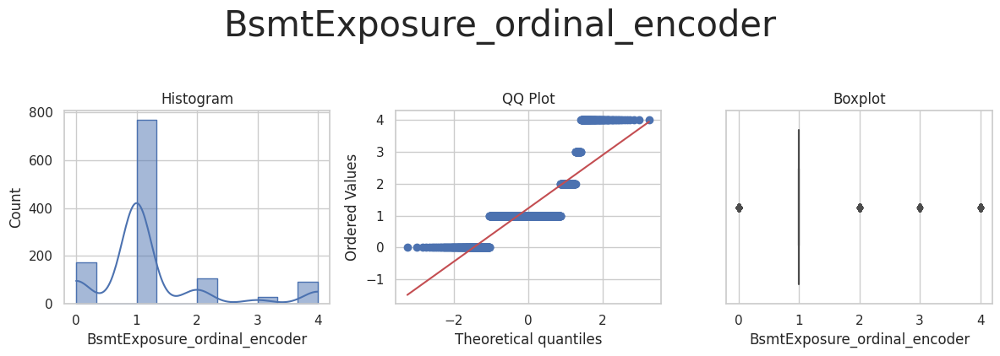



* Variable Analyzed: BsmtFinType1
* Applied transformation: ['BsmtFinType1_ordinal_encoder'] 



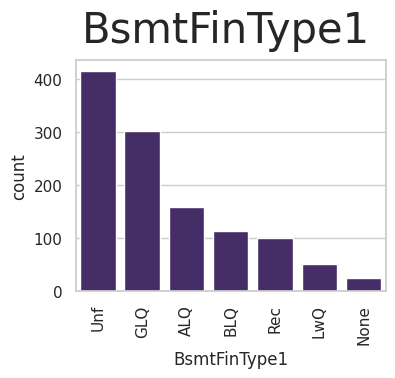

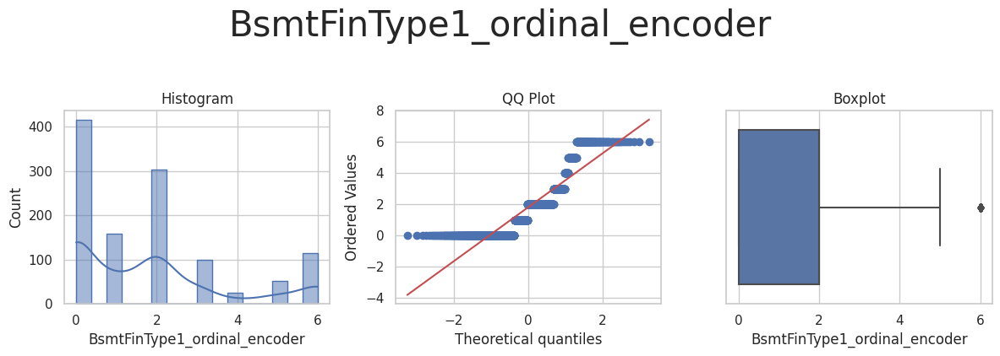



* Variable Analyzed: GarageFinish
* Applied transformation: ['GarageFinish_ordinal_encoder'] 



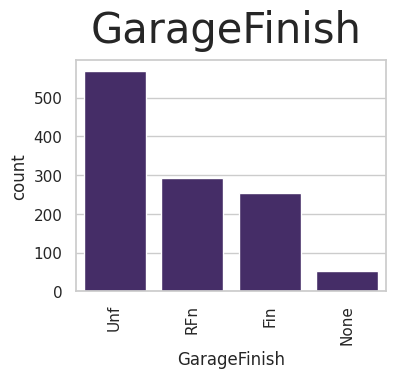

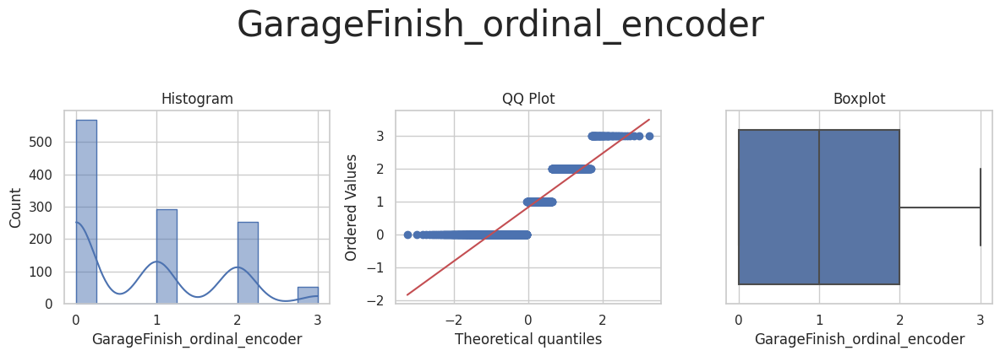



* Variable Analyzed: KitchenQual
* Applied transformation: ['KitchenQual_ordinal_encoder'] 



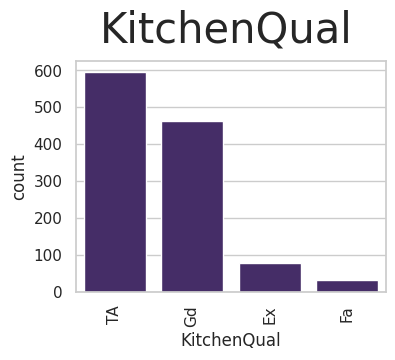

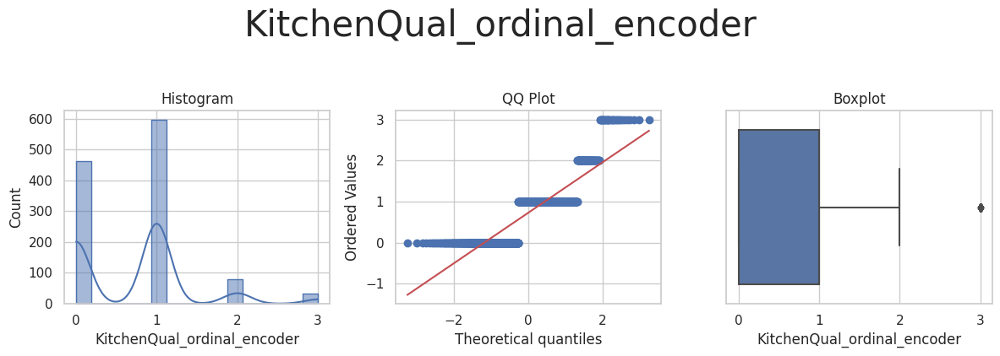

In [13]:
df_method = FeatureEngineeringAnalysis(df=df_method, analysis_type='ordinal_encoder')

In [14]:
encoder = OrdinalEncoder(encoding_method='arbitrary', variables = categorical)
TrainSet = encoder.fit_transform(TrainSet)
TestSet = encoder.transform(TestSet)

## Numerical Transformation

In [15]:
numerical = (TrainSet.select_dtypes(include=['float', 'int']).columns.to_list())
numerical.remove('SalePrice')
numerical

['1stFlrSF',
 '2ndFlrSF',
 'BedroomAbvGr',
 'BsmtExposure',
 'BsmtFinSF1',
 'BsmtFinType1',
 'BsmtUnfSF',
 'GarageArea',
 'GarageFinish',
 'GarageYrBlt',
 'GrLivArea',
 'KitchenQual',
 'LotArea',
 'LotFrontage',
 'MasVnrArea',
 'OpenPorchSF',
 'OverallCond',
 'OverallQual',
 'TotalBsmtSF',
 'YearBuilt',
 'YearRemodAdd']

In [16]:
df_method = TrainSet[numerical].copy()
df_method.head()

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,KitchenQual,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd
0,1828,0.0,3.0,0,48,0,1774,774,0,2007.0,...,0,11694,90.0,452.0,108,5,9,1822,2007,2007
1,894,0.0,2.0,1,0,0,894,308,0,1962.0,...,1,6600,60.0,0.0,0,5,5,894,1962,1962
2,964,0.0,2.0,1,713,1,163,432,0,1921.0,...,1,13360,80.0,0.0,0,7,5,876,1921,2006
3,1689,0.0,3.0,1,1218,2,350,857,1,2002.0,...,0,13265,69.0,148.0,59,5,8,1568,2002,2002
4,1541,0.0,3.0,1,0,0,1541,843,1,2001.0,...,0,13704,118.0,150.0,81,5,7,1541,2001,2002


* Variable Analyzed: 1stFlrSF
* Applied transformation: ['1stFlrSF_log_e', '1stFlrSF_log_10', '1stFlrSF_reciprocal', '1stFlrSF_power', '1stFlrSF_box_cox', '1stFlrSF_yeo_johnson'] 



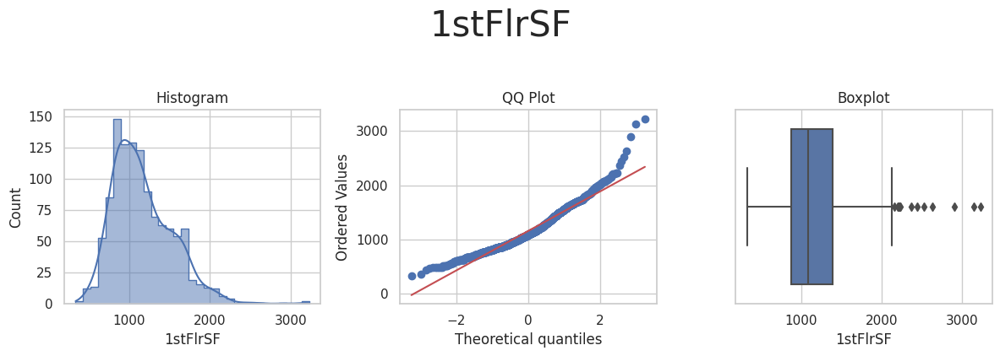

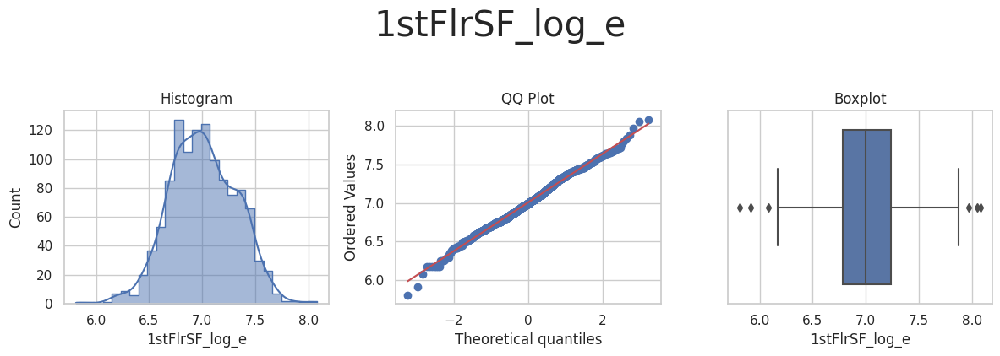

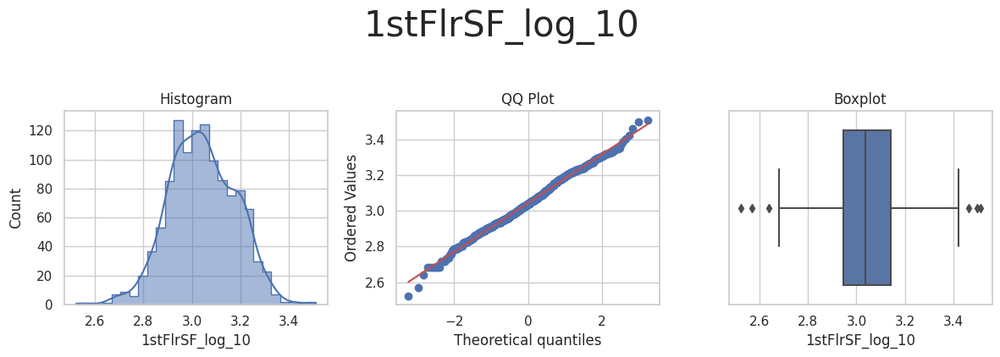

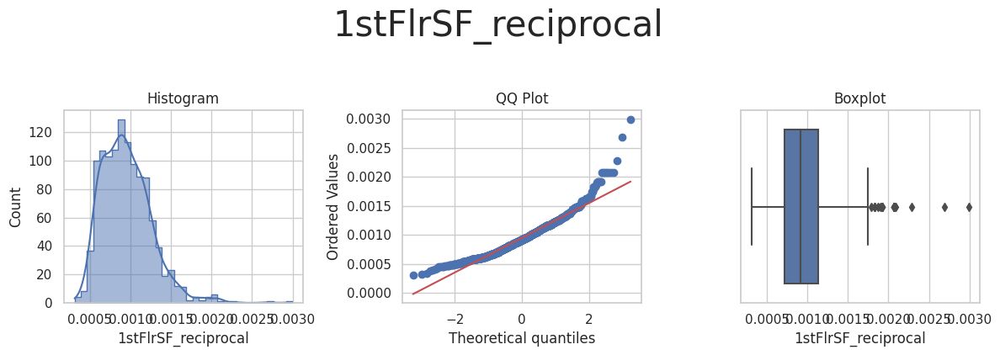

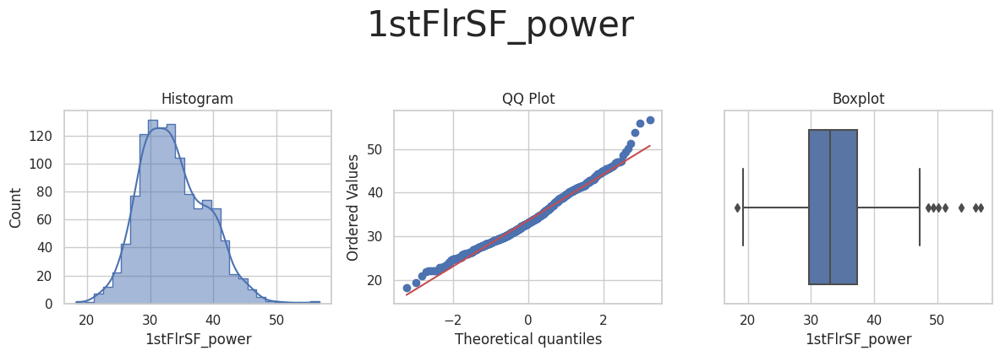

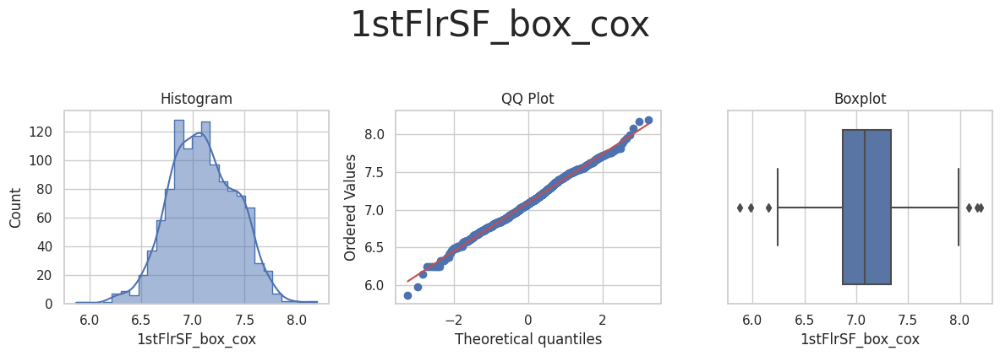

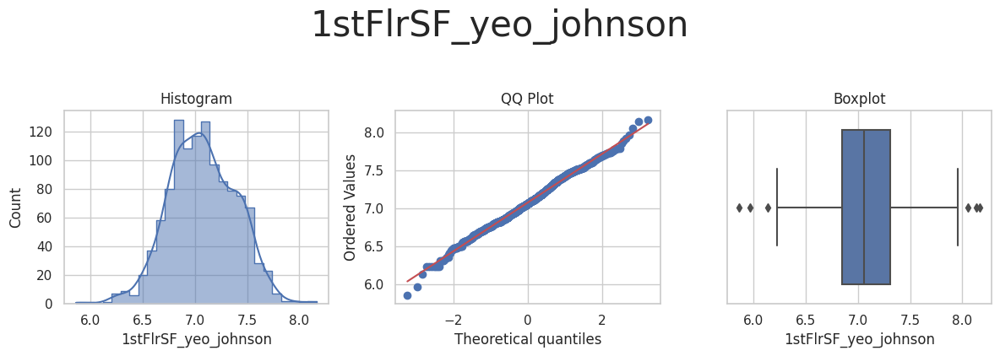



* Variable Analyzed: 2ndFlrSF
* Applied transformation: ['2ndFlrSF_power', '2ndFlrSF_yeo_johnson'] 



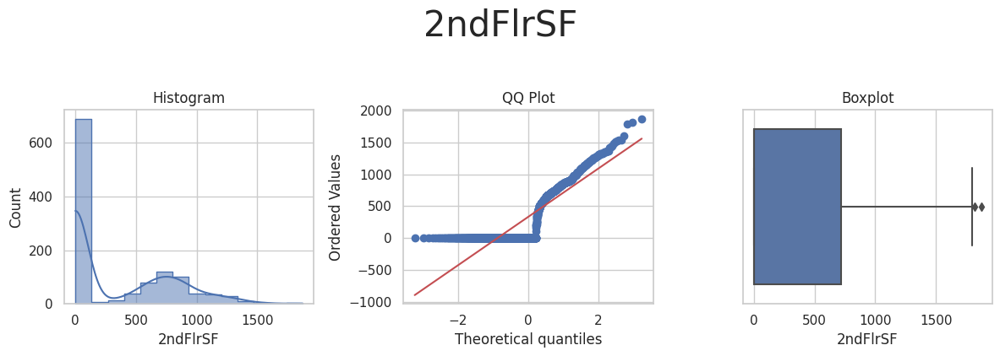

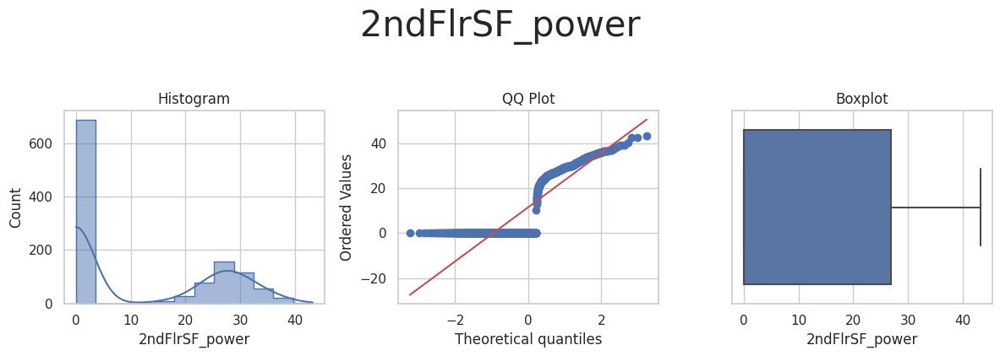

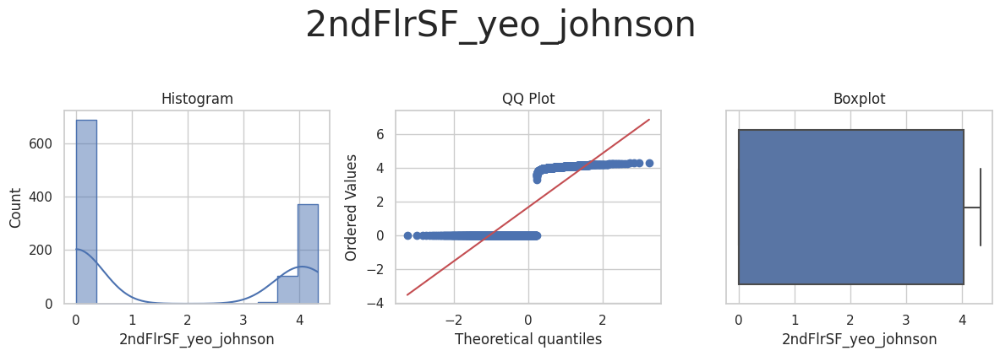



* Variable Analyzed: BedroomAbvGr
* Applied transformation: ['BedroomAbvGr_power', 'BedroomAbvGr_yeo_johnson'] 



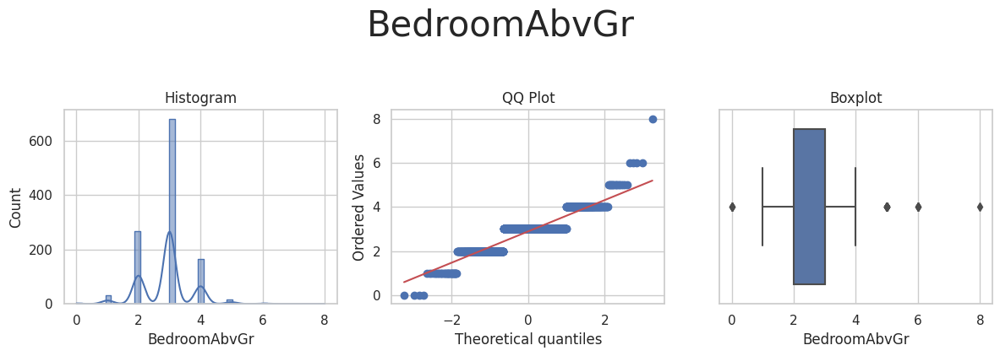

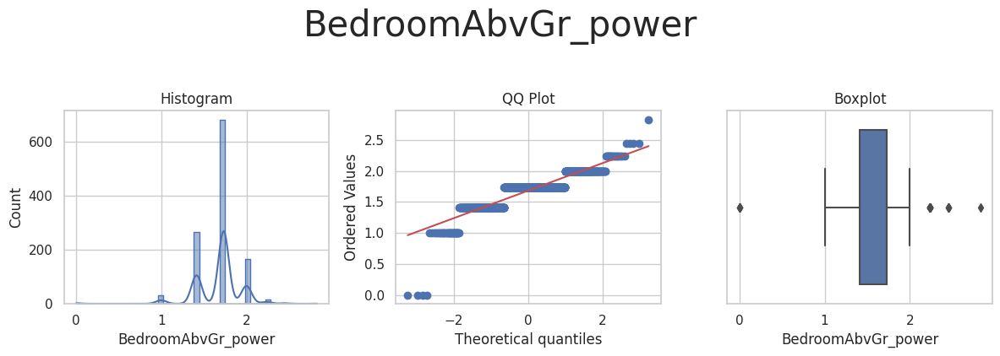

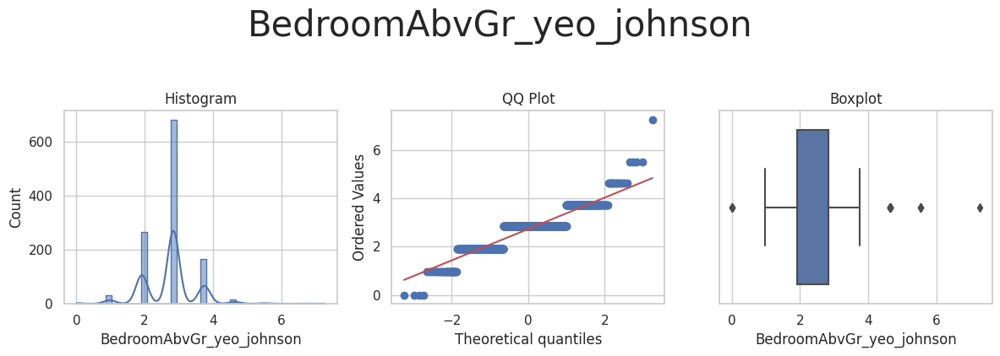



* Variable Analyzed: BsmtExposure
* Applied transformation: ['BsmtExposure_power', 'BsmtExposure_yeo_johnson'] 



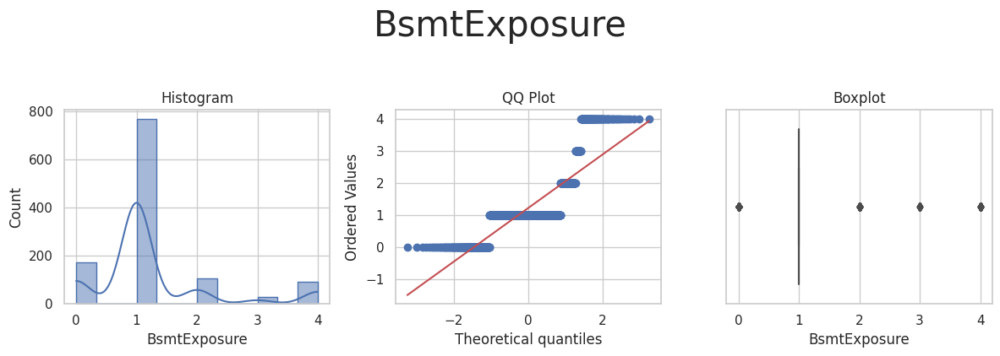

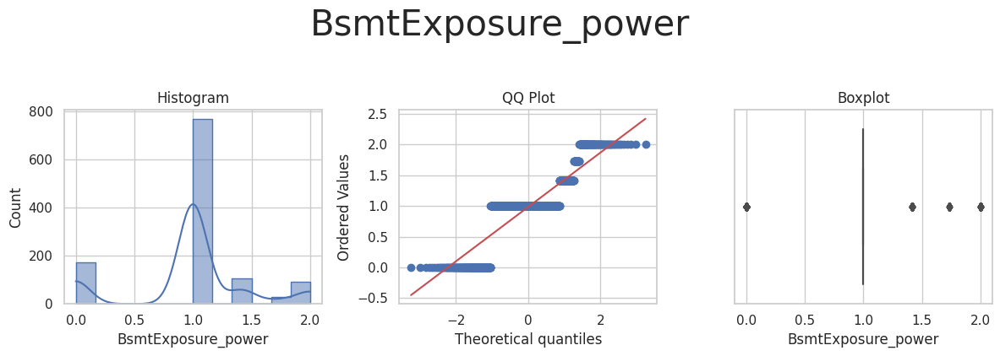

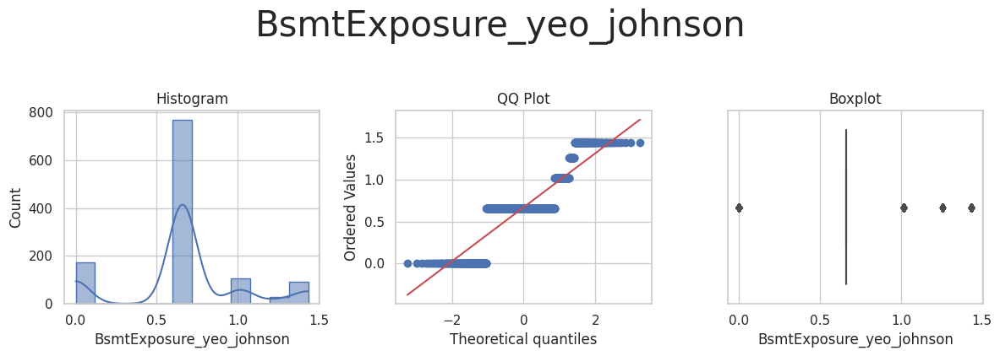



* Variable Analyzed: BsmtFinSF1
* Applied transformation: ['BsmtFinSF1_power', 'BsmtFinSF1_yeo_johnson'] 



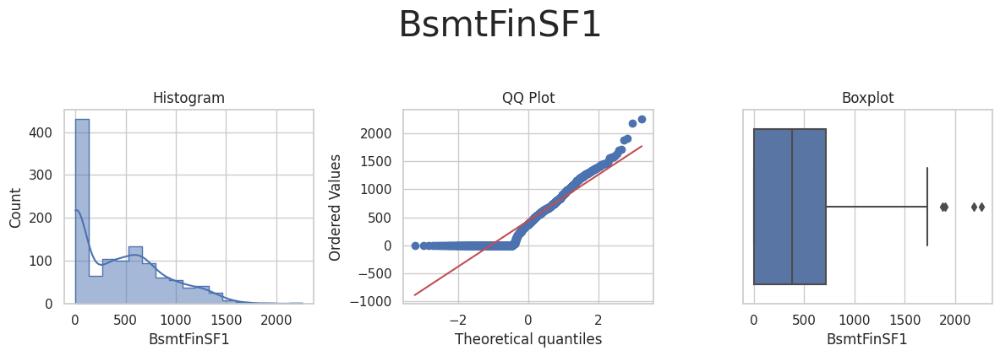

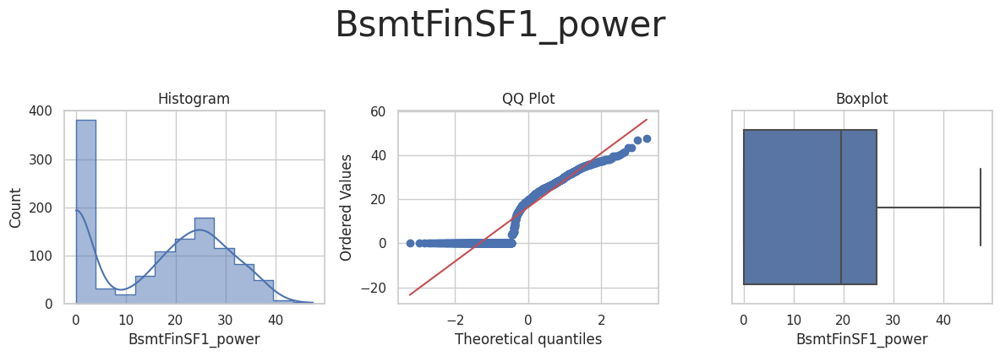

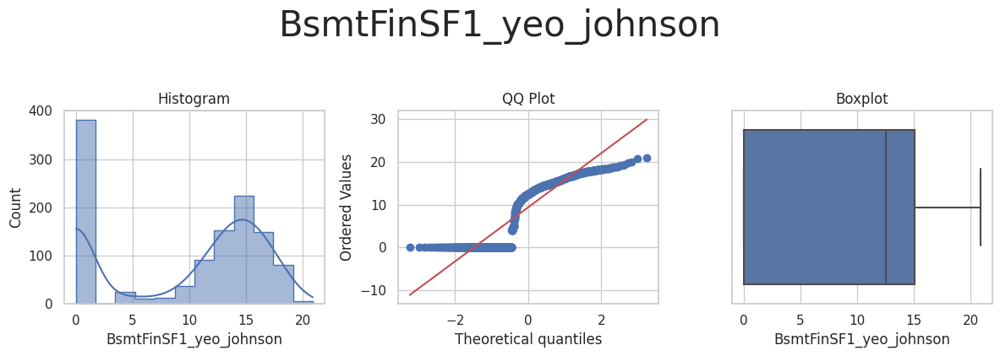



* Variable Analyzed: BsmtFinType1
* Applied transformation: ['BsmtFinType1_power', 'BsmtFinType1_yeo_johnson'] 



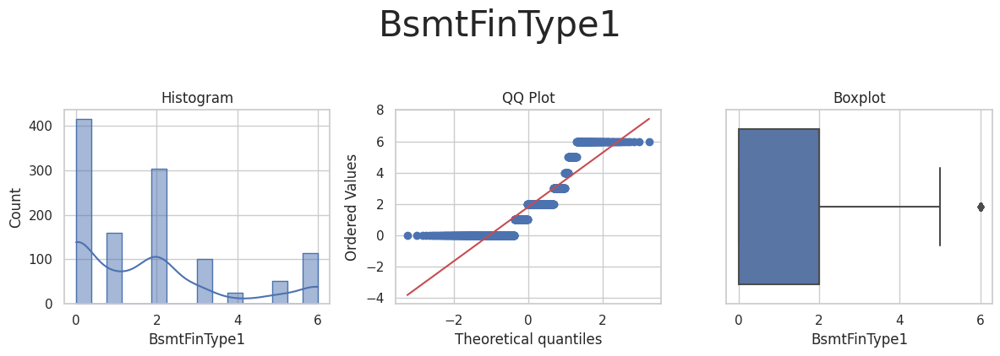

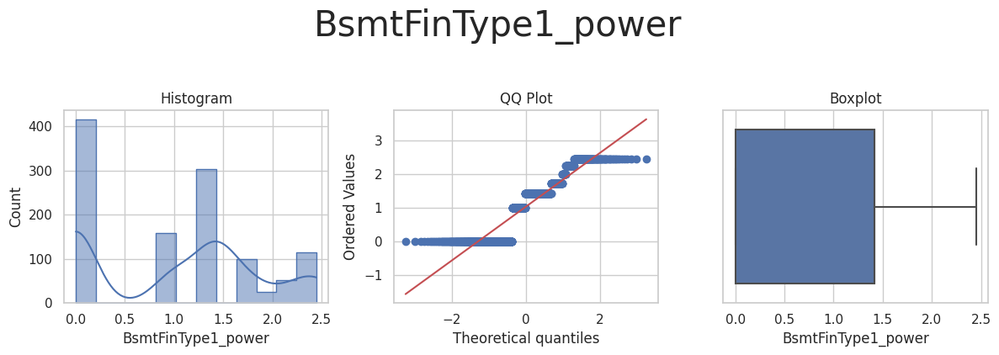

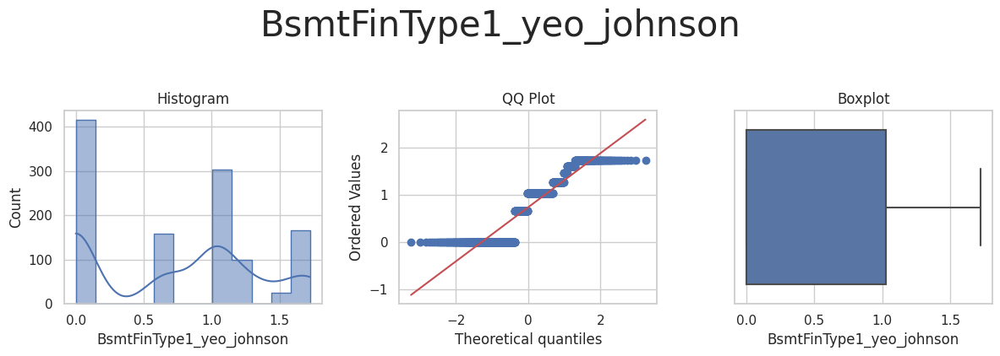



* Variable Analyzed: BsmtUnfSF
* Applied transformation: ['BsmtUnfSF_power', 'BsmtUnfSF_yeo_johnson'] 



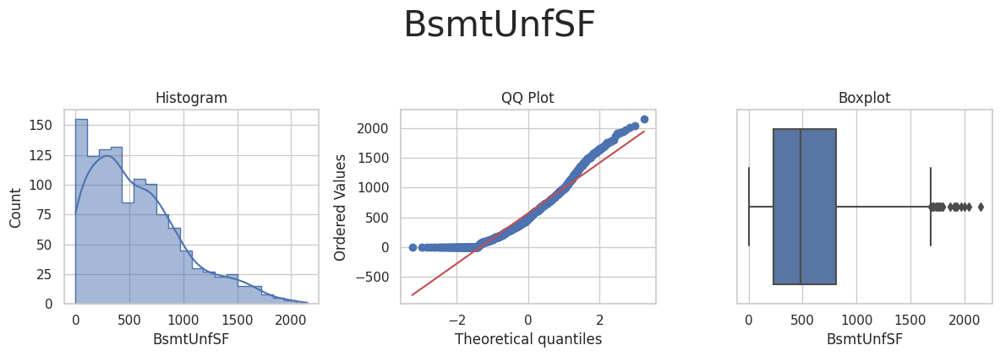

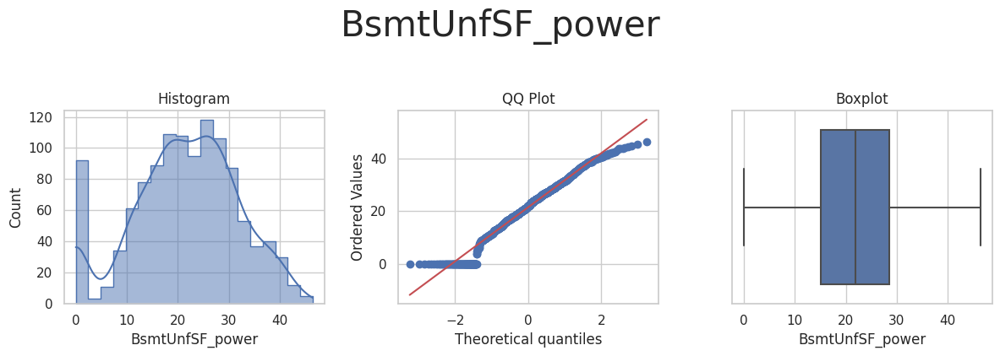

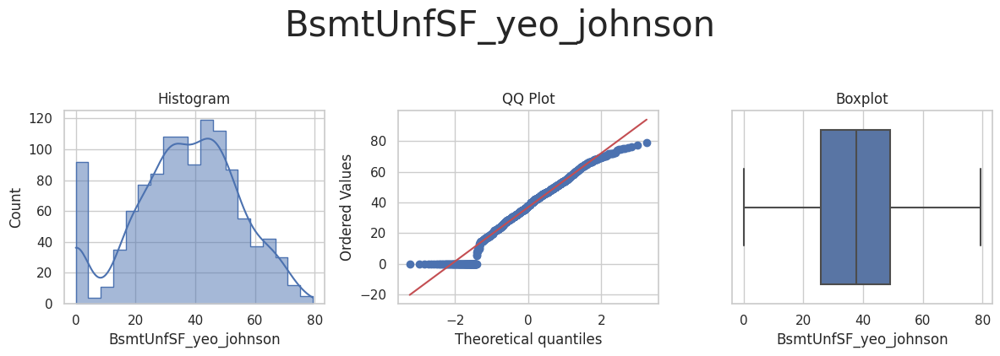



* Variable Analyzed: GarageArea
* Applied transformation: ['GarageArea_power', 'GarageArea_yeo_johnson'] 



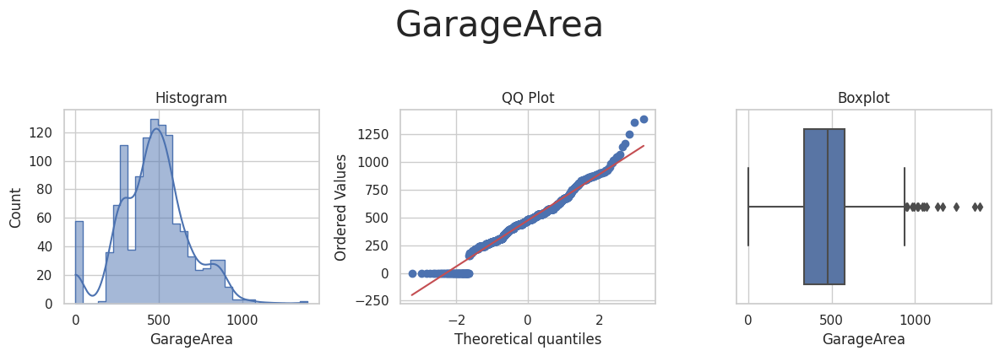

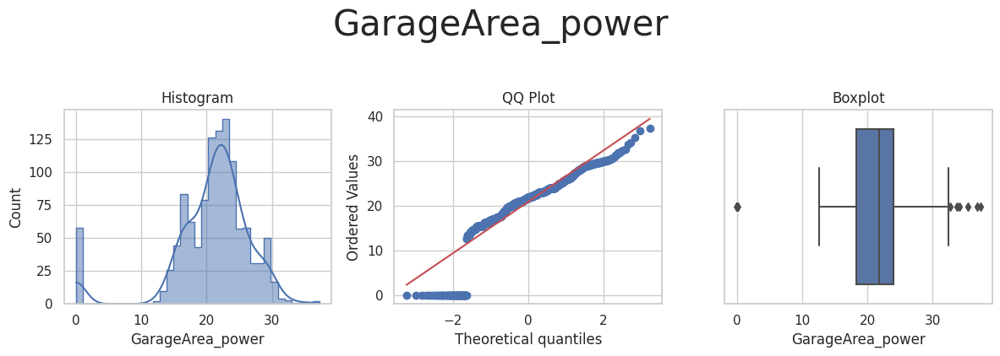

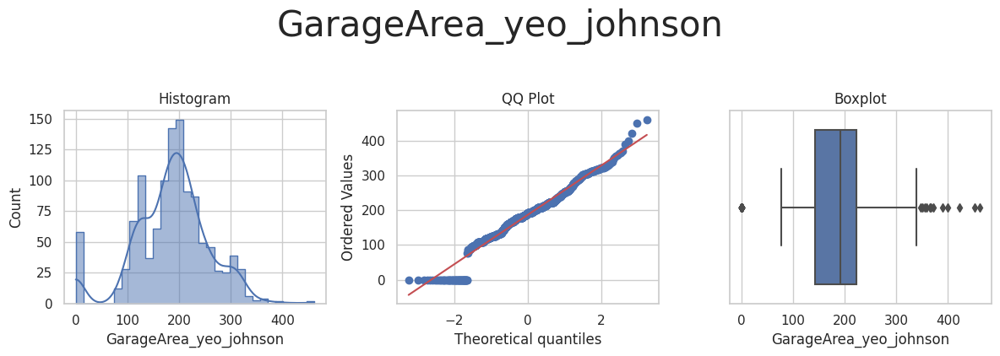



* Variable Analyzed: GarageFinish
* Applied transformation: ['GarageFinish_power', 'GarageFinish_yeo_johnson'] 



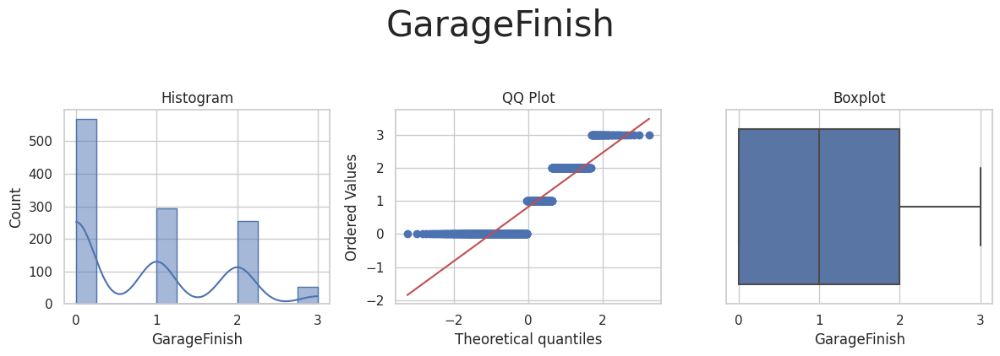

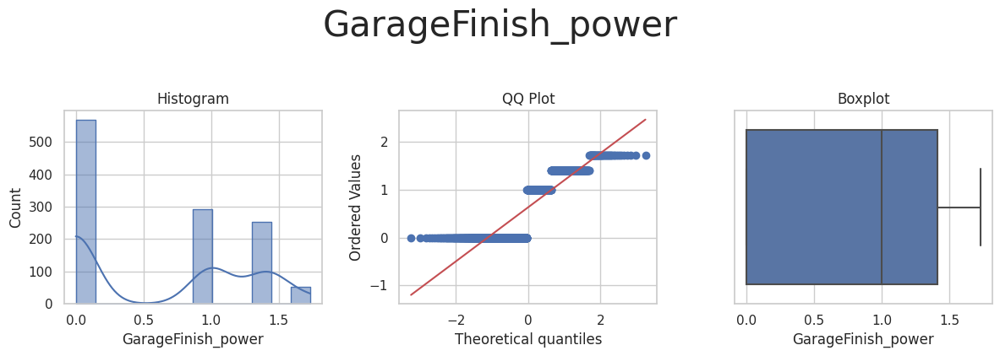

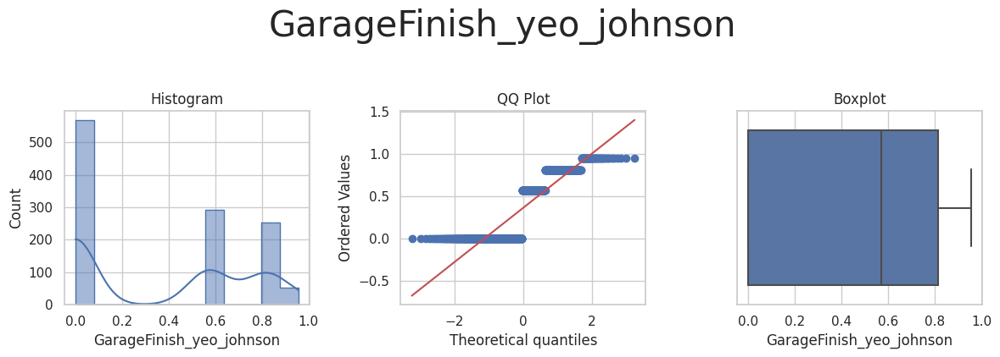



* Variable Analyzed: GarageYrBlt
* Applied transformation: ['GarageYrBlt_log_e', 'GarageYrBlt_log_10', 'GarageYrBlt_reciprocal', 'GarageYrBlt_power', 'GarageYrBlt_box_cox', 'GarageYrBlt_yeo_johnson'] 



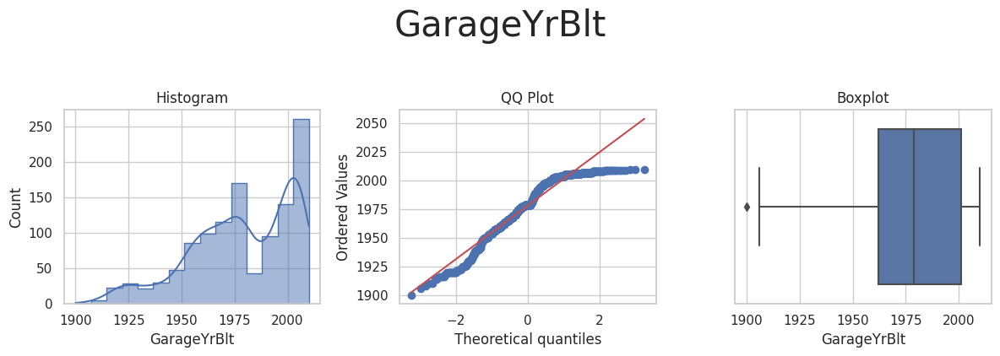

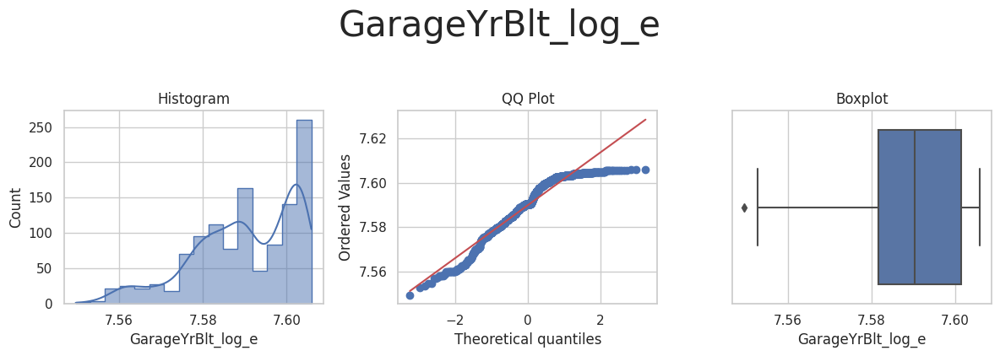

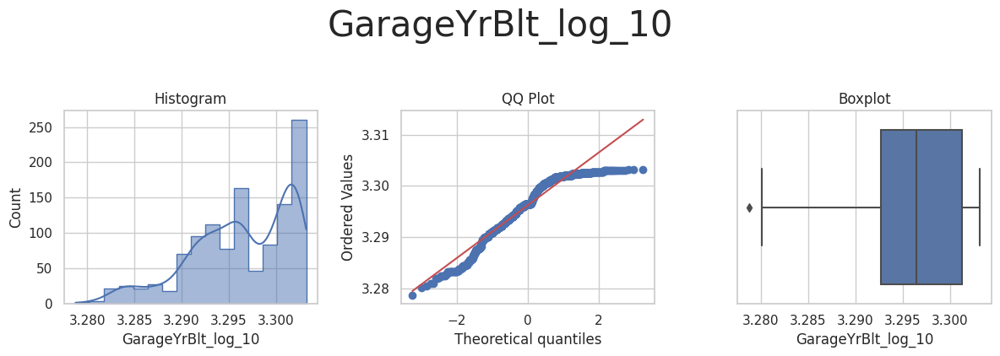

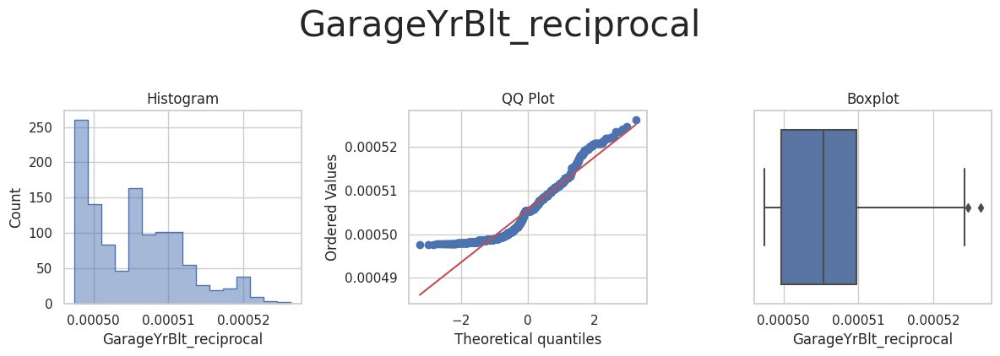

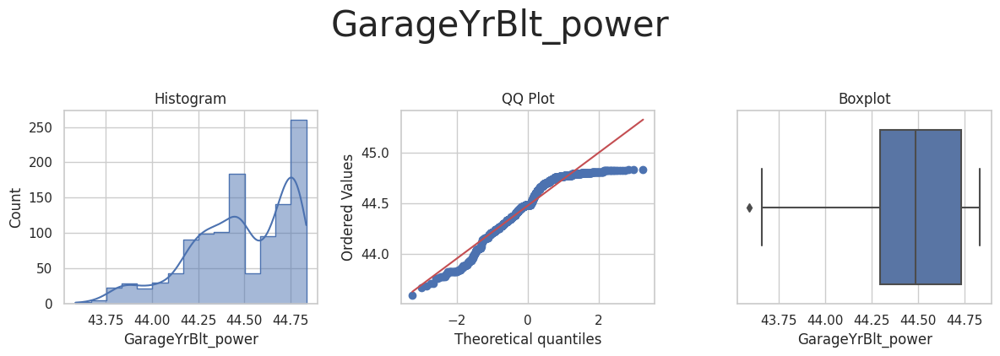

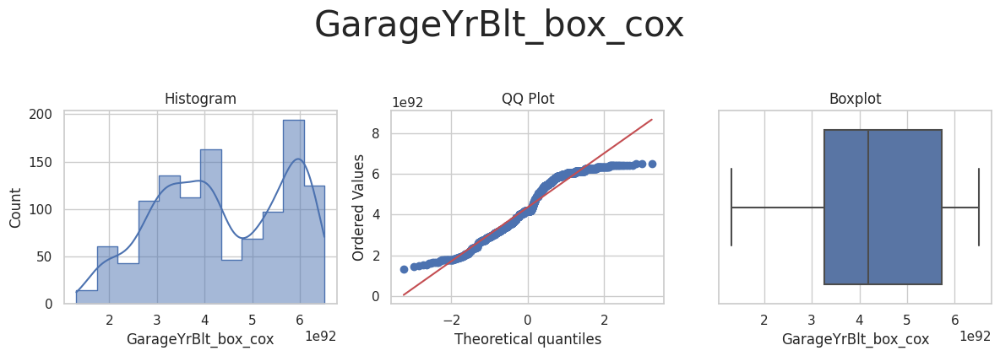

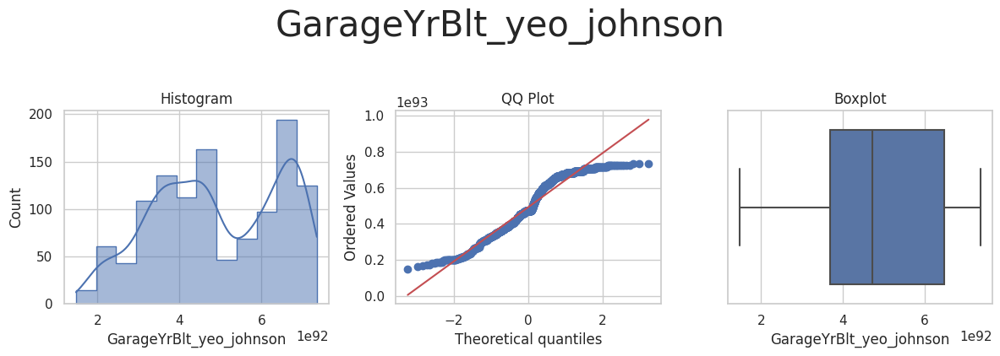



* Variable Analyzed: GrLivArea
* Applied transformation: ['GrLivArea_log_e', 'GrLivArea_log_10', 'GrLivArea_reciprocal', 'GrLivArea_power', 'GrLivArea_box_cox', 'GrLivArea_yeo_johnson'] 



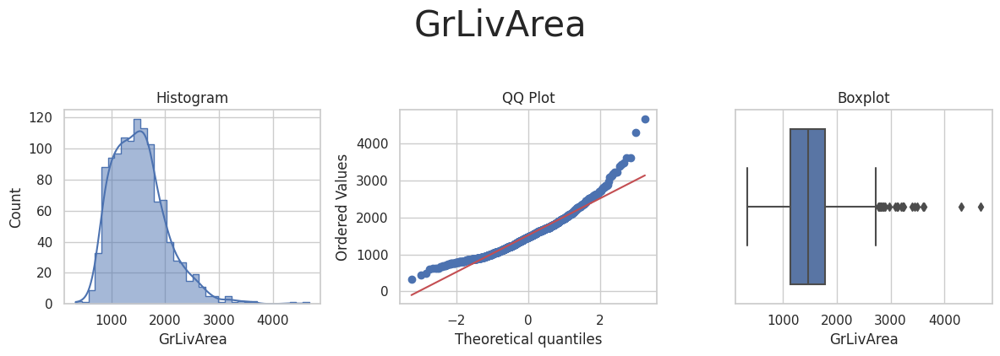

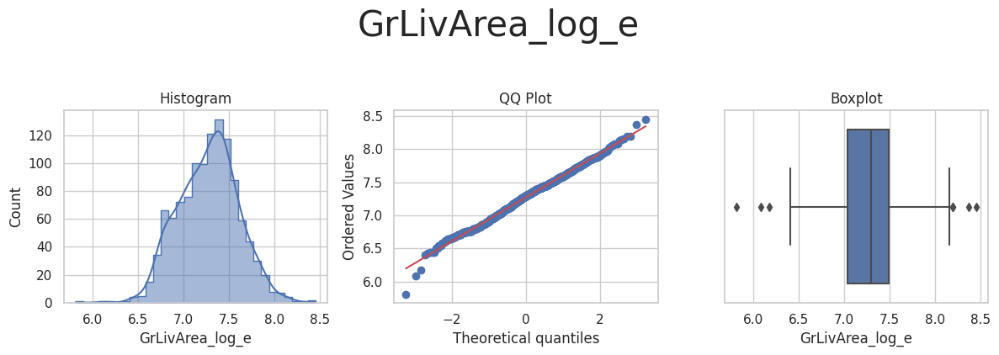

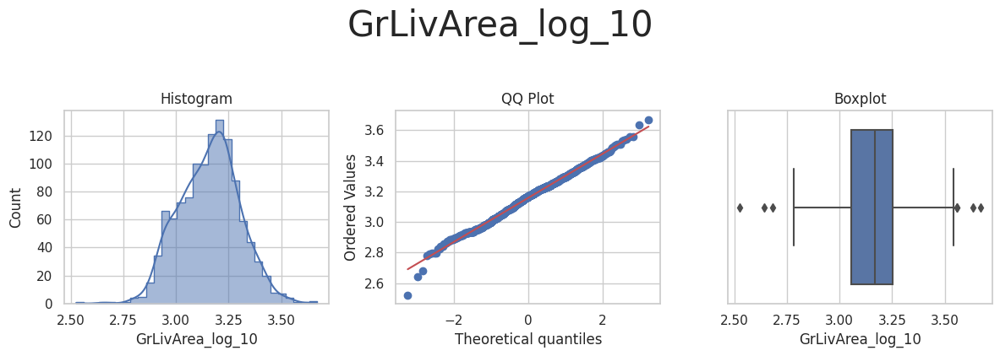

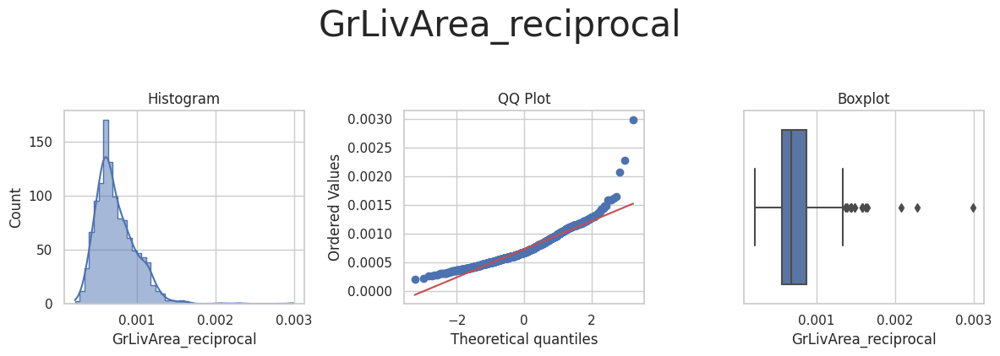

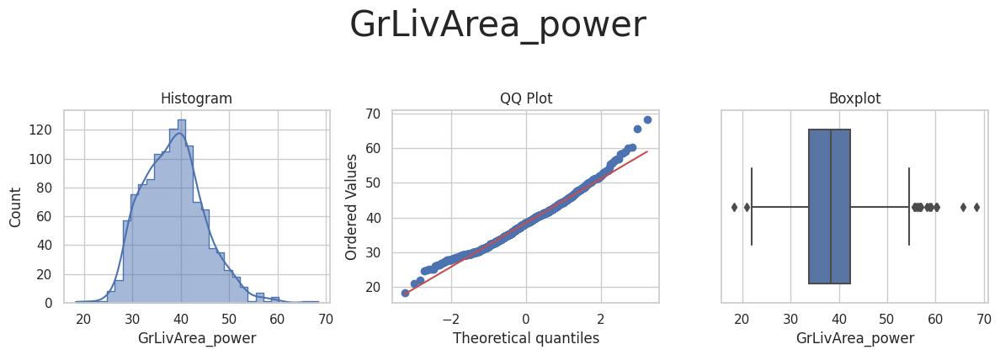

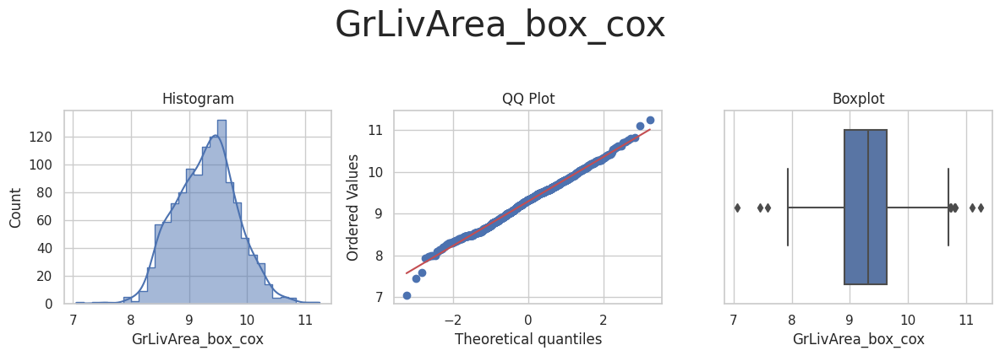

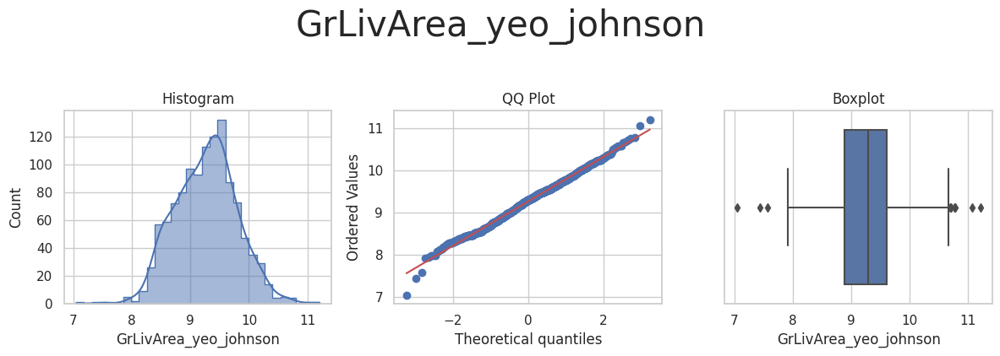



* Variable Analyzed: KitchenQual
* Applied transformation: ['KitchenQual_power', 'KitchenQual_yeo_johnson'] 



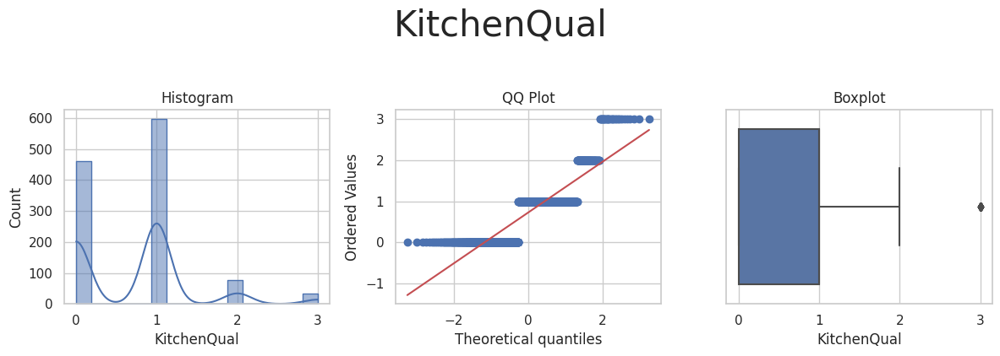

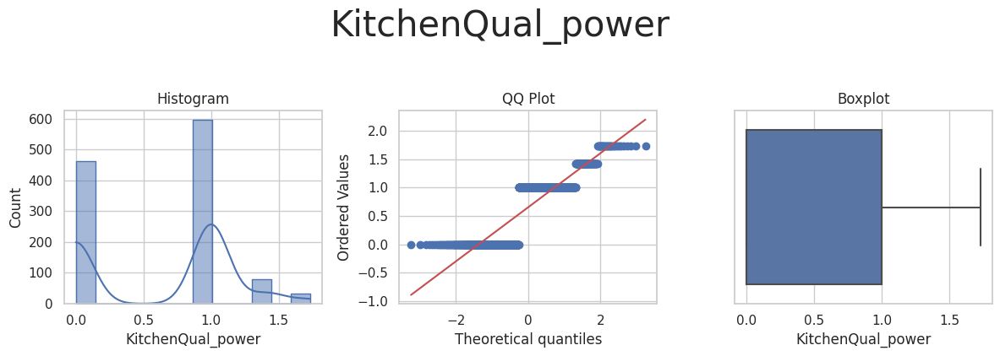

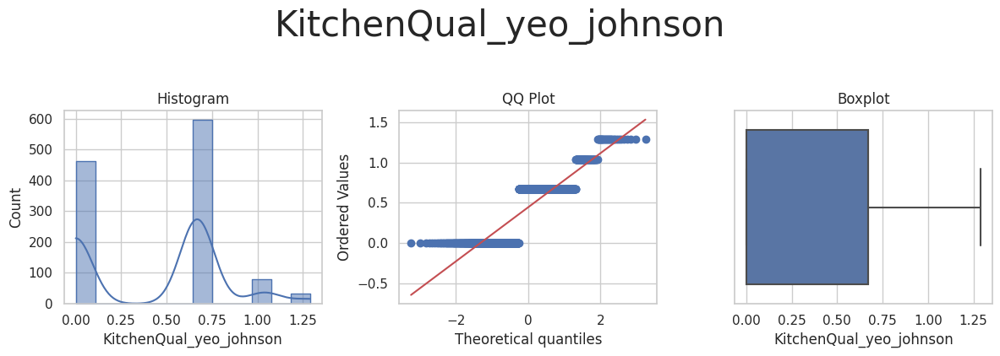



* Variable Analyzed: LotArea
* Applied transformation: ['LotArea_log_e', 'LotArea_log_10', 'LotArea_reciprocal', 'LotArea_power', 'LotArea_box_cox', 'LotArea_yeo_johnson'] 



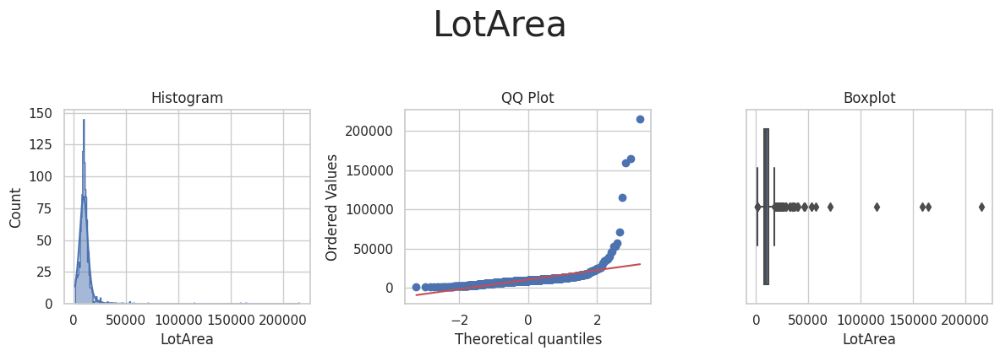

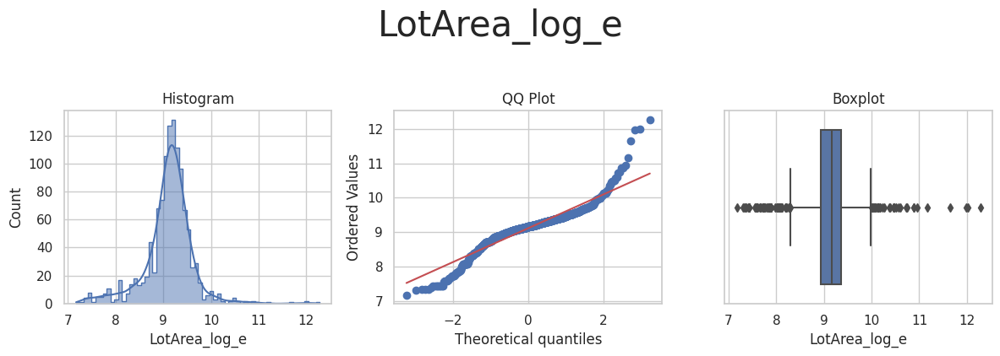

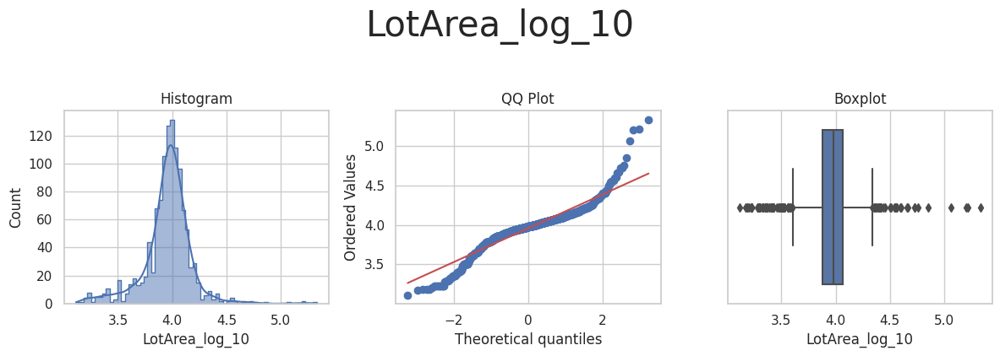

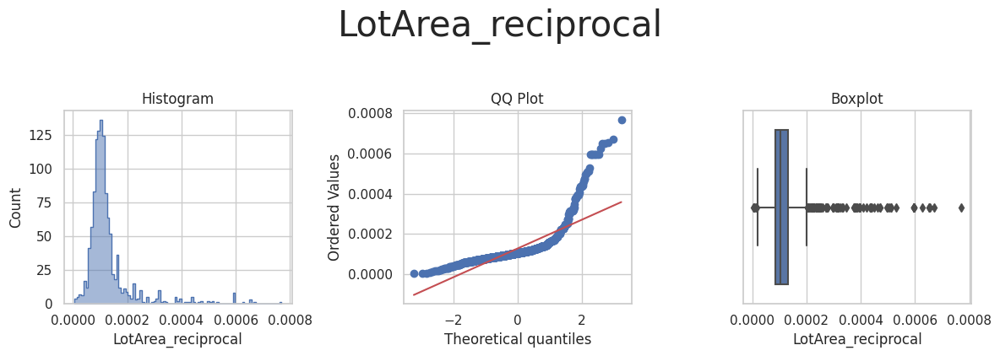

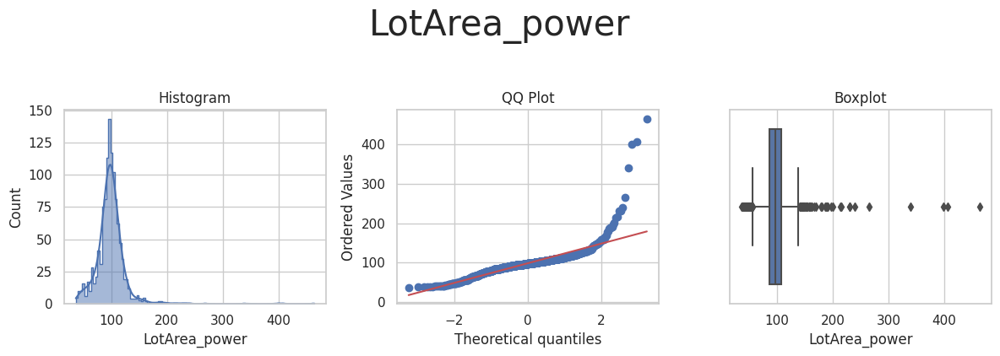

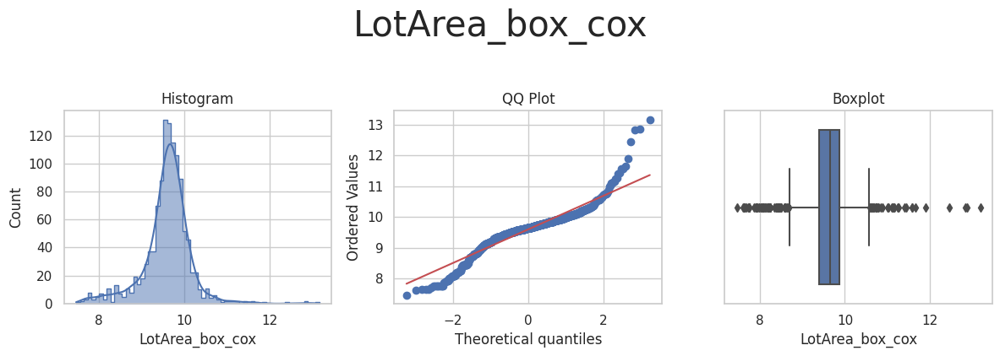

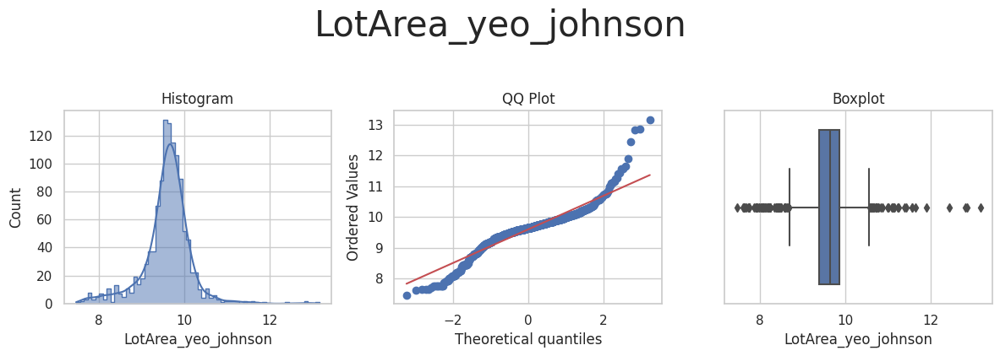



* Variable Analyzed: LotFrontage
* Applied transformation: ['LotFrontage_log_e', 'LotFrontage_log_10', 'LotFrontage_reciprocal', 'LotFrontage_power', 'LotFrontage_box_cox', 'LotFrontage_yeo_johnson'] 



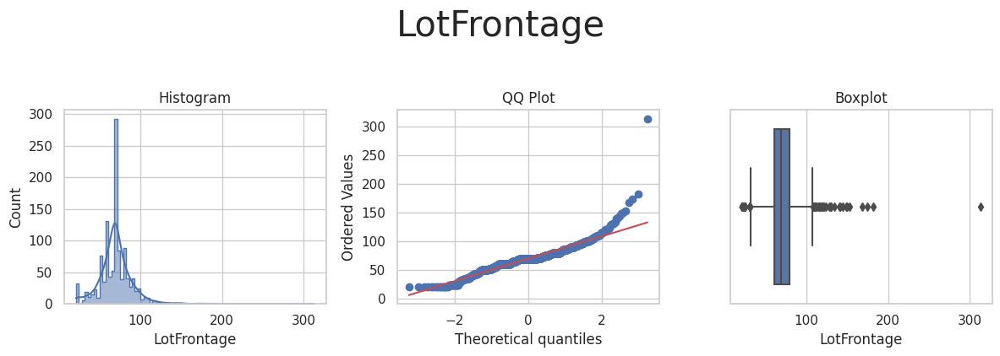

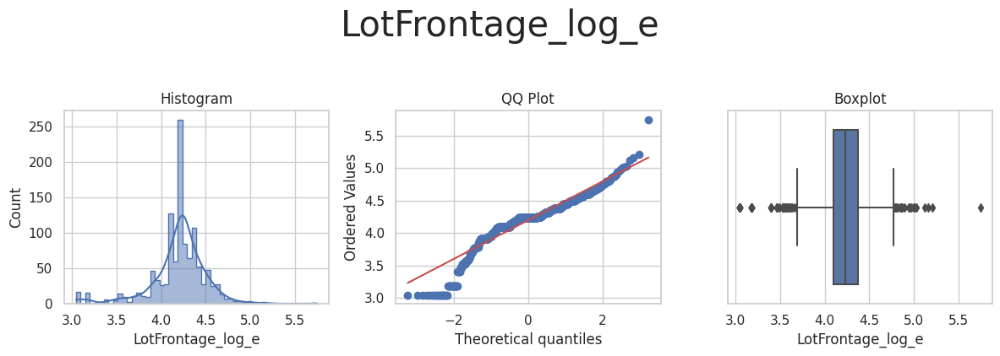

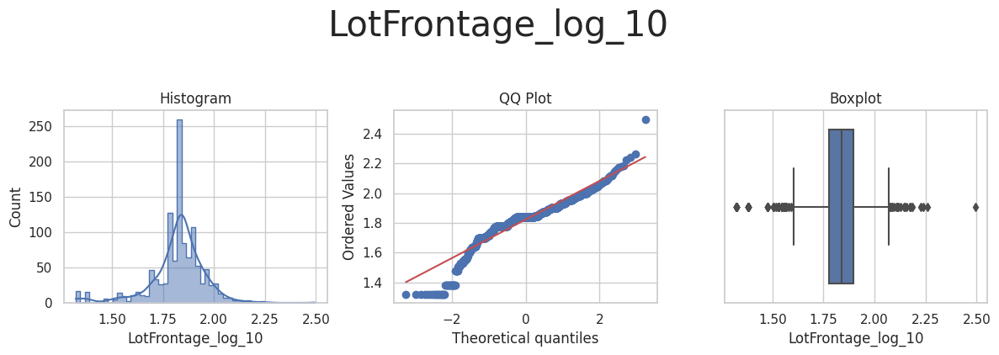

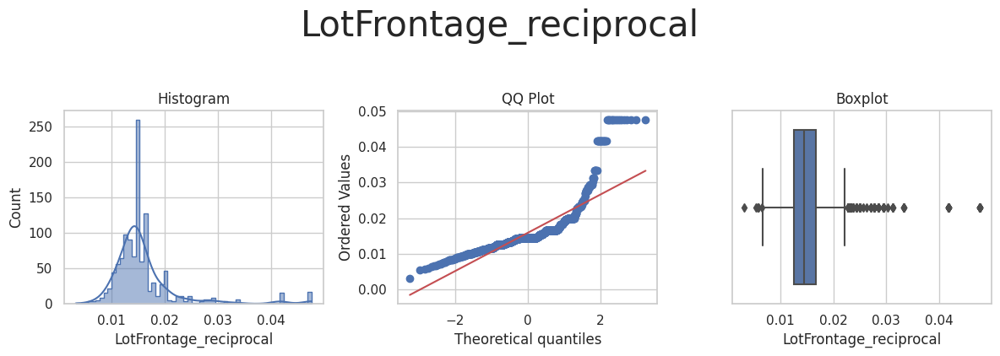

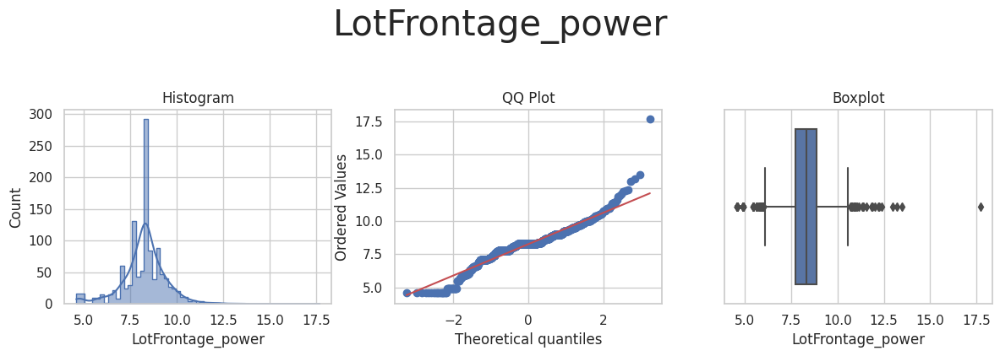

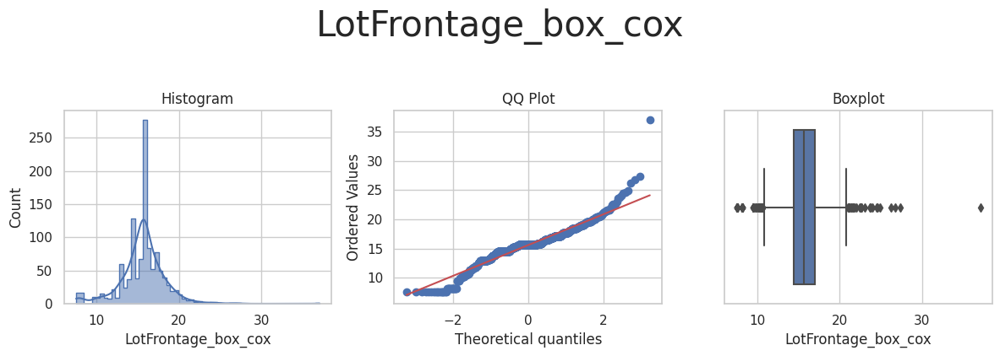

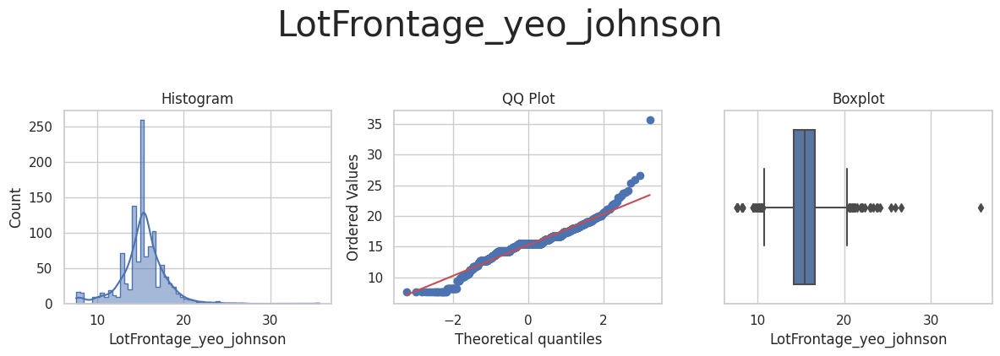



* Variable Analyzed: MasVnrArea
* Applied transformation: ['MasVnrArea_power', 'MasVnrArea_yeo_johnson'] 



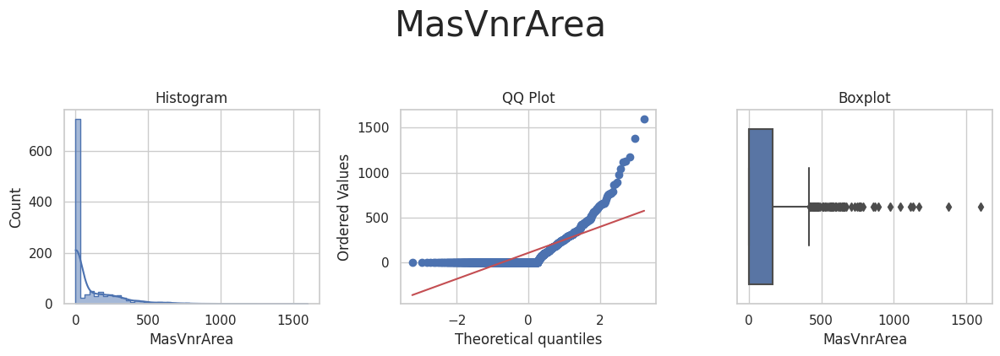

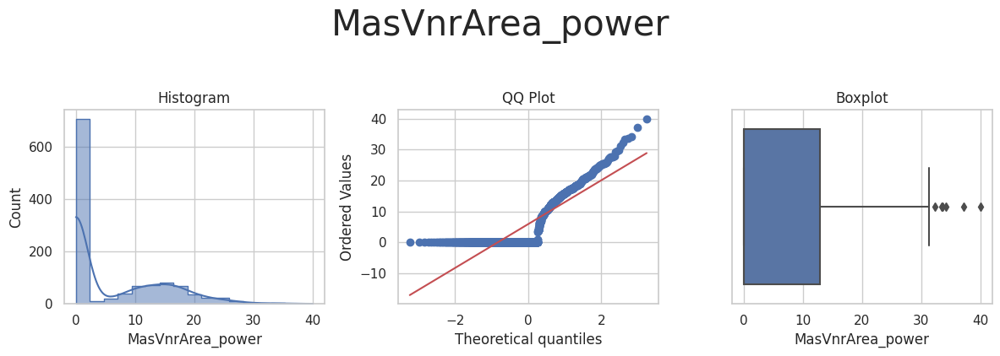

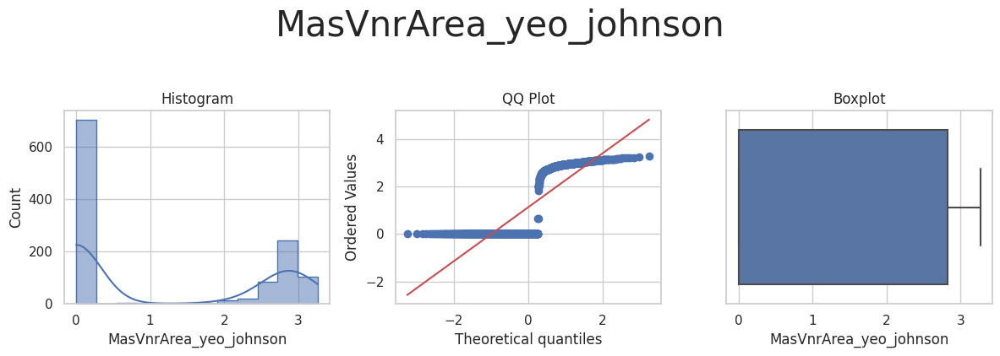



* Variable Analyzed: OpenPorchSF
* Applied transformation: ['OpenPorchSF_power', 'OpenPorchSF_yeo_johnson'] 



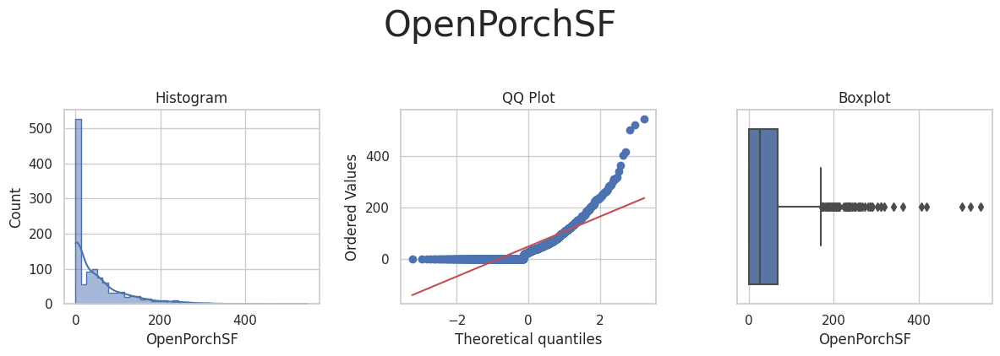

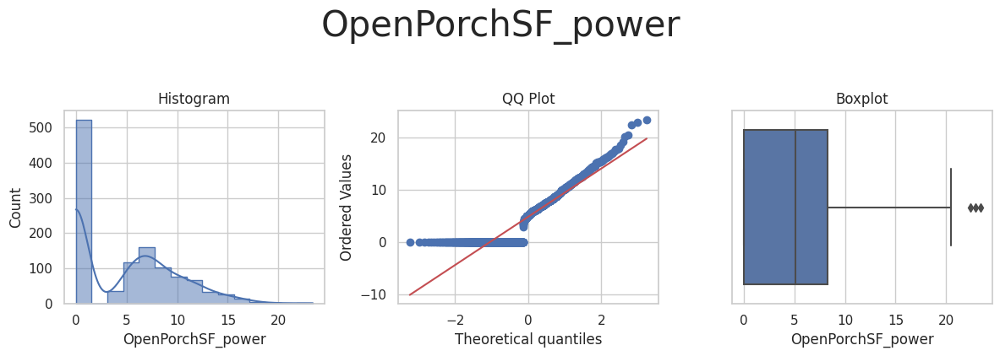

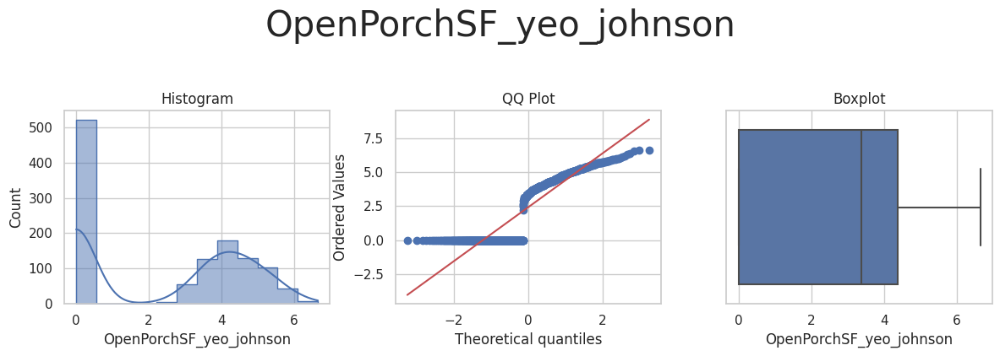



* Variable Analyzed: OverallCond
* Applied transformation: ['OverallCond_log_e', 'OverallCond_log_10', 'OverallCond_reciprocal', 'OverallCond_power', 'OverallCond_box_cox', 'OverallCond_yeo_johnson'] 



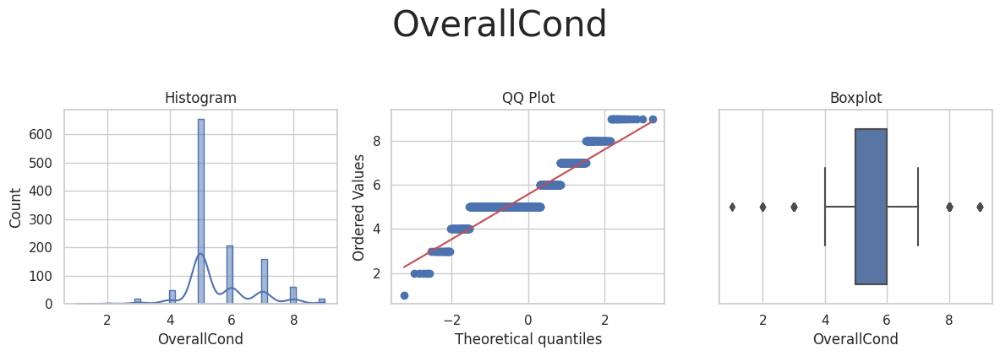

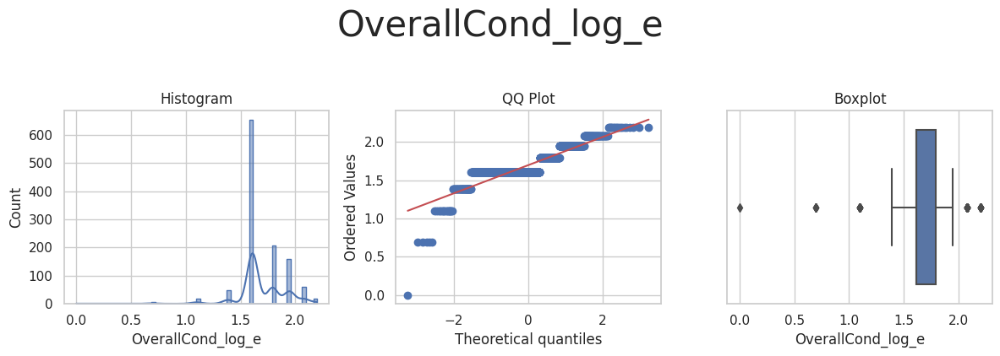

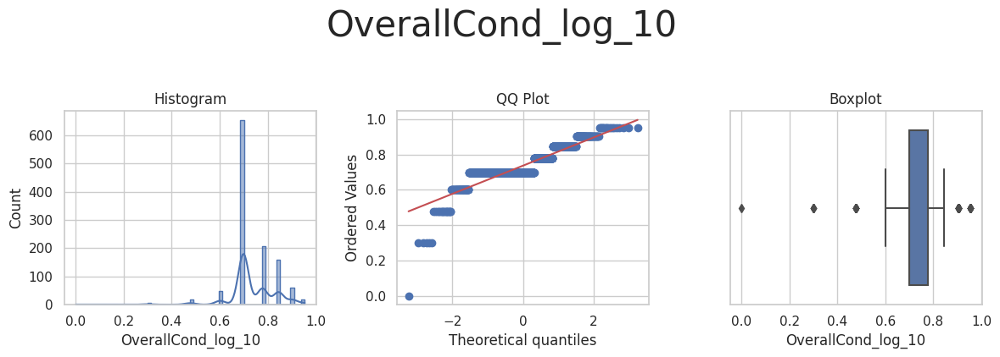

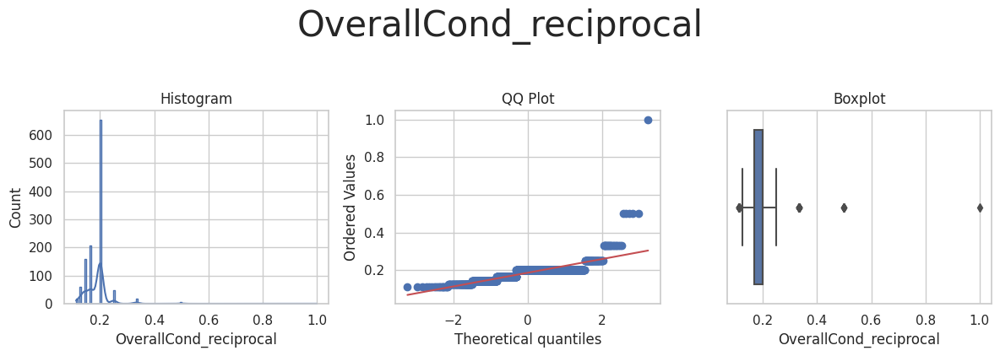

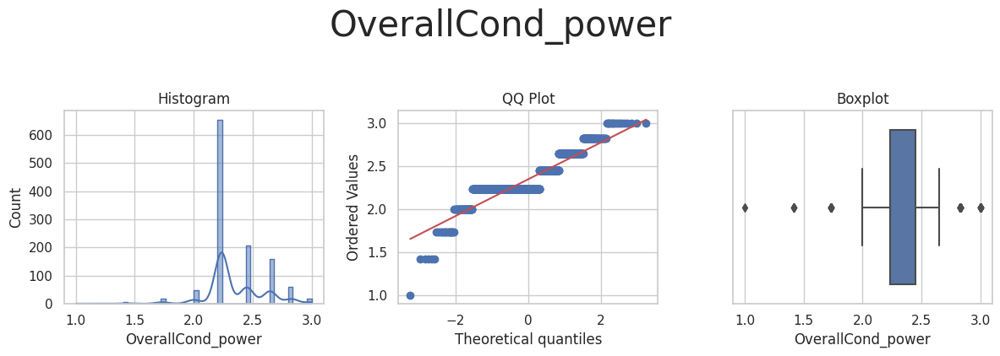

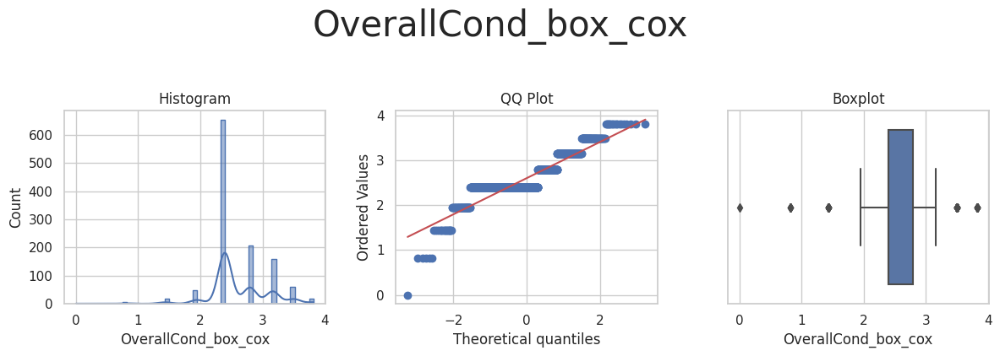

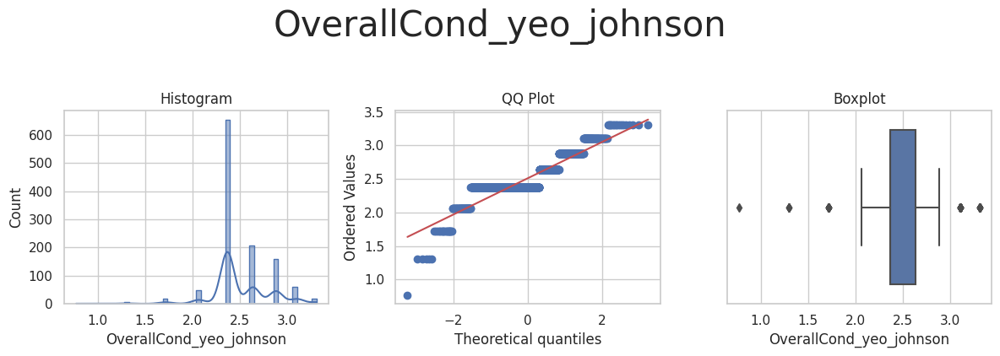



* Variable Analyzed: OverallQual
* Applied transformation: ['OverallQual_log_e', 'OverallQual_log_10', 'OverallQual_reciprocal', 'OverallQual_power', 'OverallQual_box_cox', 'OverallQual_yeo_johnson'] 



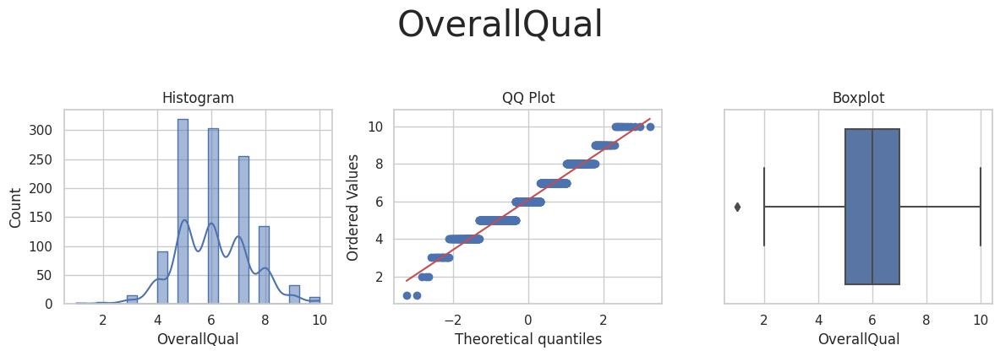

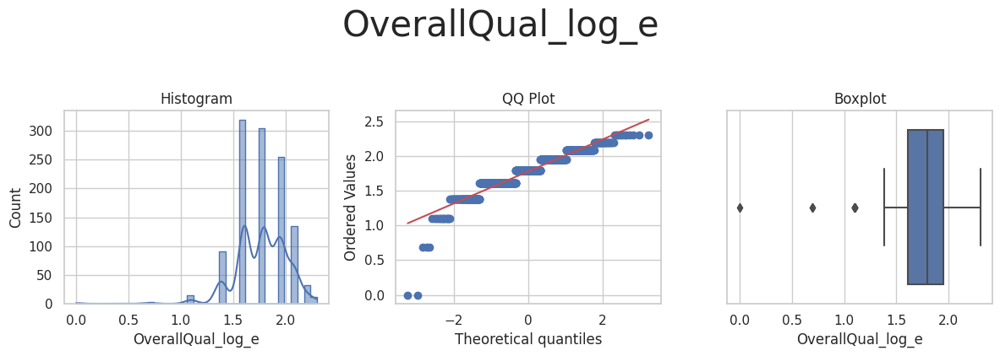

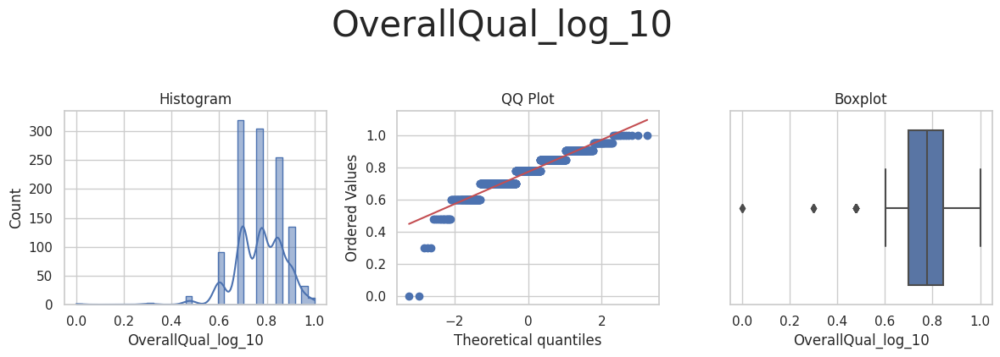

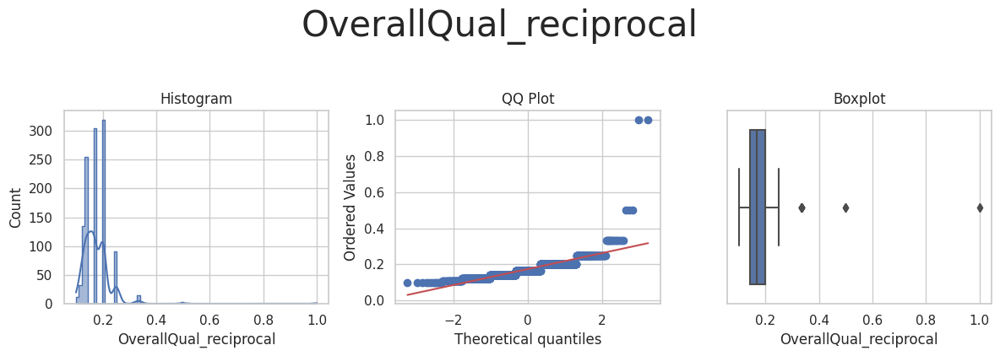

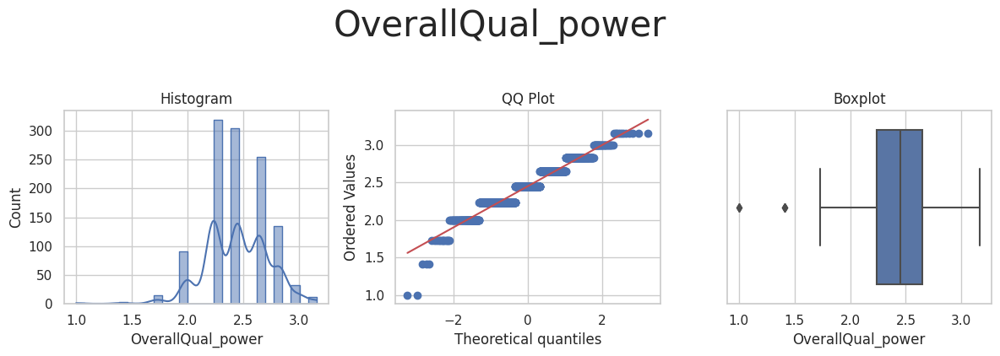

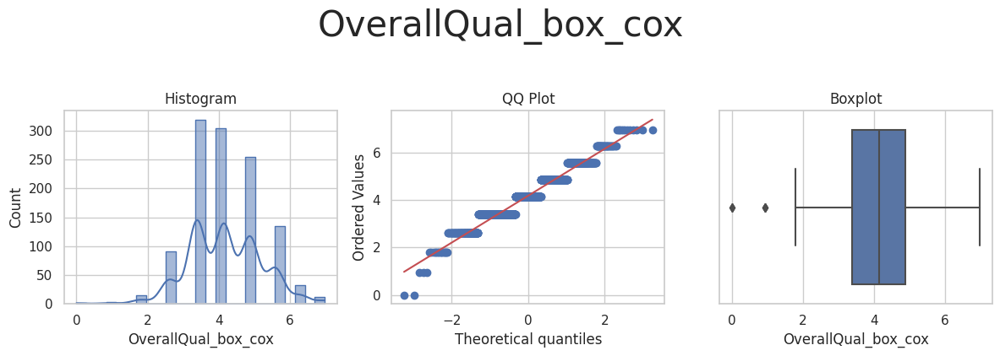

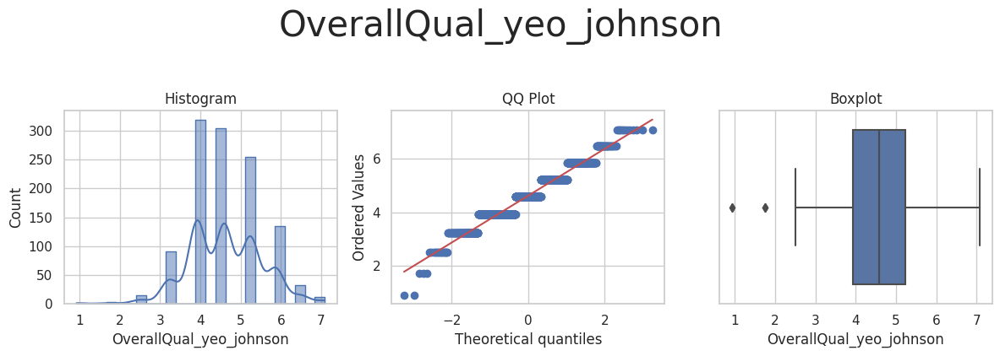



* Variable Analyzed: TotalBsmtSF
* Applied transformation: ['TotalBsmtSF_power', 'TotalBsmtSF_yeo_johnson'] 



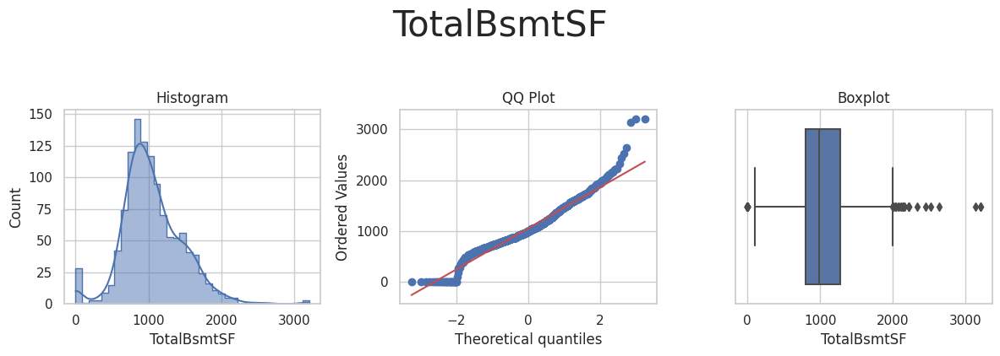

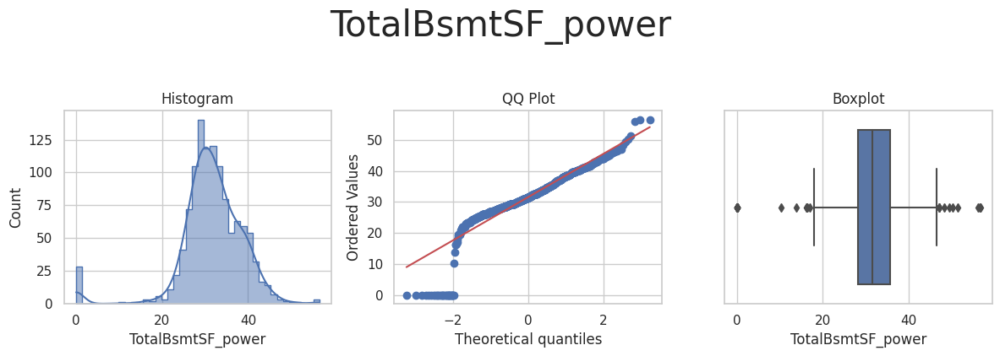

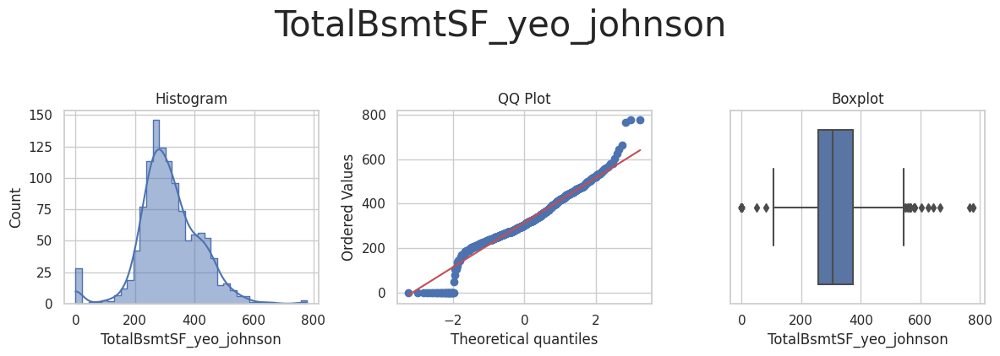



* Variable Analyzed: YearBuilt
* Applied transformation: ['YearBuilt_log_e', 'YearBuilt_log_10', 'YearBuilt_reciprocal', 'YearBuilt_power', 'YearBuilt_box_cox', 'YearBuilt_yeo_johnson'] 



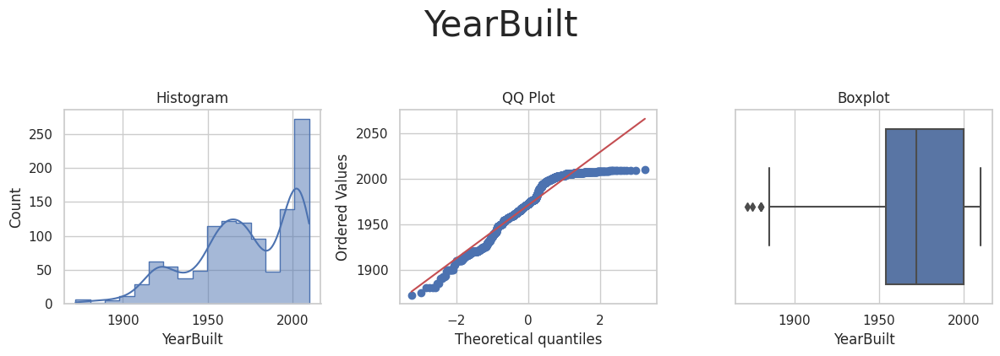

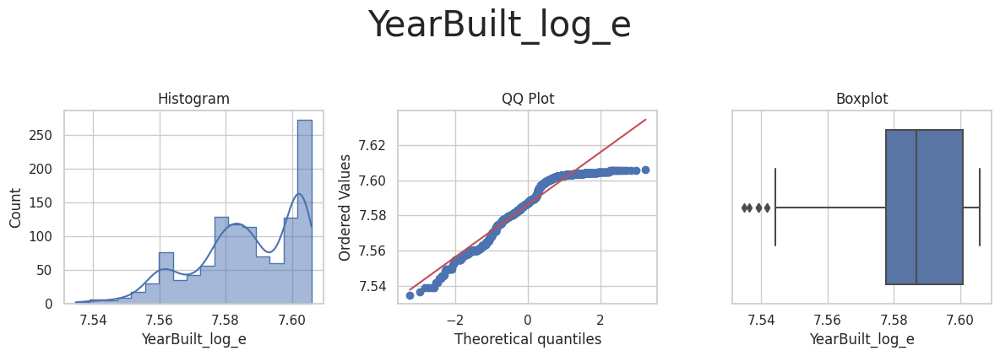

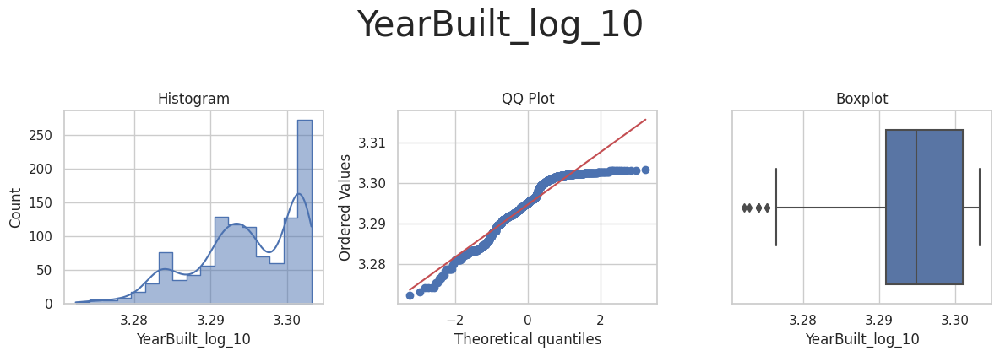

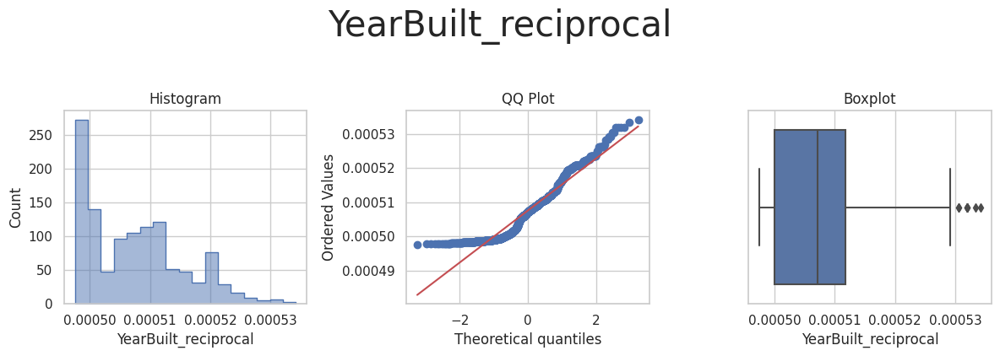

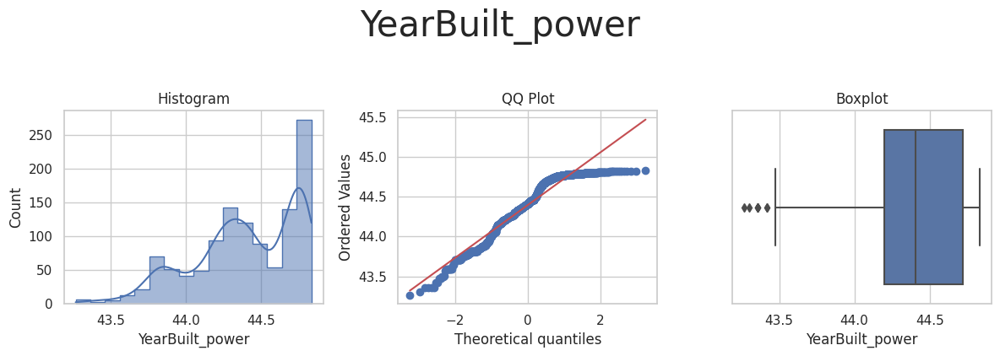

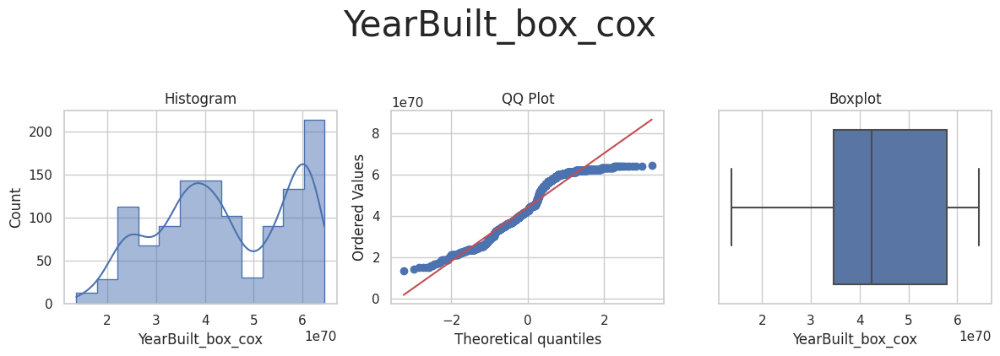

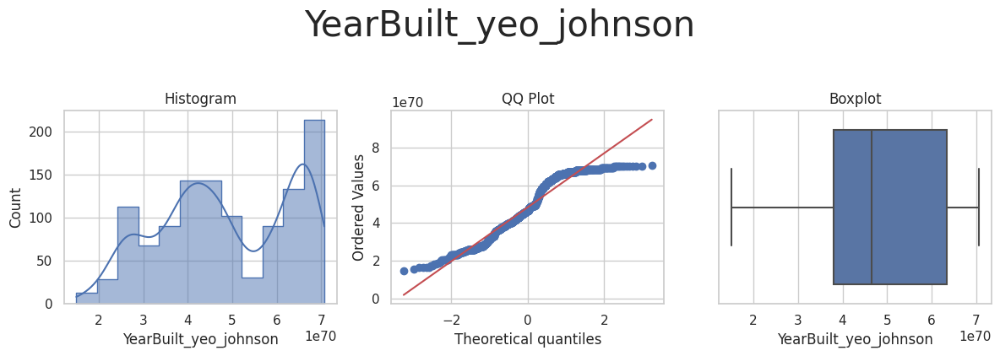



* Variable Analyzed: YearRemodAdd
* Applied transformation: ['YearRemodAdd_log_e', 'YearRemodAdd_log_10', 'YearRemodAdd_reciprocal', 'YearRemodAdd_power', 'YearRemodAdd_box_cox', 'YearRemodAdd_yeo_johnson'] 



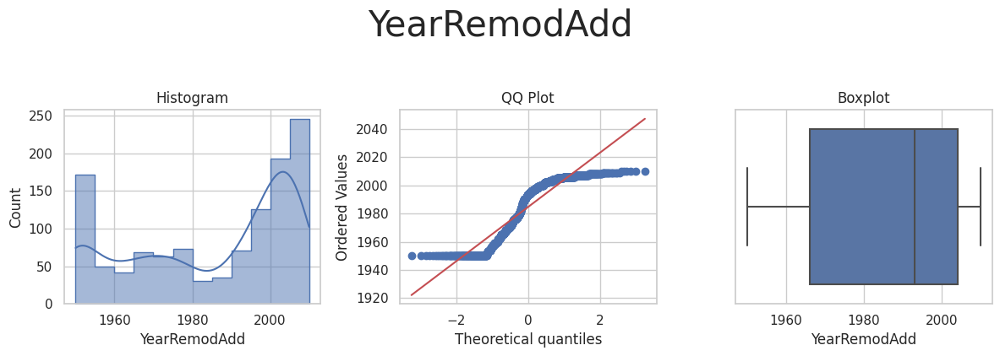

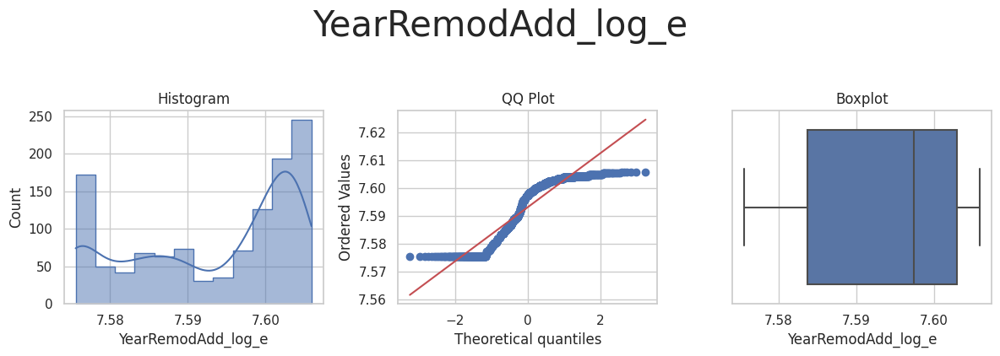

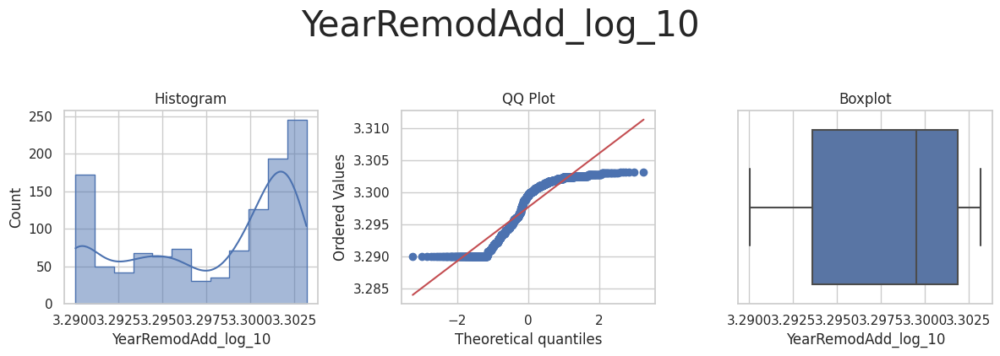

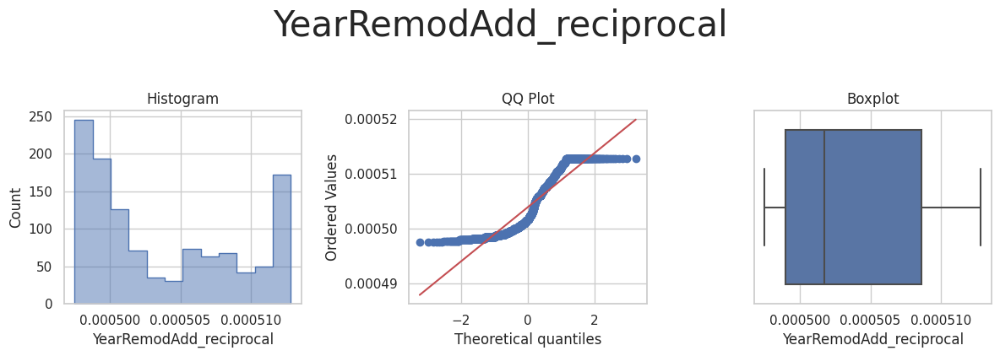

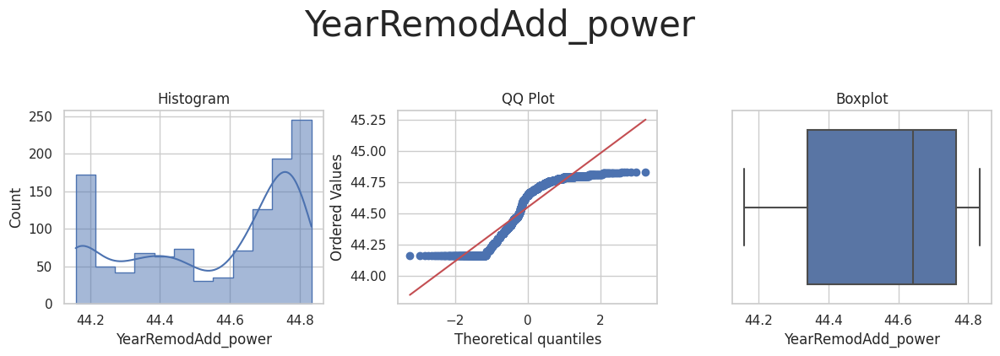

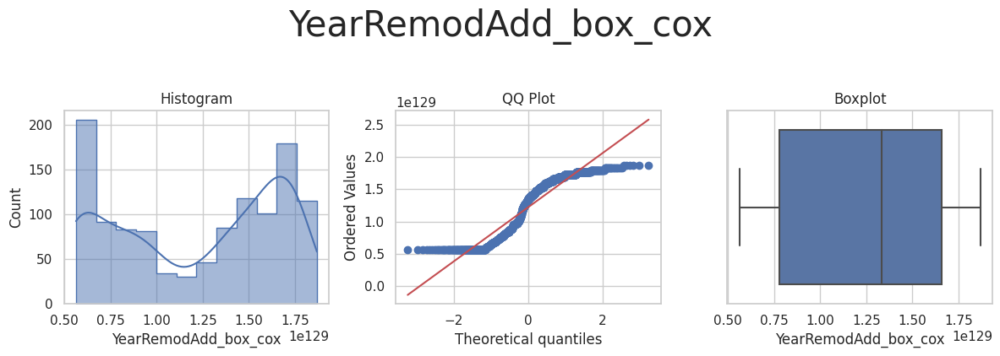

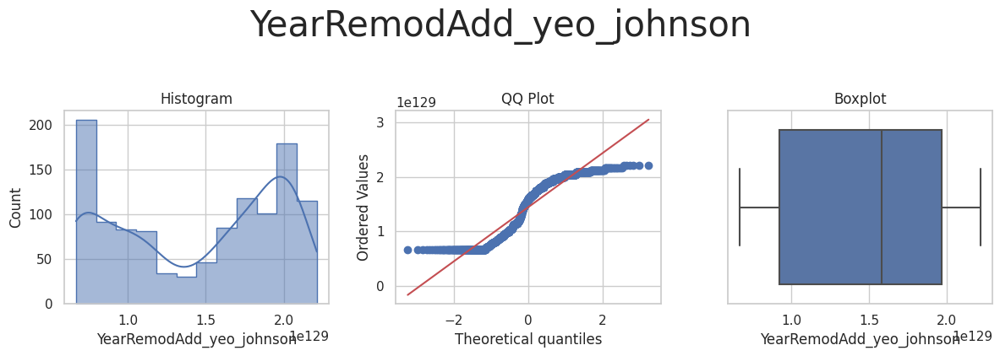

In [17]:
df_method = FeatureEngineeringAnalysis(df=df_method, analysis_type='numerical')

- "X" indicates that applying the corresponding transformation (Power, Log, Box-Cox, or Yeo-Johnson) results in a better distribution for the respective variable. 


| Variable       | Power | Log  | Box-Cox | Yeo-Johnson |
|----------------|-------|------|---------|-------------|
| 1stFlrSF       |   B   |  X   |    X    |      X      |
| 2ndFlrSF       |   X   |  -   |    -    |      X      |
| BedroomAbvGr   |   -   |  -   |    -    |      -      |
| BsmtExposure   |   -   |  -   |    -    |      -      |
| BsmtFinSF1     |   X   |  -   |    -    |      -      |
| BsmtFinType1   |   -   |  -   |    -    |      -      |
| BsmtUnfSF      |   X   |  -   |    B    |      X      |
| GarageArea     |   X   |      |    B    |      X      |
| GarageFinish   |   -   |  -   |    -    |      -      |
| GarageYrBlt    |   -   |  -   |    -    |      -      |
| Gr ivArBa      |   B   |  X   |    X    |      X      |
| KitchenQual    |   -   |  -   |    -    |      -      |
| LotArea        |   B   |  X   |    X    |      X      |
| LotFrontage    |   X   |  X   |    X    |      X      |
| MasVnrArea     |   X   |  -   |    -    |      -      |
| OpenPorchSF    |   -   |  -   |    -    |      X      |
| OverallCond    |   -   |  -   |    -    |      -      |
| OverallQual    |   -   |  -   |    -    |      -      |
|BTotalBsmtSF    |   X   |   X  |    -    |      -      |
| YearBuilt      |   -   |  -   |    -    |      -      |
| YearRemodAdd   |   -   |  -   |    -    |      -      |


## Transformations
- log transformation

In [18]:
encoder = vt.LogTransformer(variables = [
    '1stFlrSF', 
    'GrLivArea', 
    'LotArea', 
    'LotFrontage', ])
TrainSet = encoder.fit_transform(TrainSet)
TestSet = encoder.transform(TestSet)


- Power

In [19]:
encoder = vt.PowerTransformer(variables = [
    '2ndFlrSF', 
    'BsmtFinSF1', 
    'BsmtUnfSF', 
    'GarageArea', 
    'GrLivArea', 
    'MasVnrArea',
    'TotalBsmtSF', ])
TrainSet = encoder.fit_transform(TrainSet)
TestSet = encoder.transform(TestSet)


- Yeo-Johnson transformation

In [20]:
encoder = vt.YeoJohnsonTransformer(variables = [
    '1stFlrSF', 
    'BsmtUnfSF', 
    'GarageArea', 
    'GrLivArea', 
    'LotArea', 
    'LotFrontage',
    'OpenPorchSF', ])
TrainSet = encoder.fit_transform(TrainSet)
TestSet = encoder.transform(TestSet)


## outliers assemement

In [21]:
outliers = TrainSet.copy()
outliers.head(3)

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd,SalePrice
0,7.850302,0.0,3.0,0,6.928203,0,40.321472,170.336793,0,2007.0,...,15.452051,193.293763,21.260292,4.880037,5,9,42.684892,2007,2007,314813
1,7.087163,0.0,2.0,1,0.000000,0,28.758891,80.764330,0,1962.0,...,14.293967,143.485567,0.000000,0.000000,5,5,29.899833,1962,1962,109500
2,7.167495,0.0,2.0,1,26.702060,1,12.415424,106.069606,0,1921.0,...,15.724559,177.681408,0.000000,0.000000,7,5,29.597297,1921,2006,163500


* Variable Analyzed: 1stFlrSF
* Applied transformation: ['1stFlrSF_iqr'] 



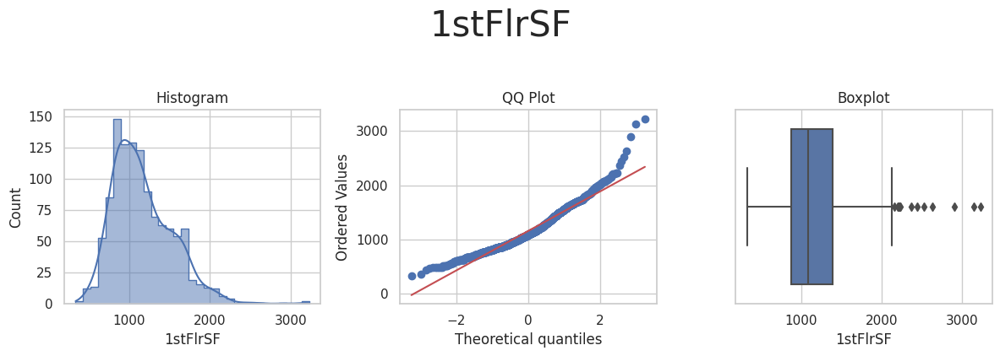

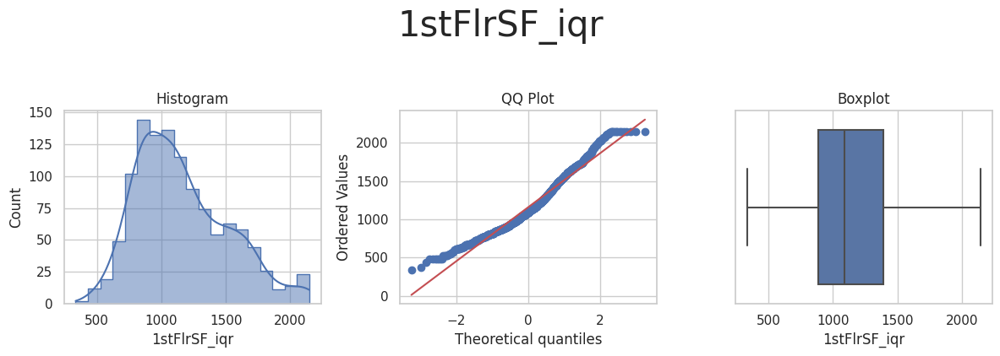



* Variable Analyzed: 1stFlrSF_log_e
* Applied transformation: ['1stFlrSF_log_e_iqr'] 



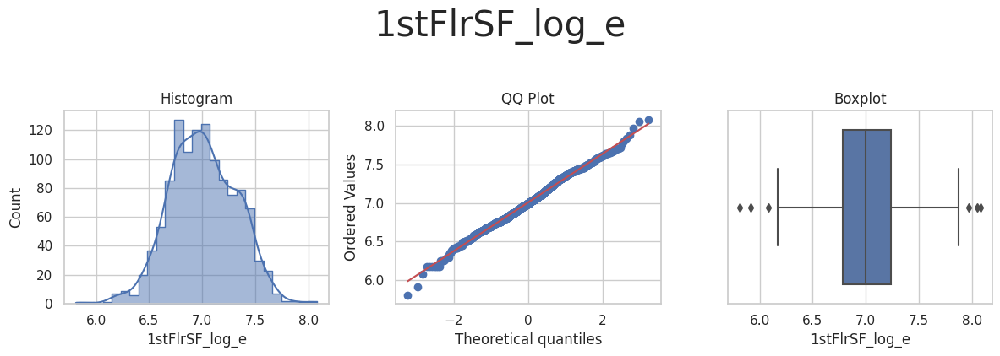

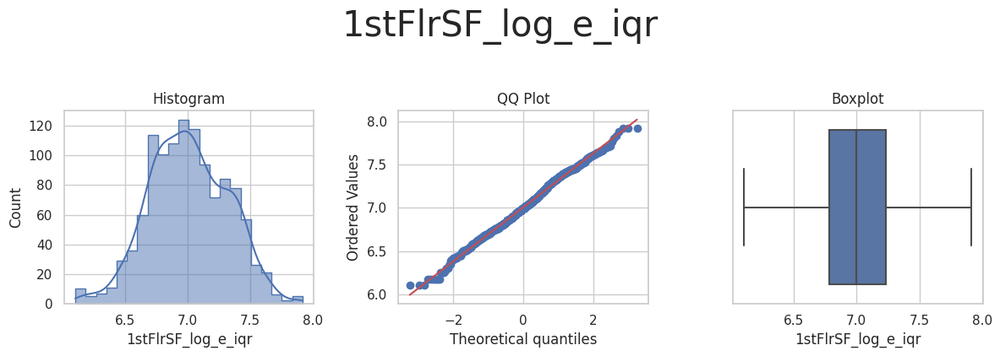



* Variable Analyzed: 1stFlrSF_log_10
* Applied transformation: ['1stFlrSF_log_10_iqr'] 



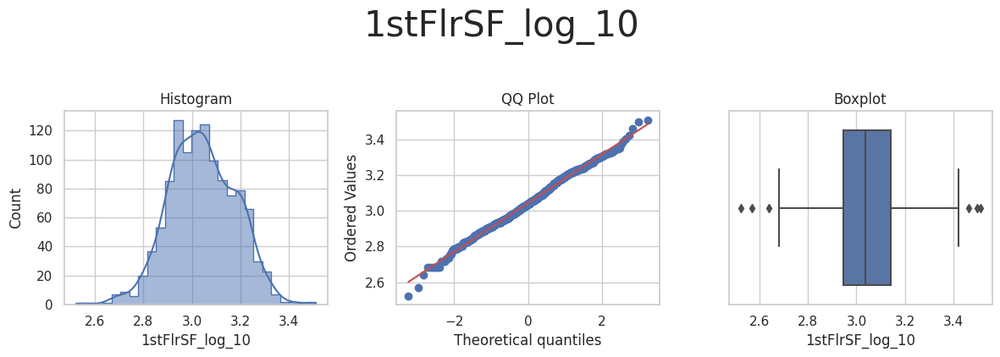

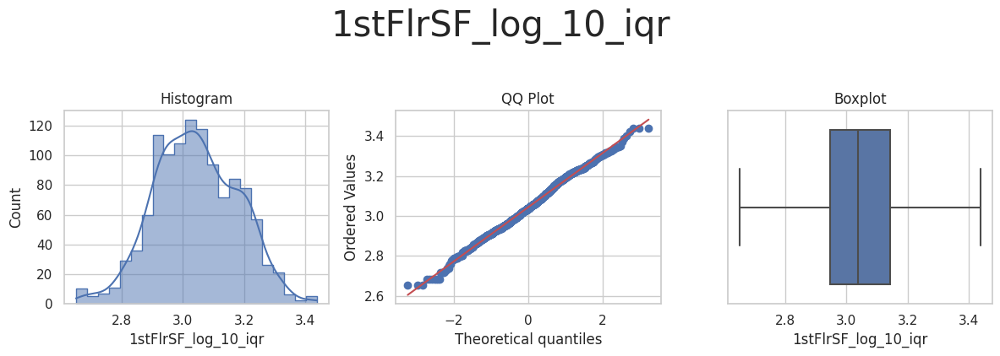



* Variable Analyzed: 1stFlrSF_reciprocal
* Applied transformation: ['1stFlrSF_reciprocal_iqr'] 



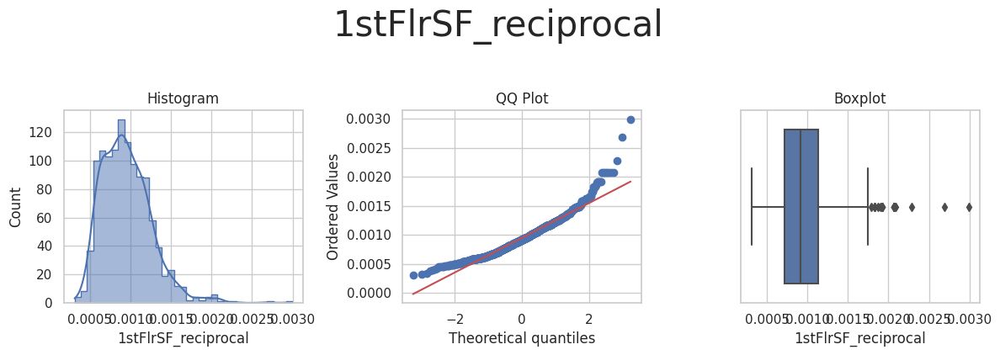

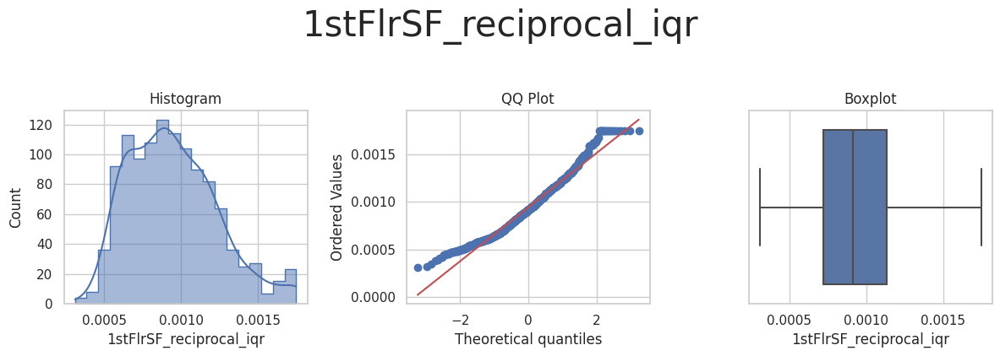



* Variable Analyzed: 1stFlrSF_power
* Applied transformation: ['1stFlrSF_power_iqr'] 



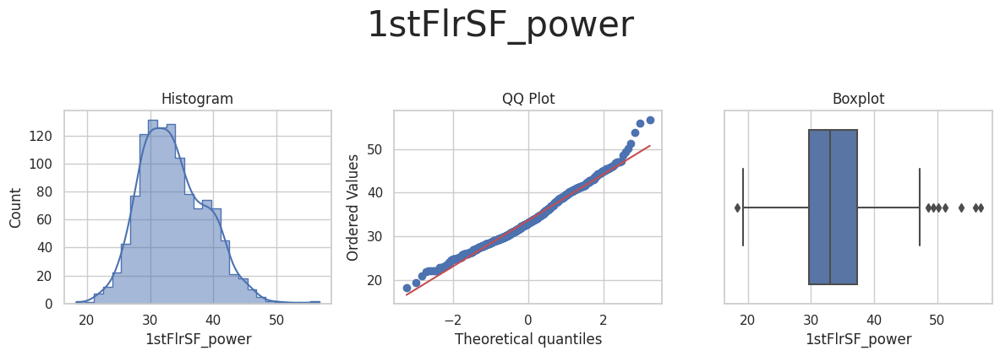

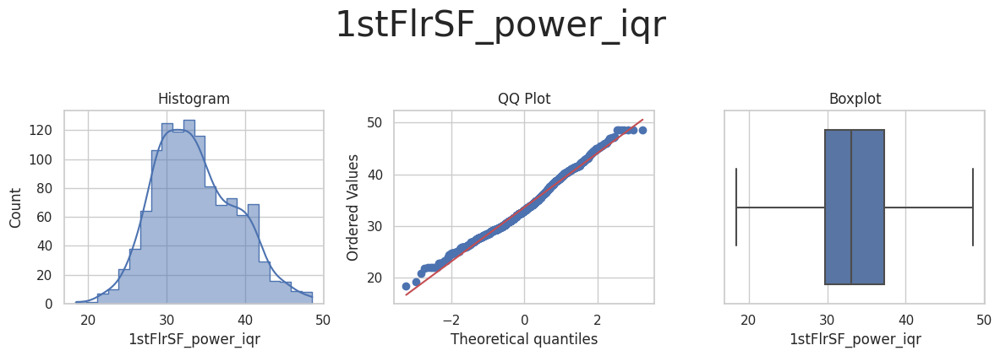



* Variable Analyzed: 1stFlrSF_box_cox
* Applied transformation: ['1stFlrSF_box_cox_iqr'] 



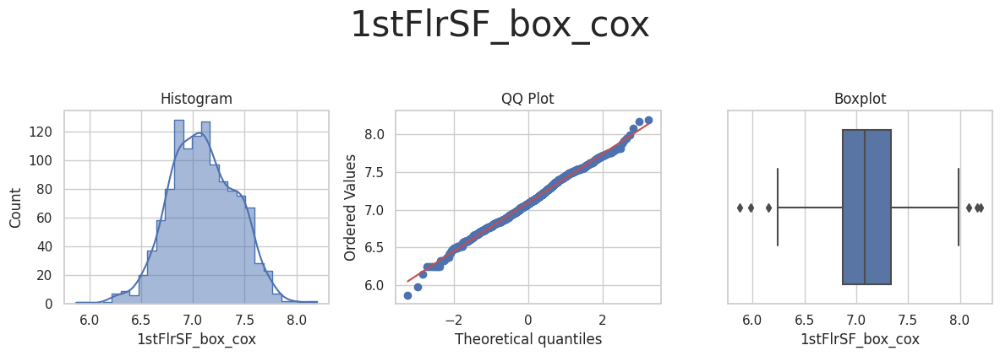

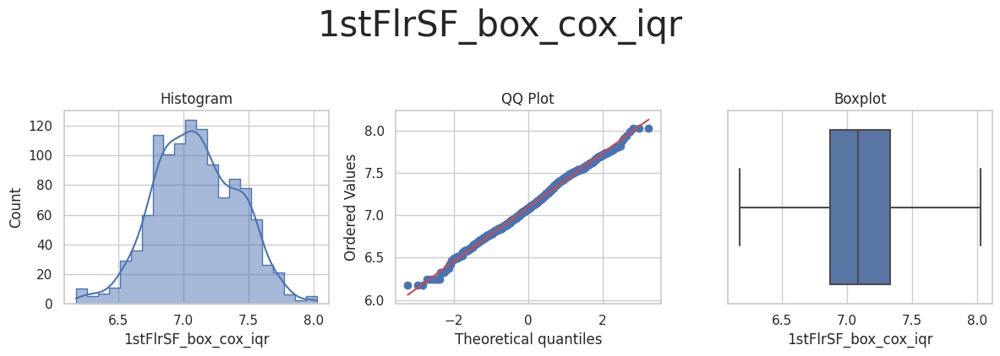



* Variable Analyzed: 1stFlrSF_yeo_johnson
* Applied transformation: ['1stFlrSF_yeo_johnson_iqr'] 



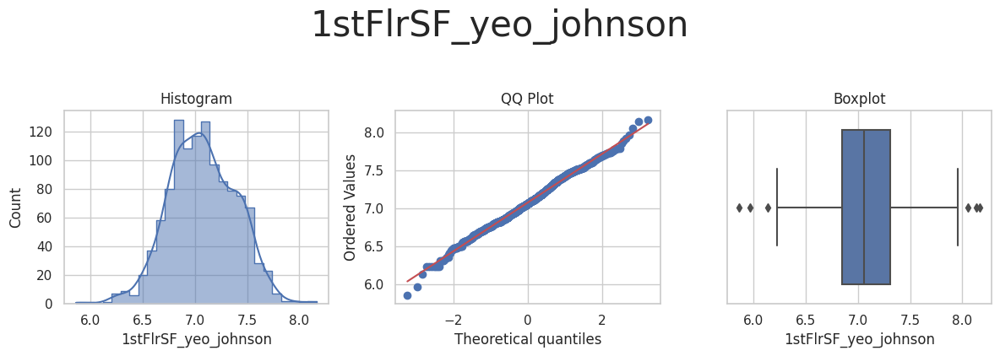

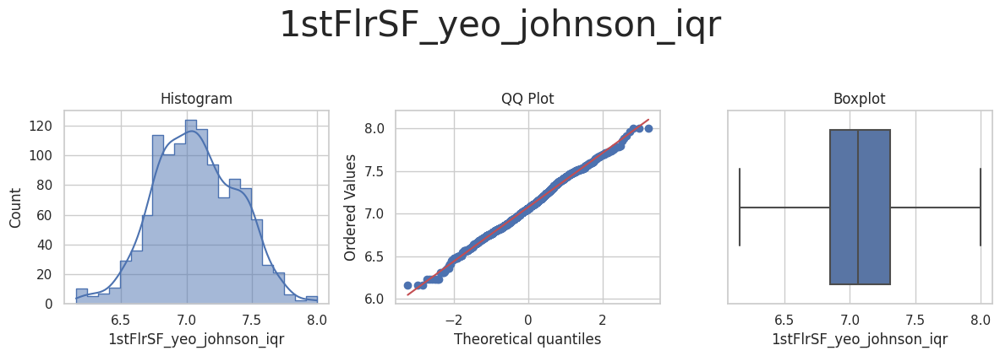



* Variable Analyzed: 2ndFlrSF
* Applied transformation: ['2ndFlrSF_iqr'] 



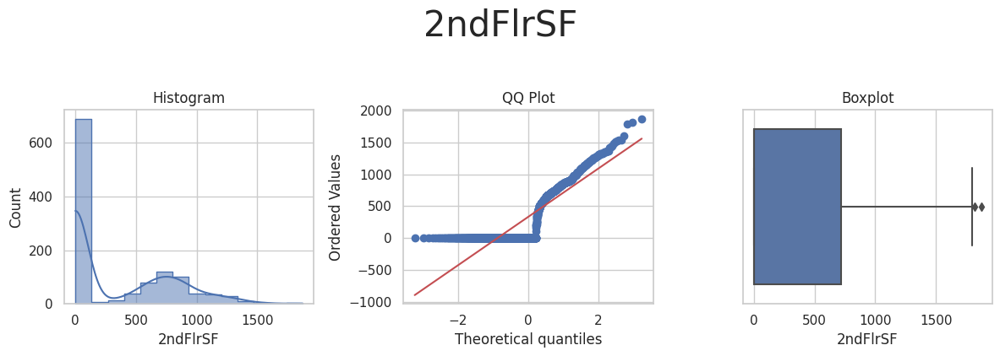

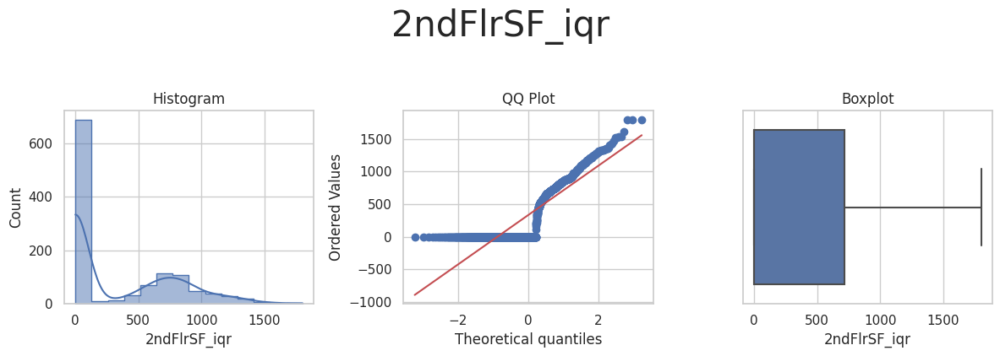



* Variable Analyzed: 2ndFlrSF_power
* Applied transformation: ['2ndFlrSF_power_iqr'] 



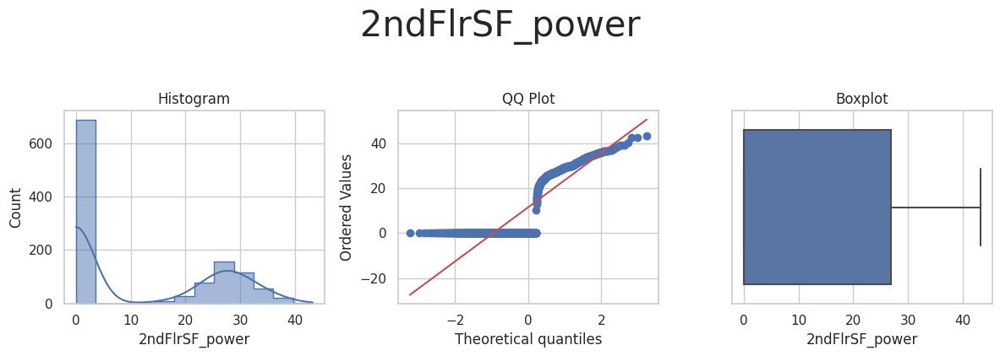

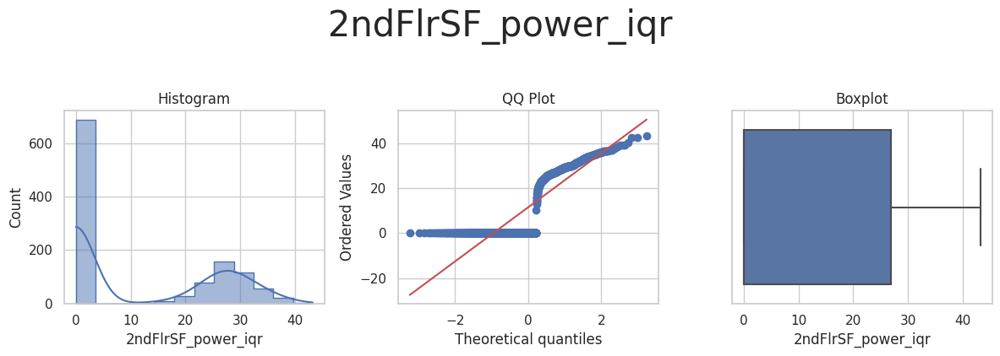



* Variable Analyzed: 2ndFlrSF_yeo_johnson
* Applied transformation: ['2ndFlrSF_yeo_johnson_iqr'] 



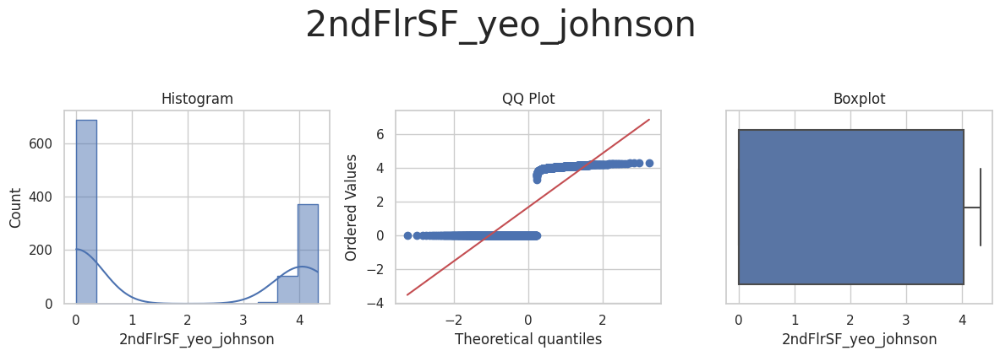

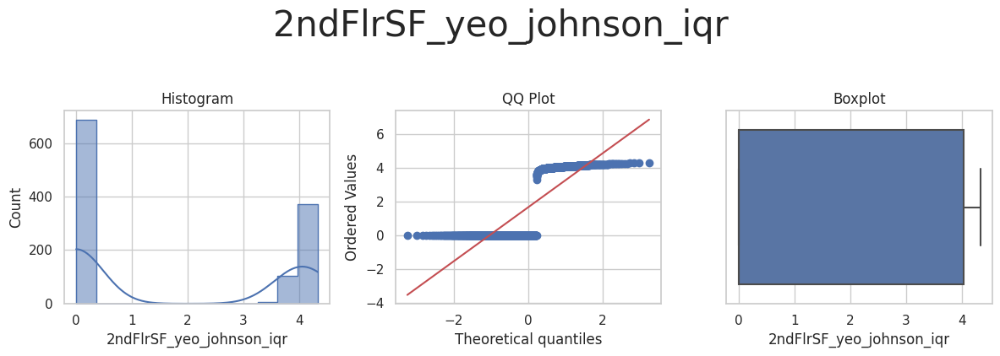



* Variable Analyzed: BedroomAbvGr
* Applied transformation: ['BedroomAbvGr_iqr'] 



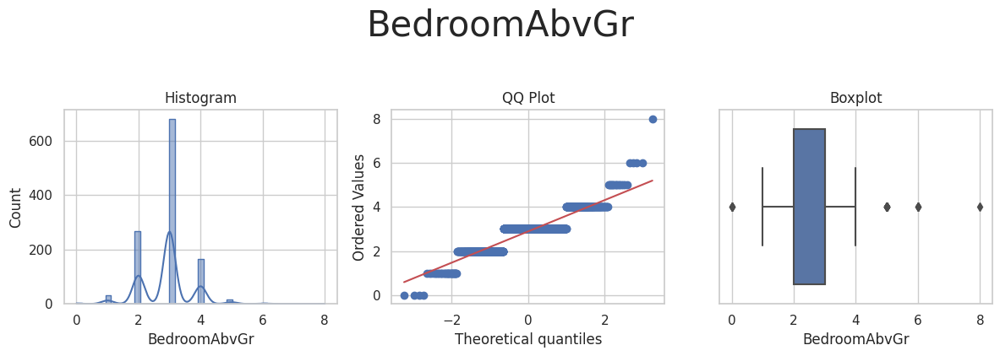

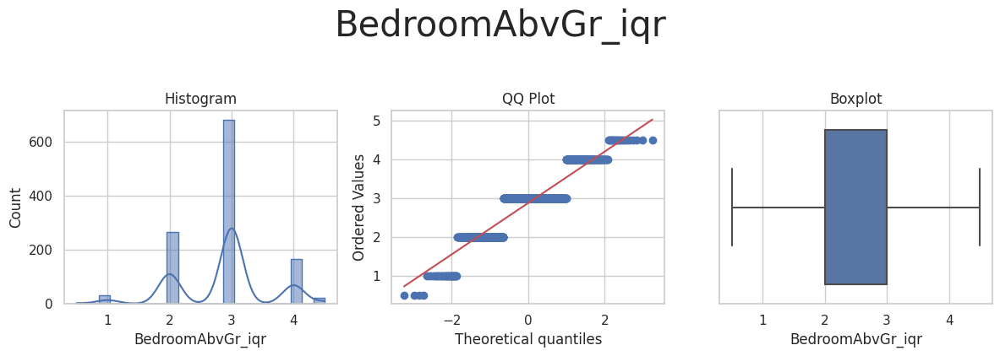



* Variable Analyzed: BedroomAbvGr_power
* Applied transformation: ['BedroomAbvGr_power_iqr'] 



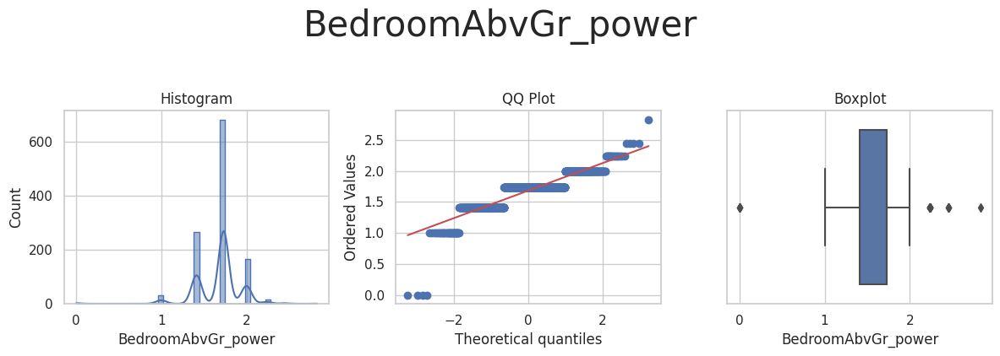

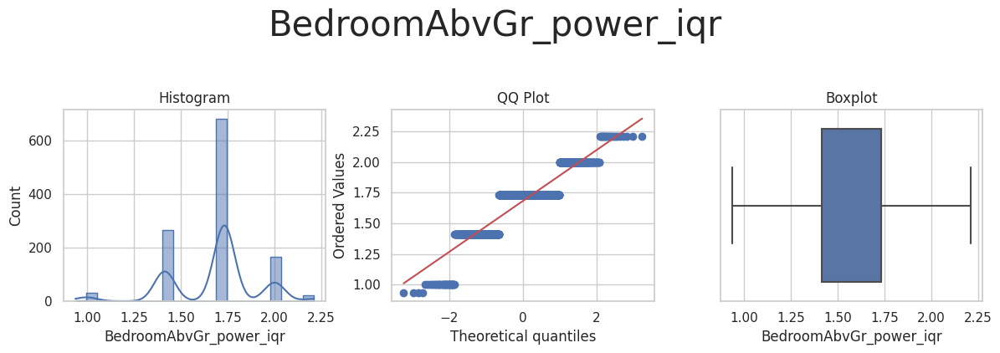



* Variable Analyzed: BedroomAbvGr_yeo_johnson
* Applied transformation: ['BedroomAbvGr_yeo_johnson_iqr'] 



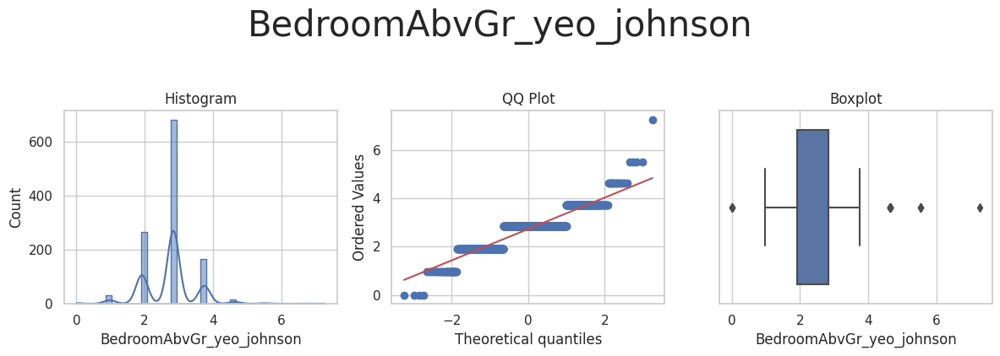

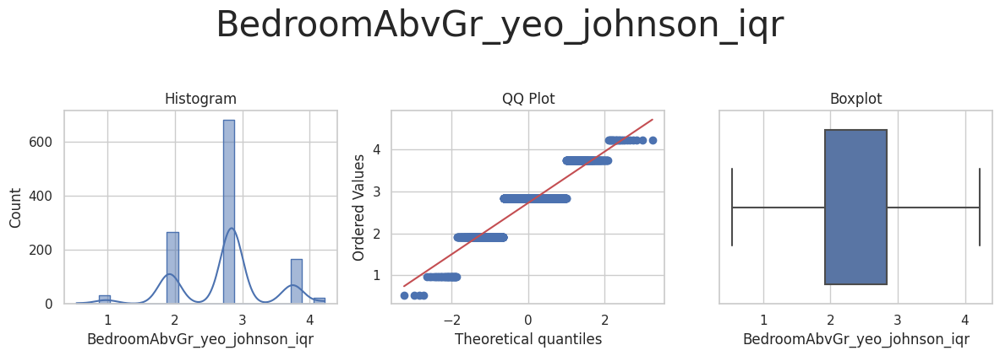



* Variable Analyzed: BsmtExposure
* Applied transformation: ['BsmtExposure_iqr'] 



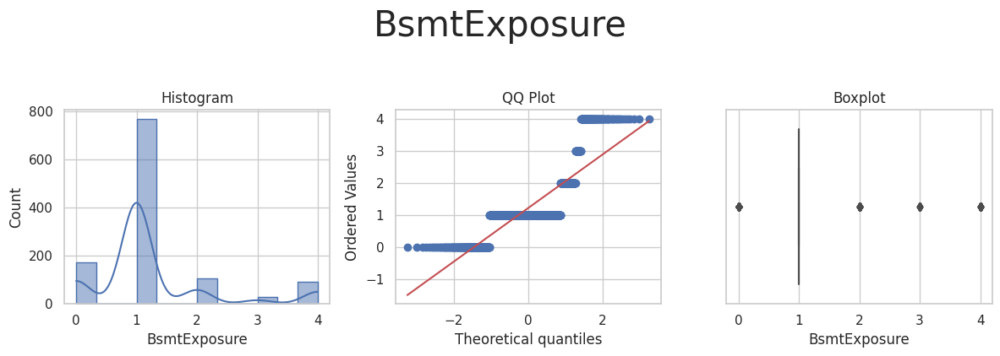

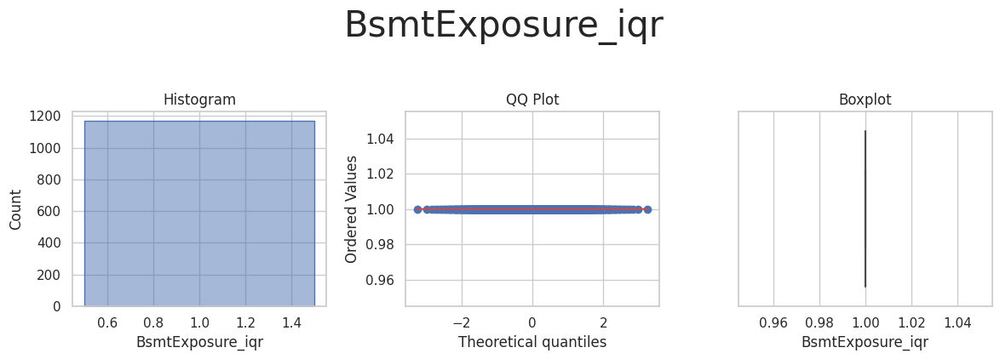



* Variable Analyzed: BsmtExposure_power
* Applied transformation: ['BsmtExposure_power_iqr'] 



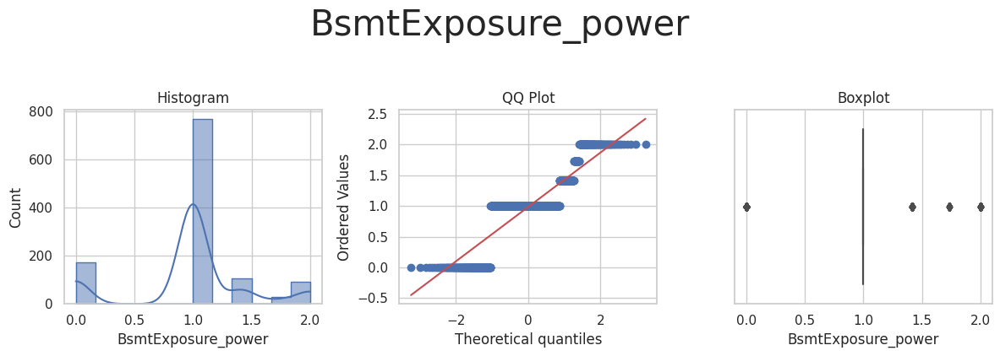

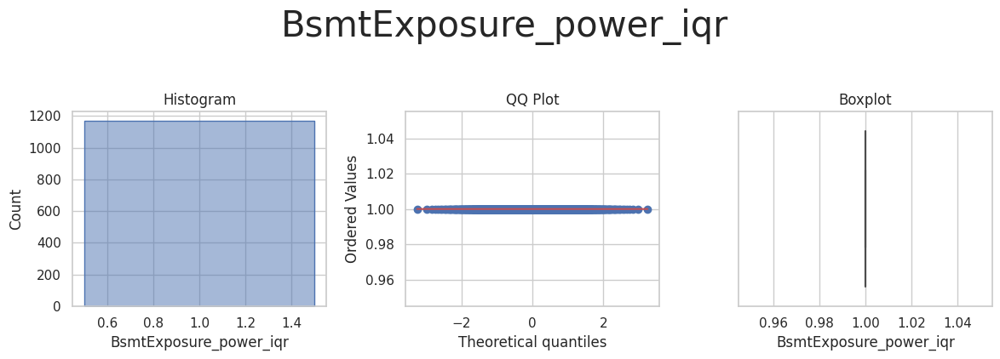



* Variable Analyzed: BsmtExposure_yeo_johnson
* Applied transformation: ['BsmtExposure_yeo_johnson_iqr'] 



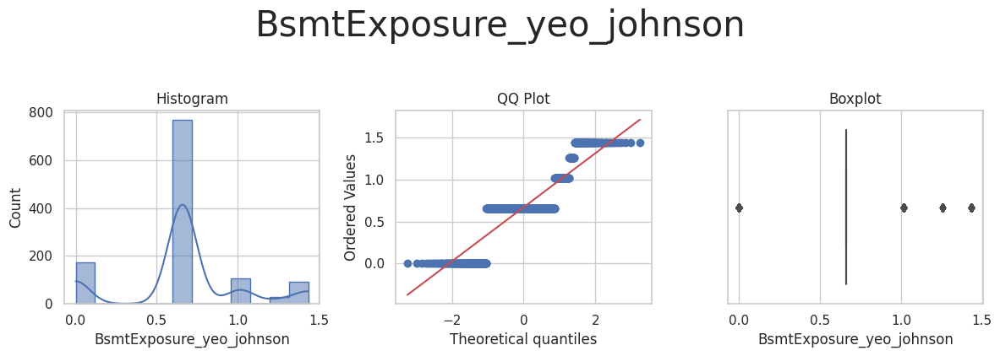

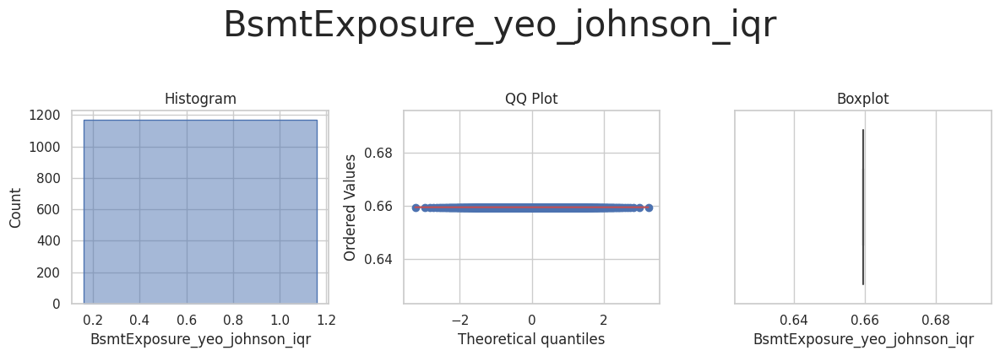



* Variable Analyzed: BsmtFinSF1
* Applied transformation: ['BsmtFinSF1_iqr'] 



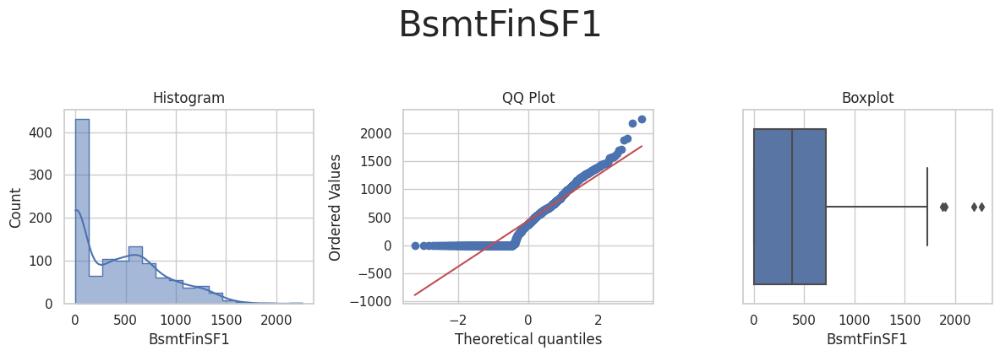

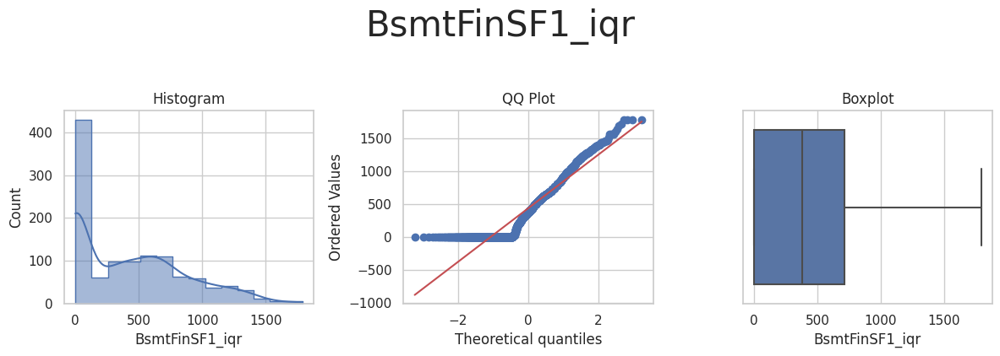



* Variable Analyzed: BsmtFinSF1_power
* Applied transformation: ['BsmtFinSF1_power_iqr'] 



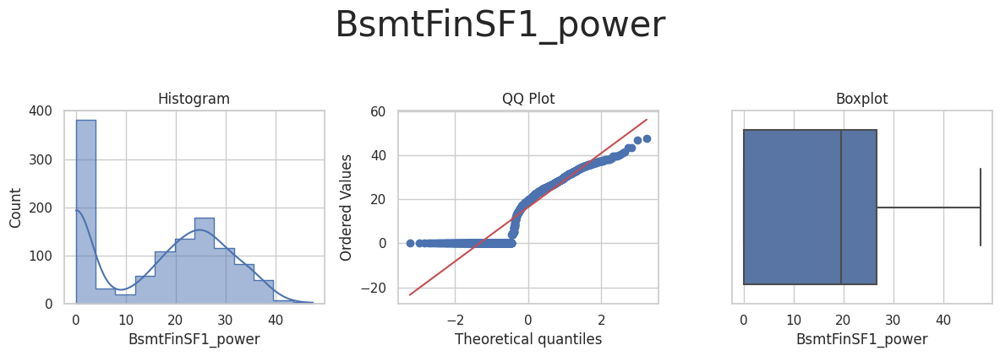

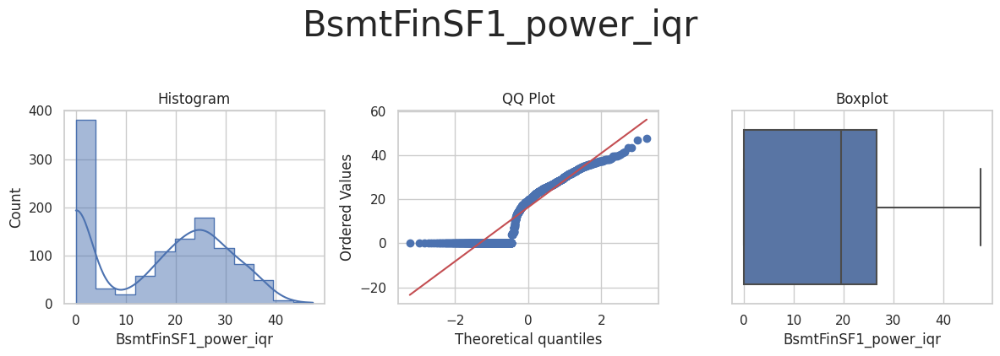



* Variable Analyzed: BsmtFinSF1_yeo_johnson
* Applied transformation: ['BsmtFinSF1_yeo_johnson_iqr'] 



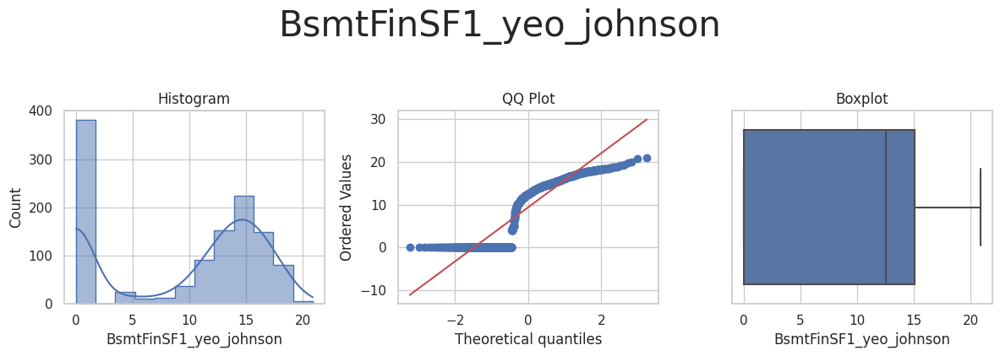

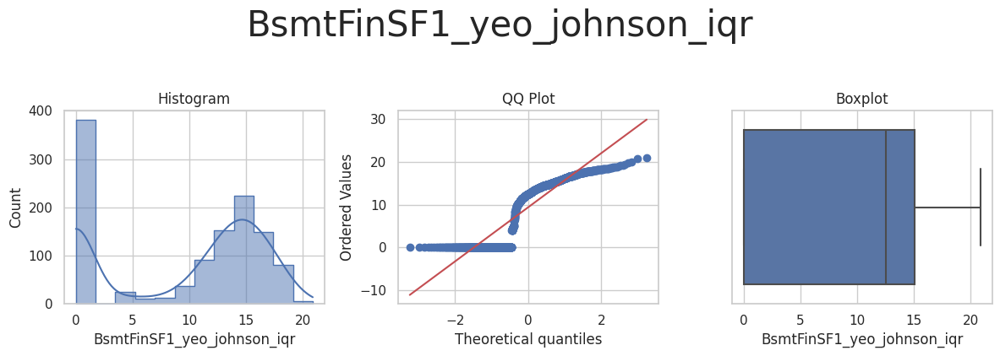



* Variable Analyzed: BsmtFinType1
* Applied transformation: ['BsmtFinType1_iqr'] 



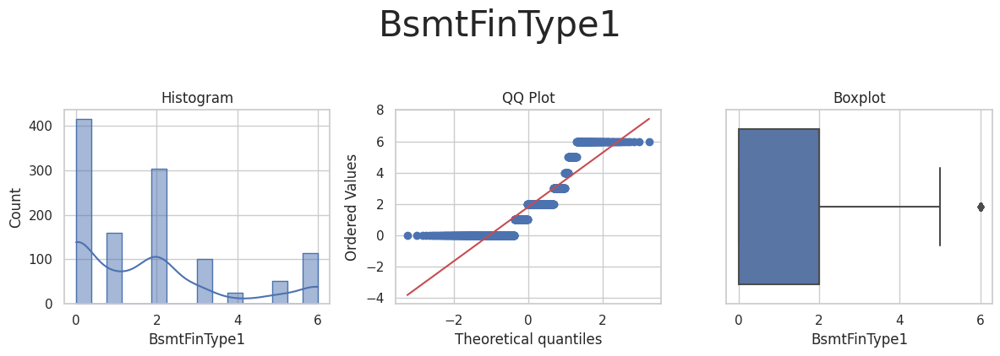

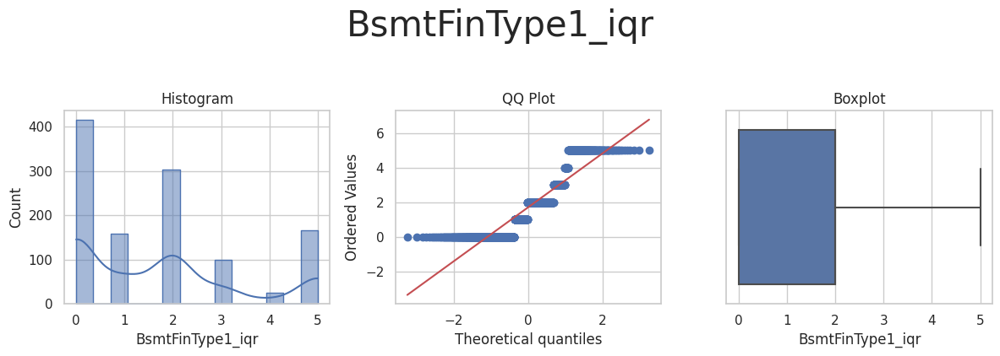



* Variable Analyzed: BsmtFinType1_power
* Applied transformation: ['BsmtFinType1_power_iqr'] 



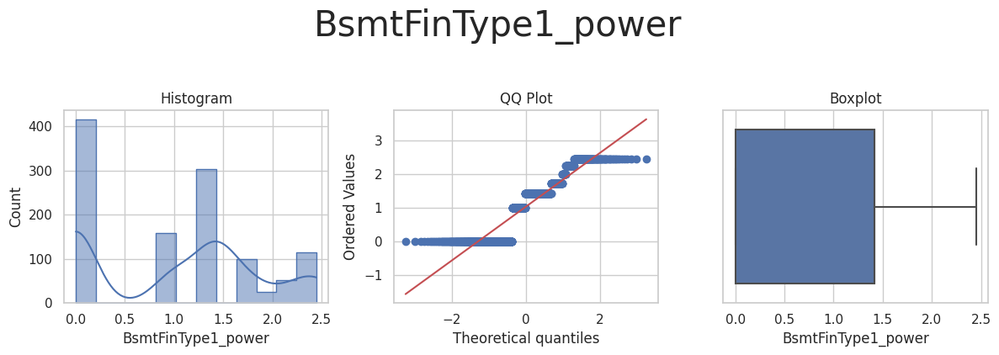

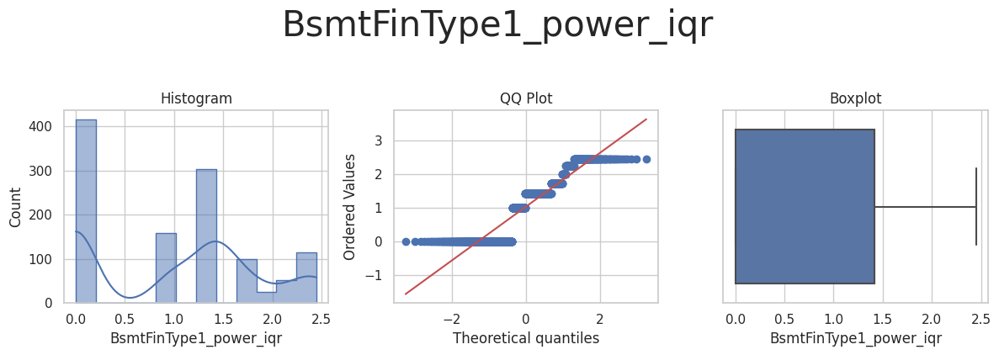



* Variable Analyzed: BsmtFinType1_yeo_johnson
* Applied transformation: ['BsmtFinType1_yeo_johnson_iqr'] 



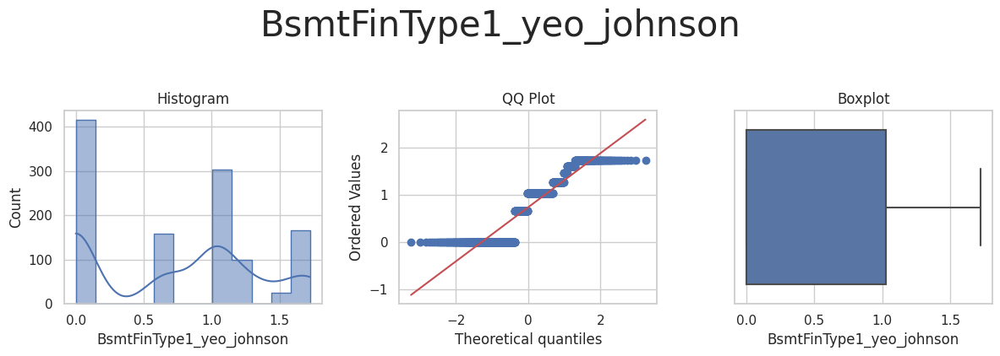

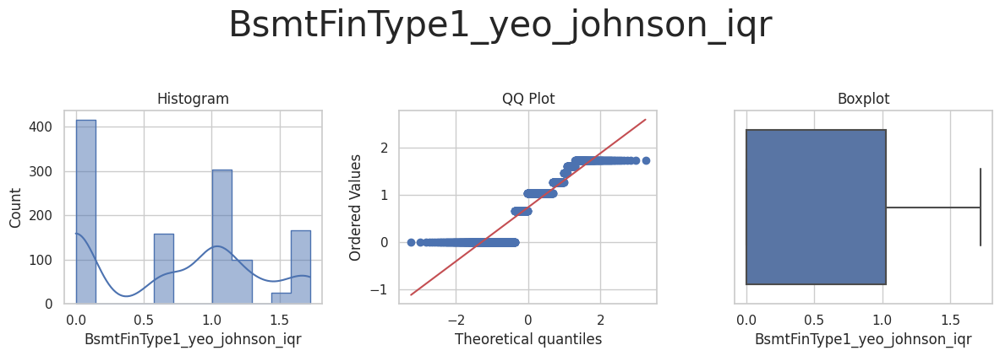



* Variable Analyzed: BsmtUnfSF
* Applied transformation: ['BsmtUnfSF_iqr'] 



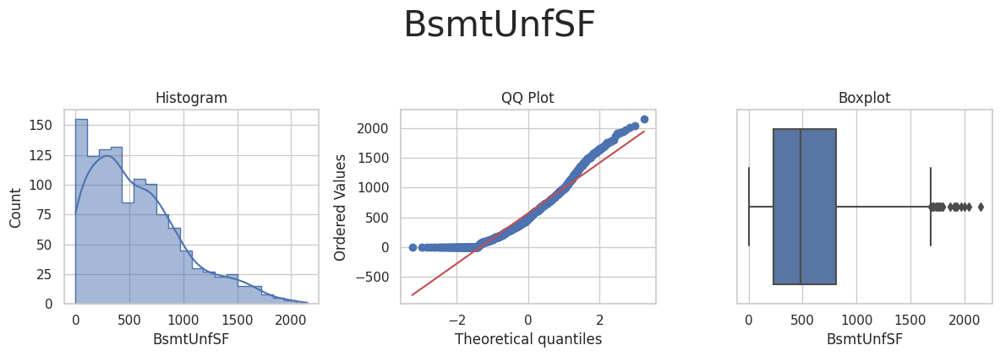

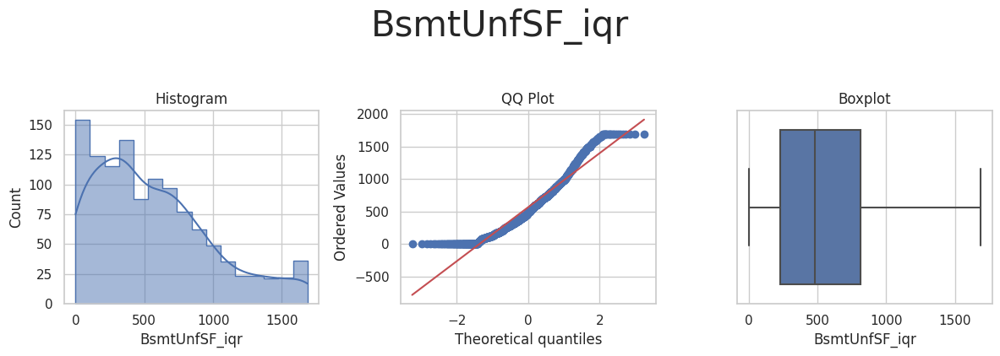



* Variable Analyzed: BsmtUnfSF_power
* Applied transformation: ['BsmtUnfSF_power_iqr'] 



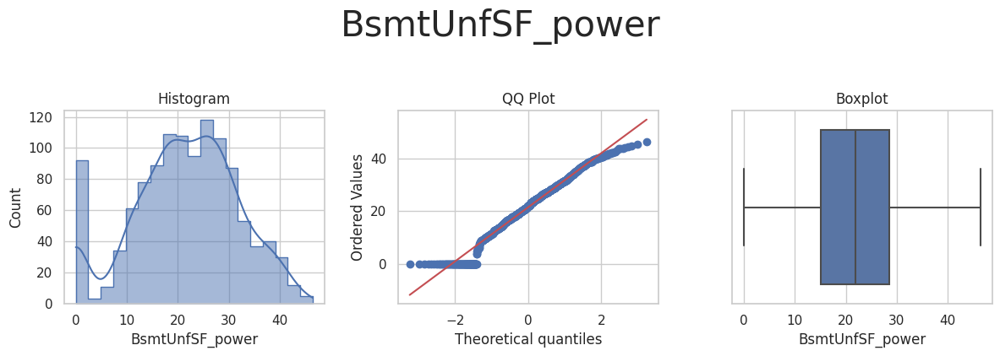

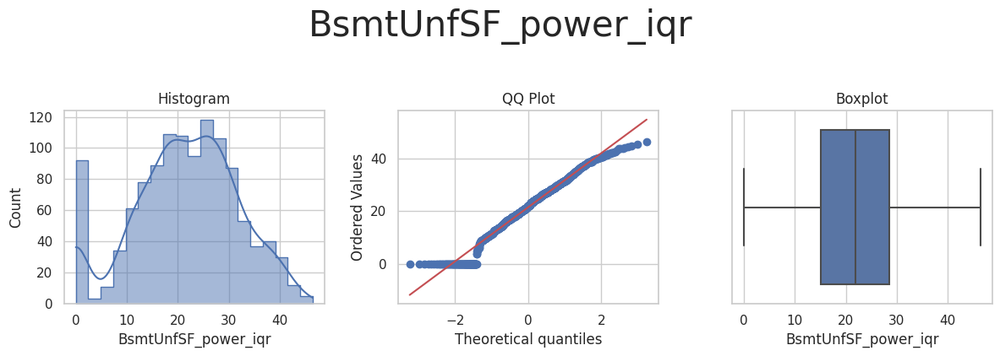



* Variable Analyzed: BsmtUnfSF_yeo_johnson
* Applied transformation: ['BsmtUnfSF_yeo_johnson_iqr'] 



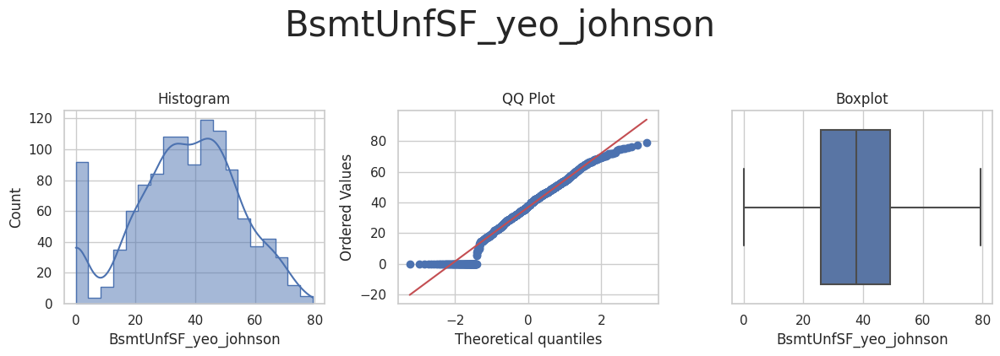

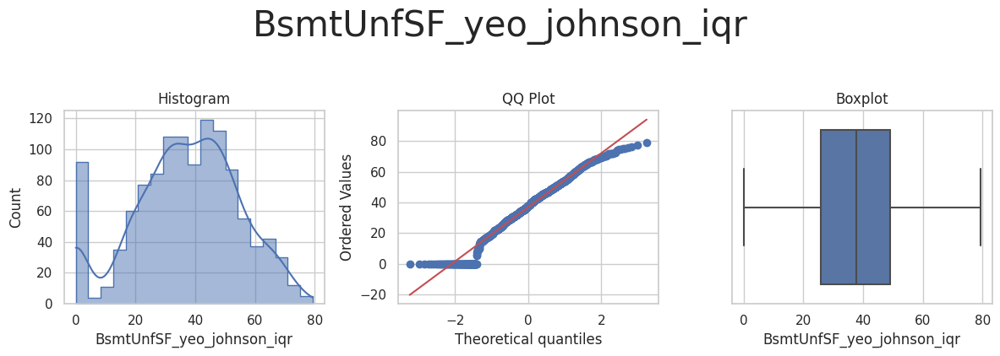



* Variable Analyzed: GarageArea
* Applied transformation: ['GarageArea_iqr'] 



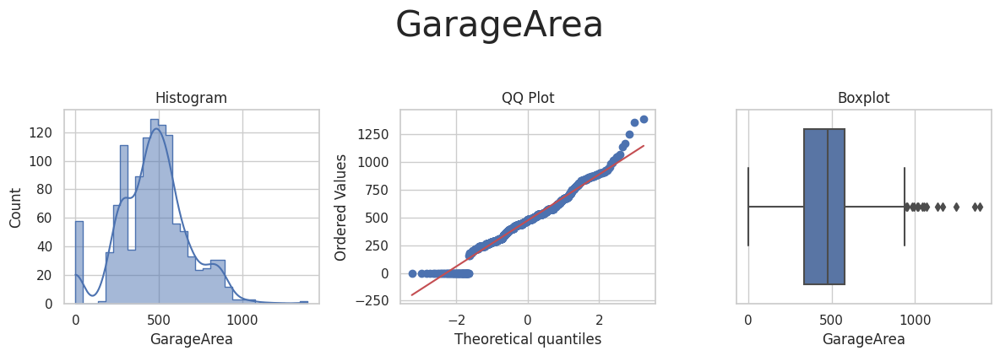

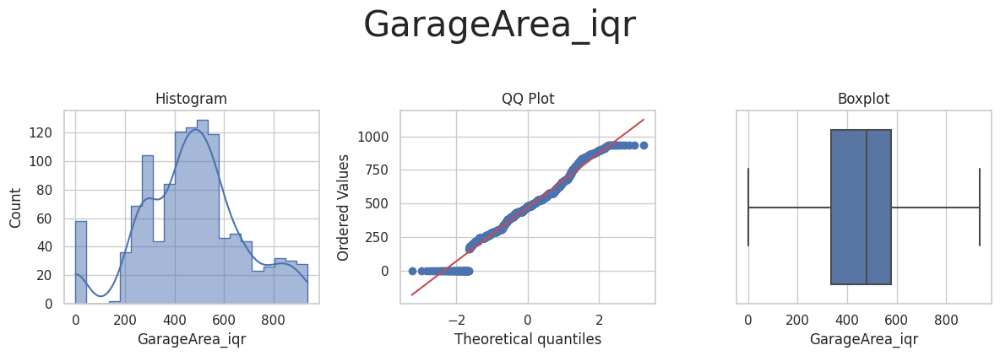



* Variable Analyzed: GarageArea_power
* Applied transformation: ['GarageArea_power_iqr'] 



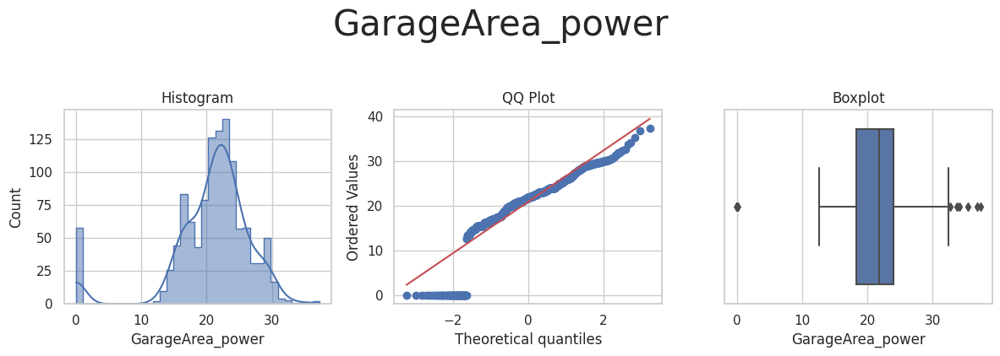

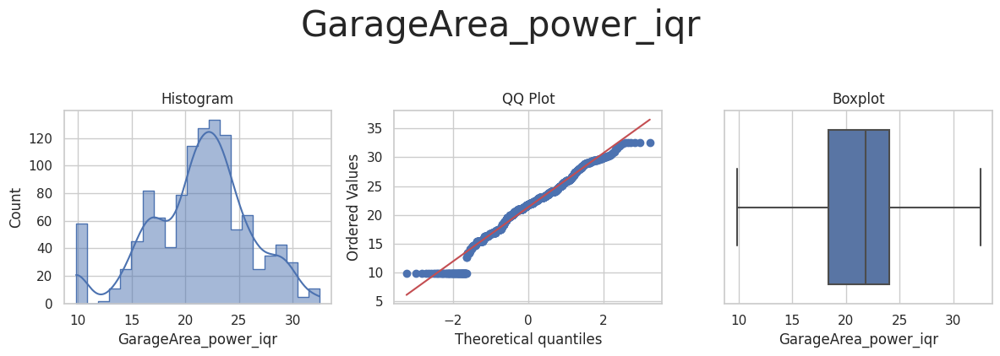



* Variable Analyzed: GarageArea_yeo_johnson
* Applied transformation: ['GarageArea_yeo_johnson_iqr'] 



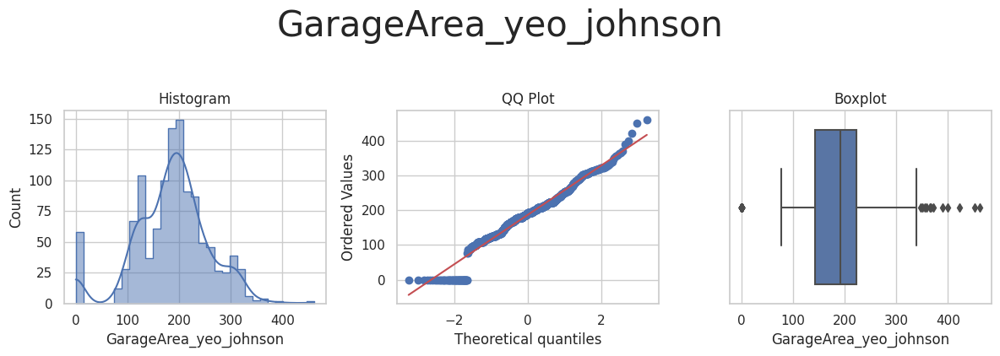

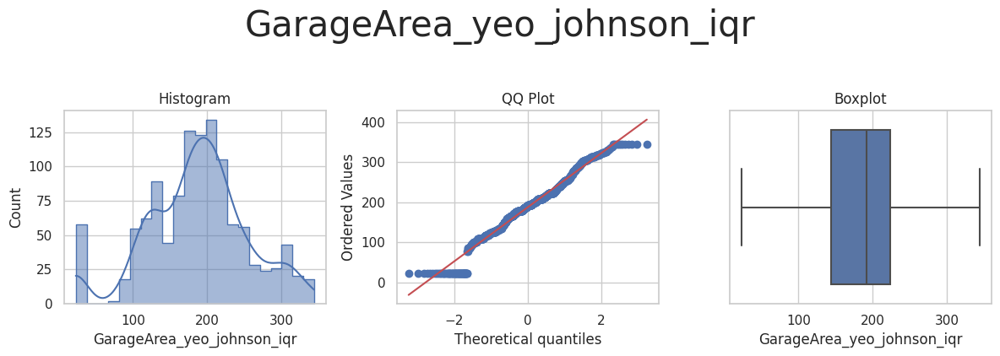



* Variable Analyzed: GarageFinish
* Applied transformation: ['GarageFinish_iqr'] 



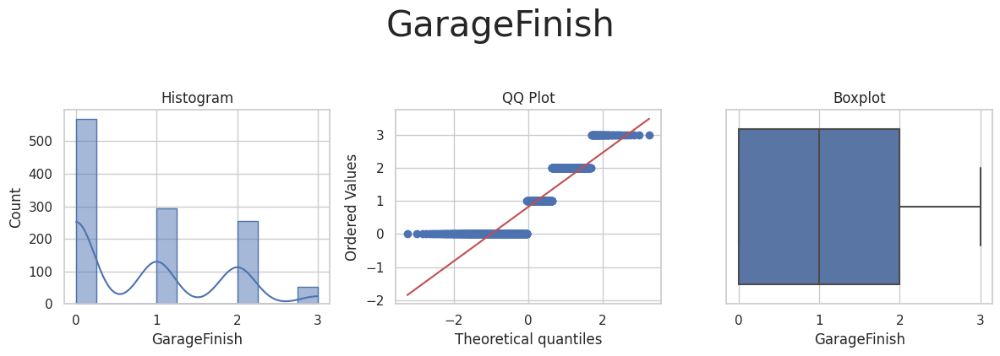

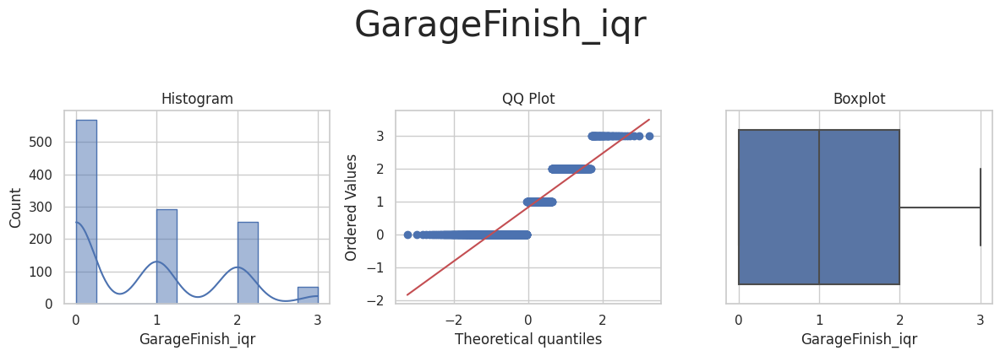



* Variable Analyzed: GarageFinish_power
* Applied transformation: ['GarageFinish_power_iqr'] 



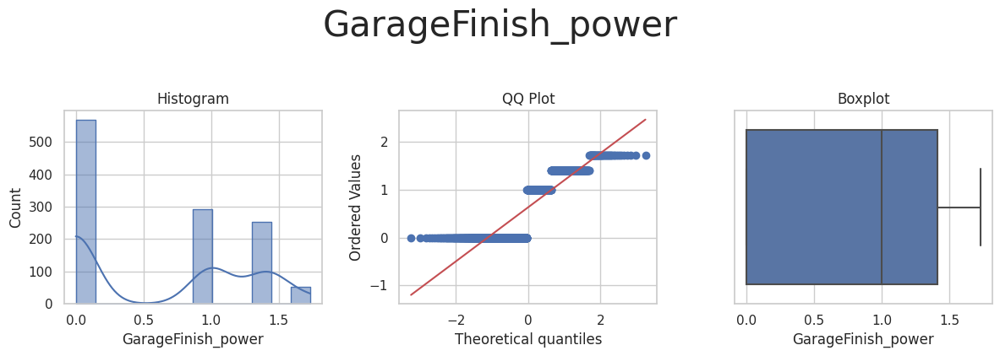

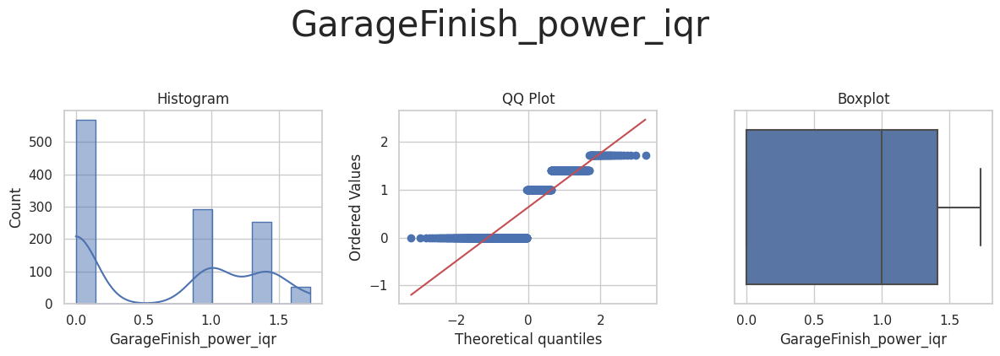



* Variable Analyzed: GarageFinish_yeo_johnson
* Applied transformation: ['GarageFinish_yeo_johnson_iqr'] 



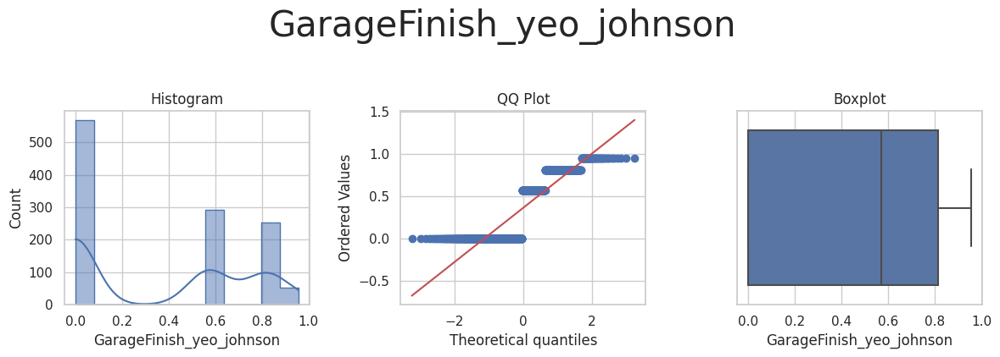

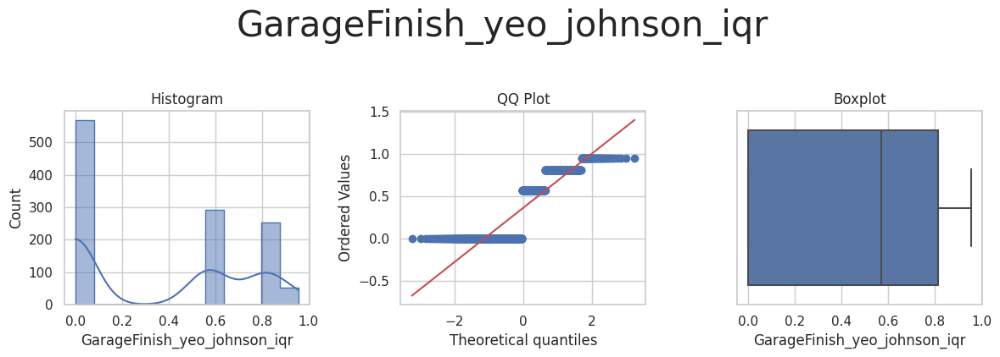



* Variable Analyzed: GarageYrBlt
* Applied transformation: ['GarageYrBlt_iqr'] 



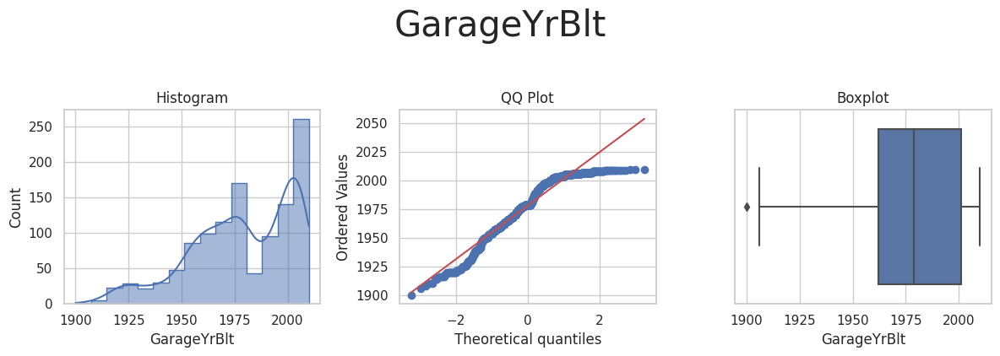

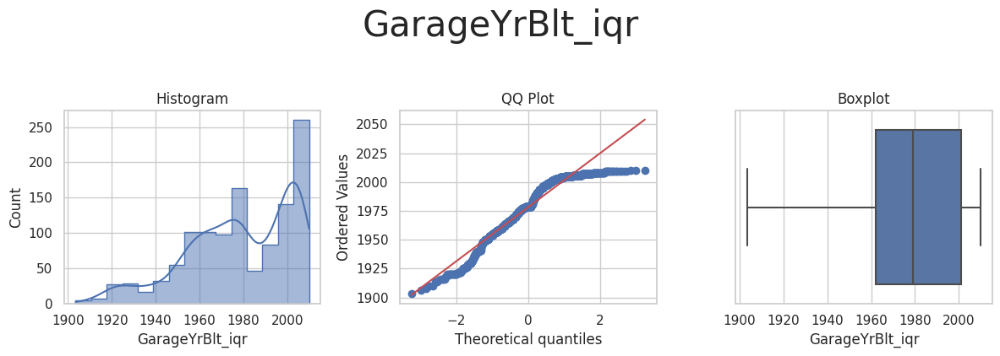



* Variable Analyzed: GarageYrBlt_log_e
* Applied transformation: ['GarageYrBlt_log_e_iqr'] 



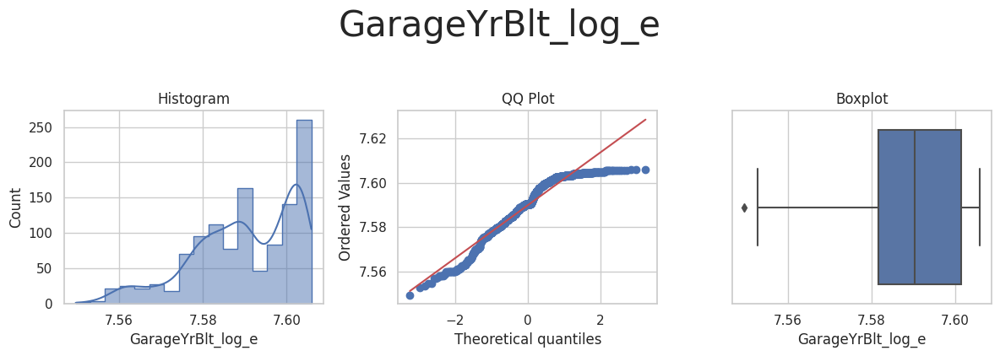

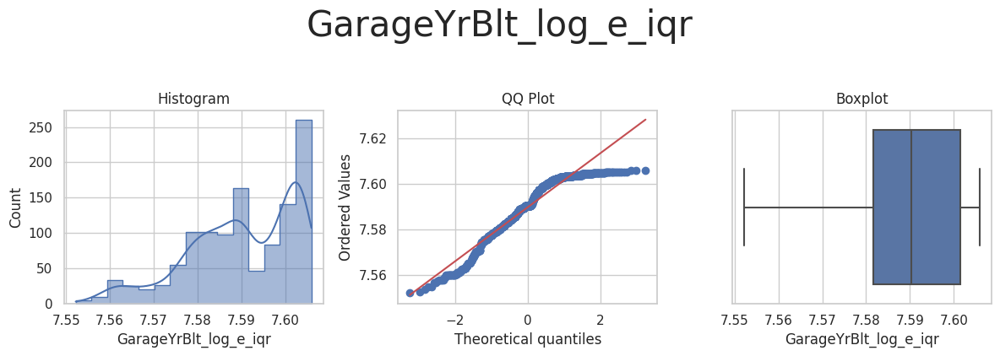



* Variable Analyzed: GarageYrBlt_log_10
* Applied transformation: ['GarageYrBlt_log_10_iqr'] 



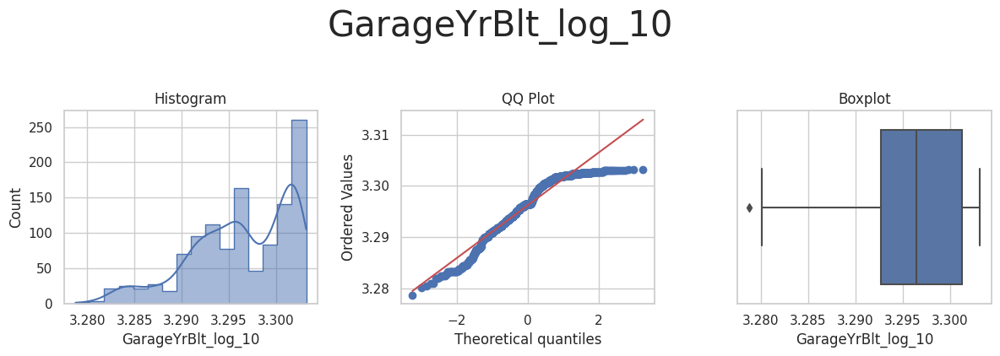

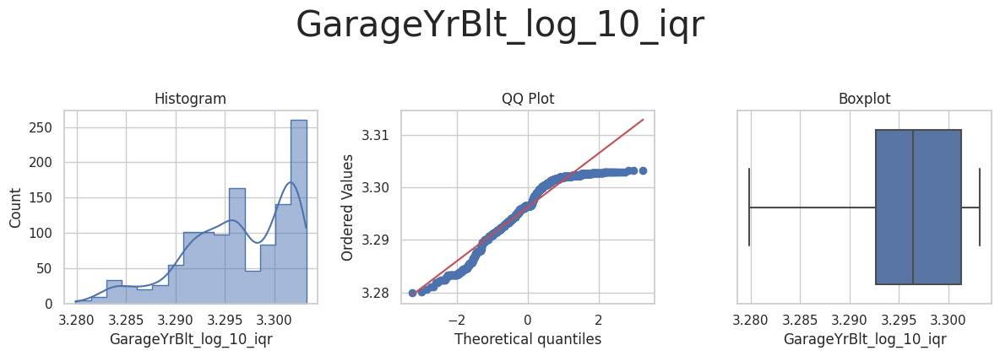



* Variable Analyzed: GarageYrBlt_reciprocal
* Applied transformation: ['GarageYrBlt_reciprocal_iqr'] 



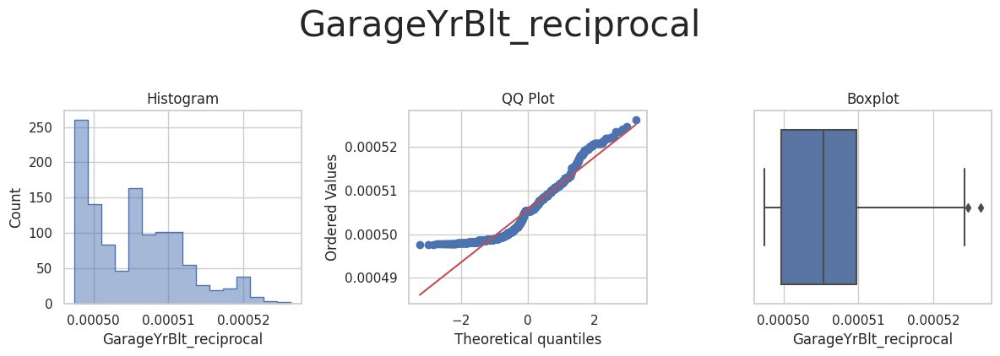

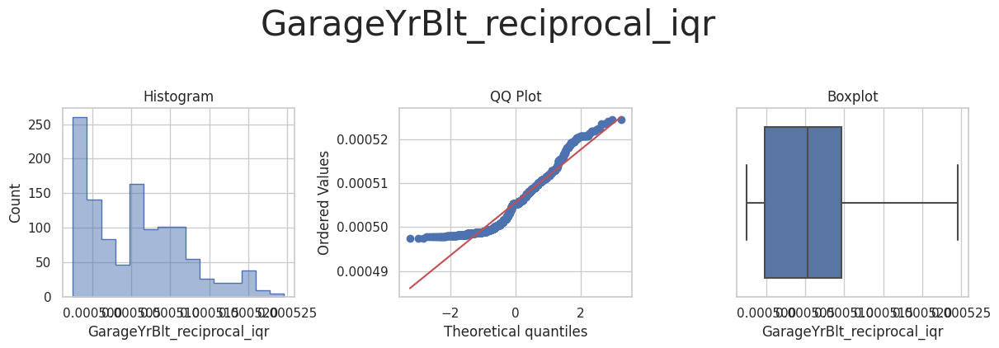



* Variable Analyzed: GarageYrBlt_power
* Applied transformation: ['GarageYrBlt_power_iqr'] 



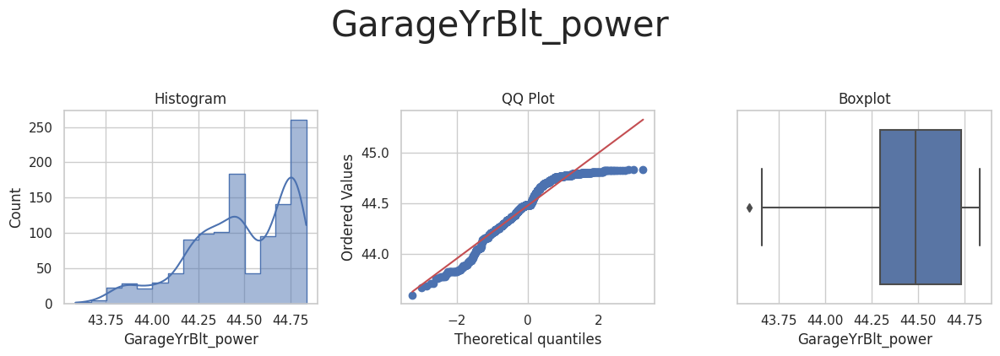

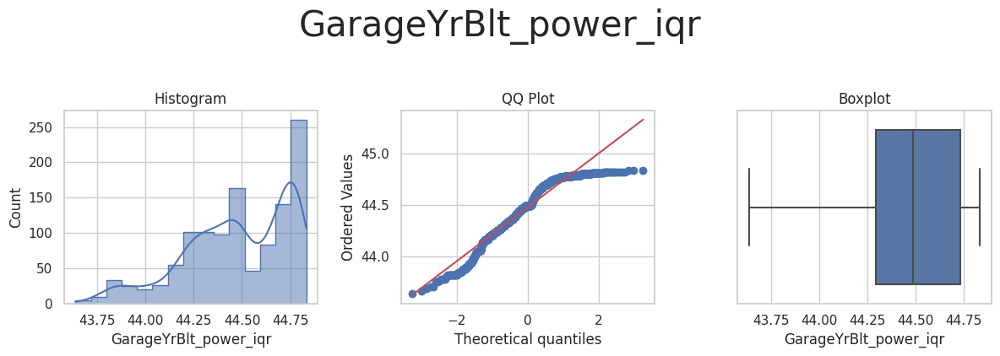



* Variable Analyzed: GarageYrBlt_box_cox
* Applied transformation: ['GarageYrBlt_box_cox_iqr'] 



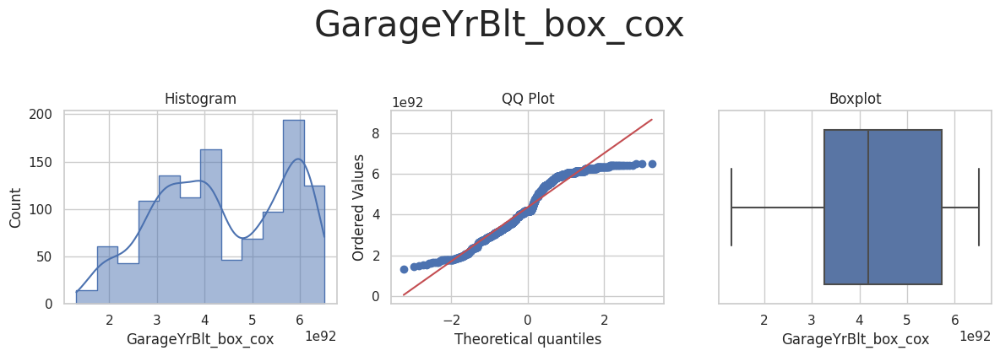

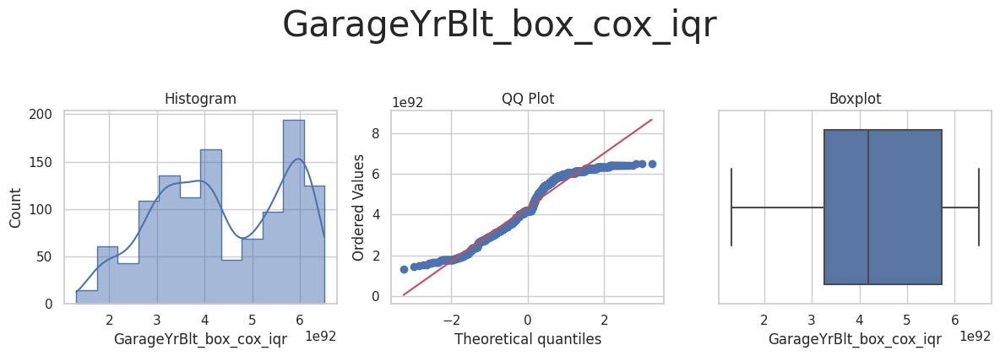



* Variable Analyzed: GarageYrBlt_yeo_johnson
* Applied transformation: ['GarageYrBlt_yeo_johnson_iqr'] 



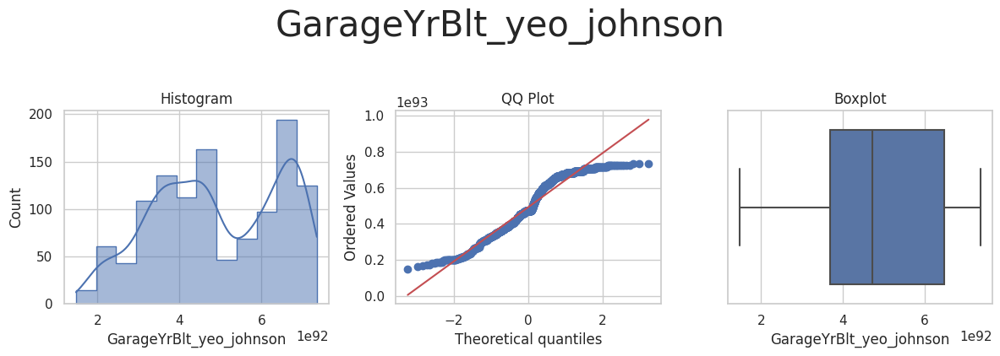

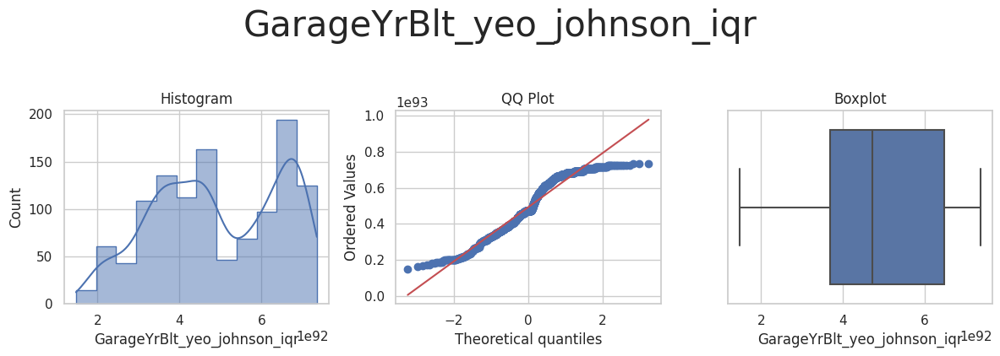



* Variable Analyzed: GrLivArea
* Applied transformation: ['GrLivArea_iqr'] 



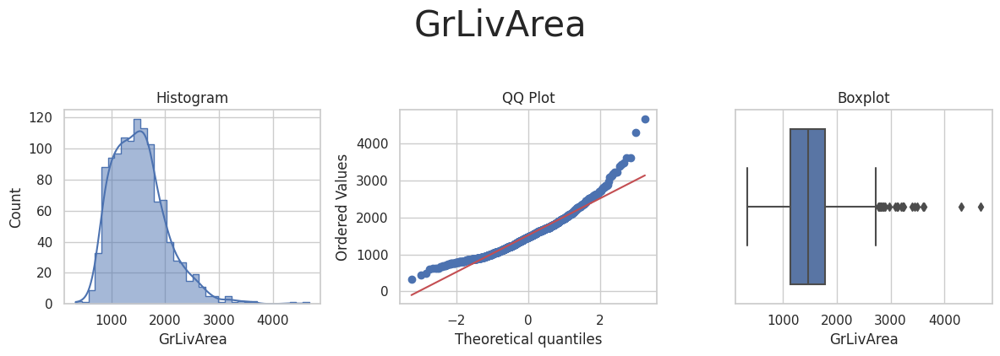

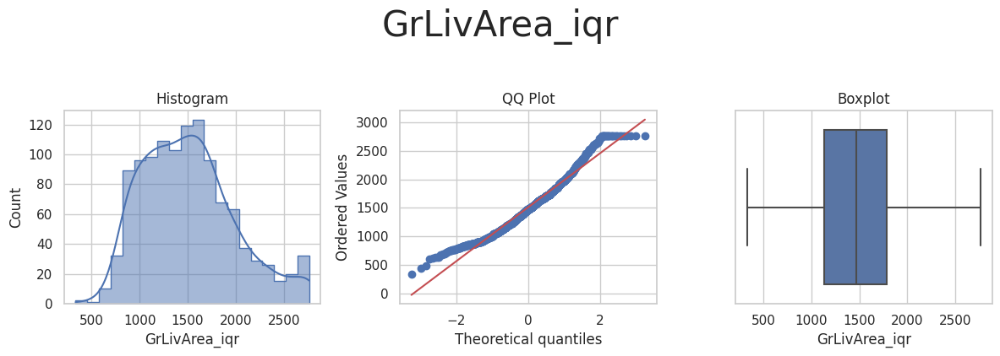



* Variable Analyzed: GrLivArea_log_e
* Applied transformation: ['GrLivArea_log_e_iqr'] 



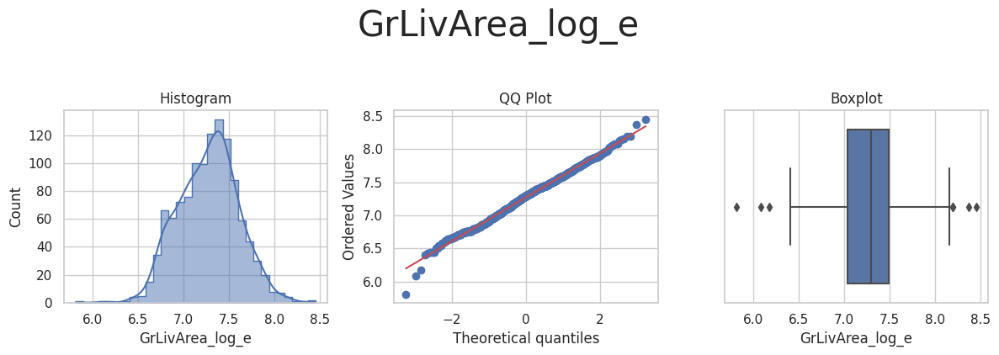

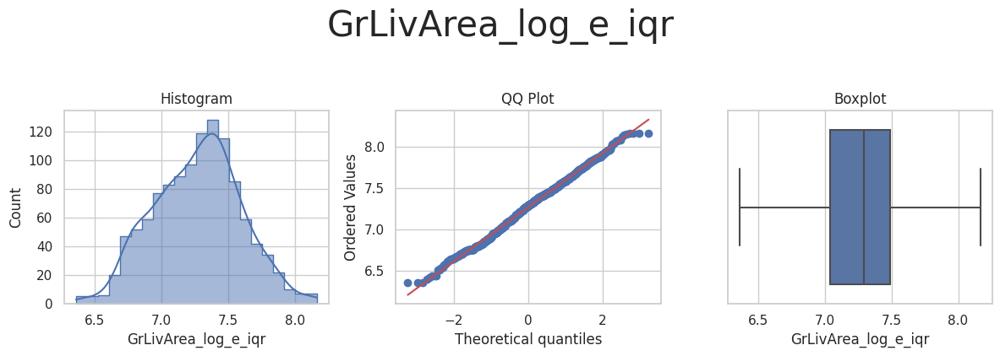



* Variable Analyzed: GrLivArea_log_10
* Applied transformation: ['GrLivArea_log_10_iqr'] 



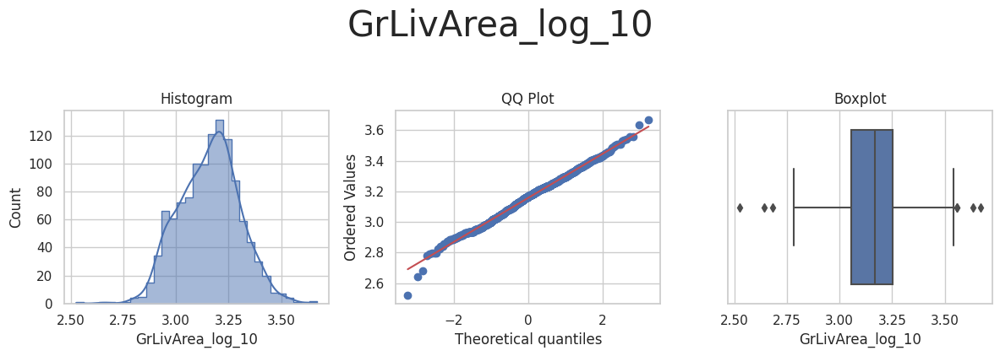

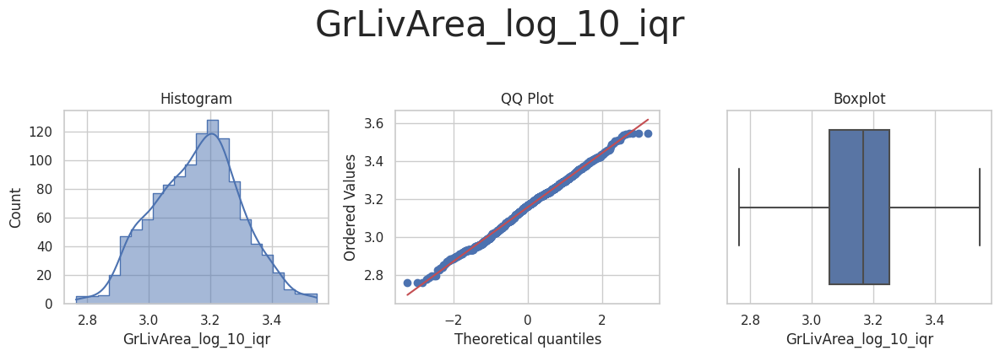



* Variable Analyzed: GrLivArea_reciprocal
* Applied transformation: ['GrLivArea_reciprocal_iqr'] 



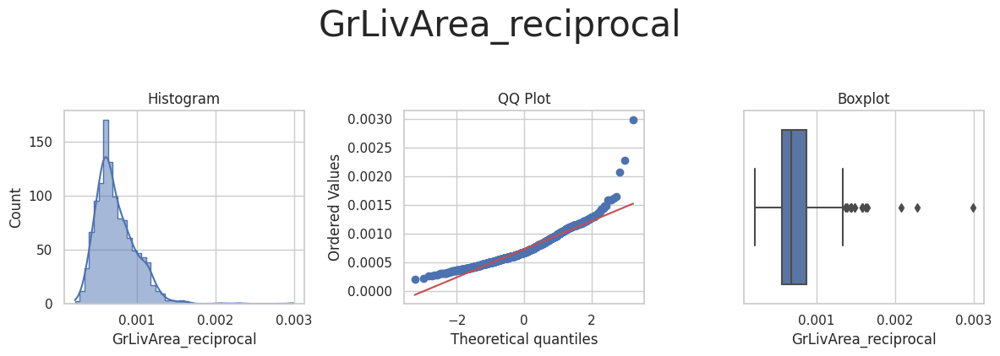

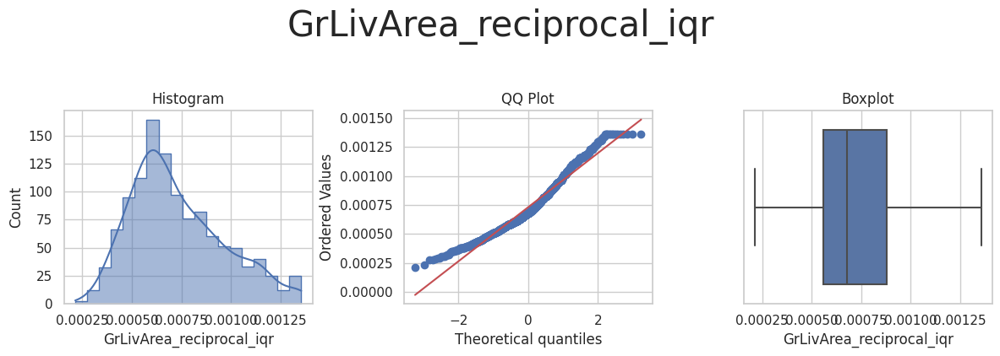



* Variable Analyzed: GrLivArea_power
* Applied transformation: ['GrLivArea_power_iqr'] 



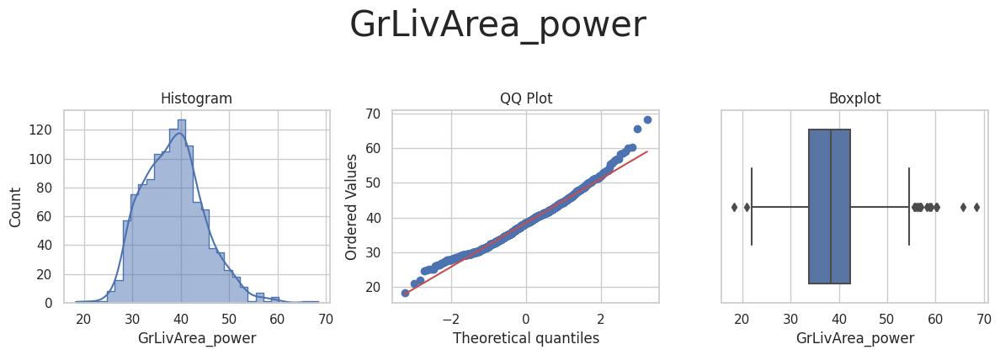

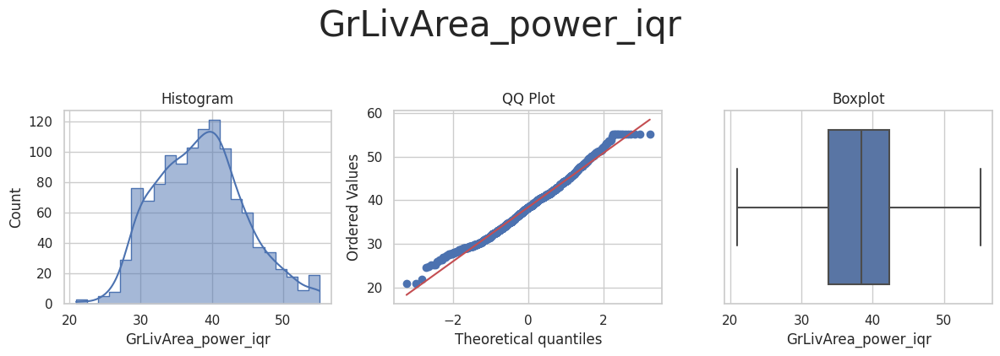



* Variable Analyzed: GrLivArea_box_cox
* Applied transformation: ['GrLivArea_box_cox_iqr'] 



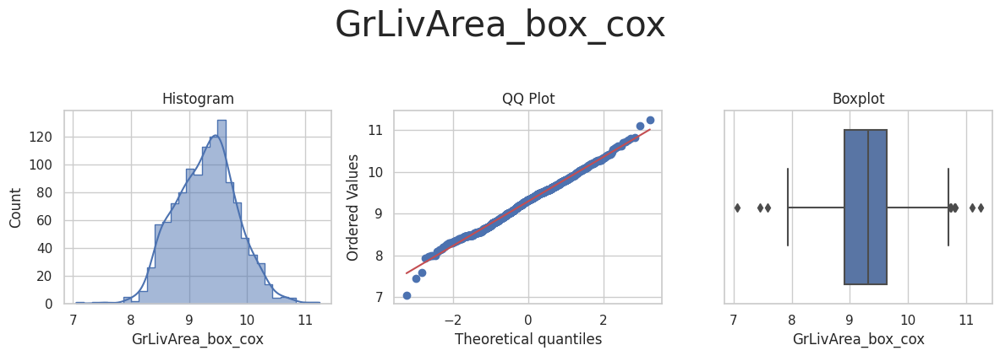

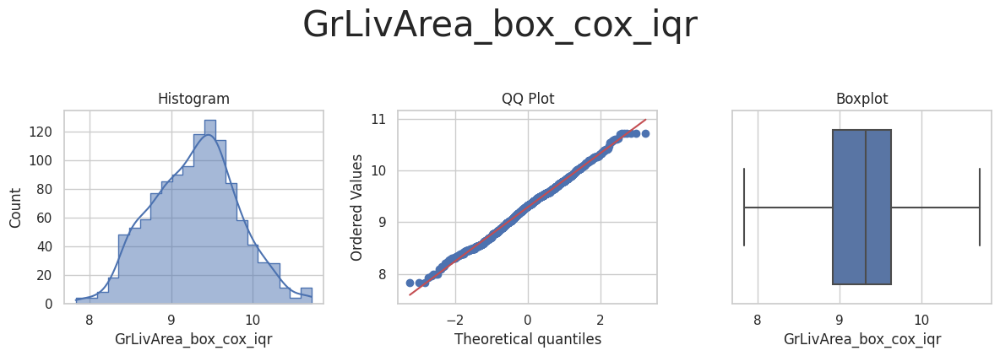



* Variable Analyzed: GrLivArea_yeo_johnson
* Applied transformation: ['GrLivArea_yeo_johnson_iqr'] 



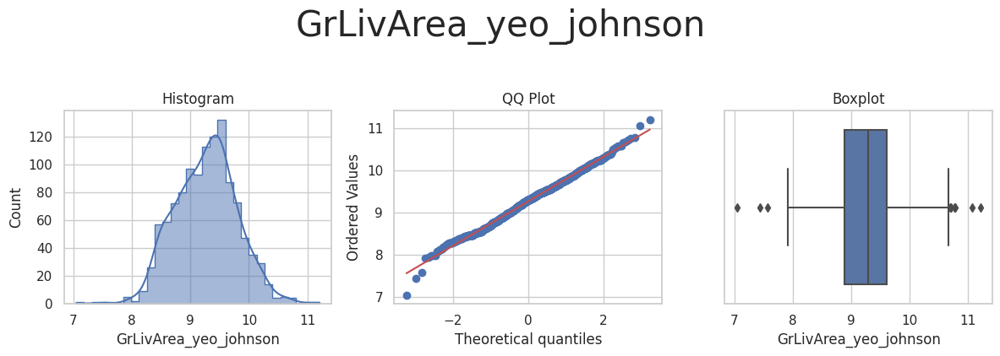

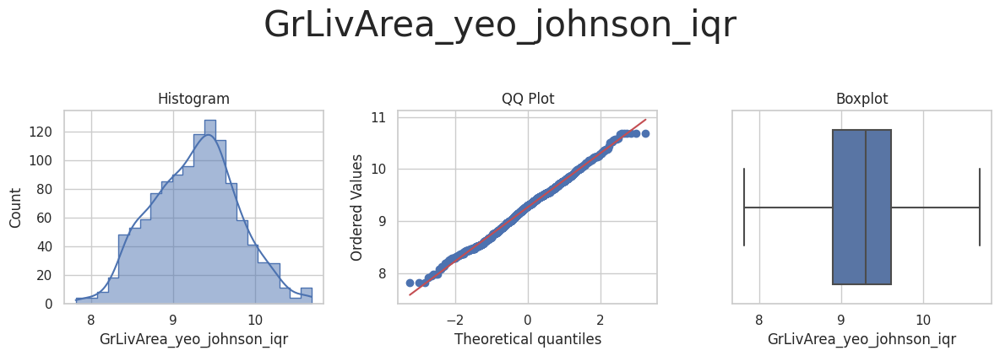



* Variable Analyzed: KitchenQual
* Applied transformation: ['KitchenQual_iqr'] 



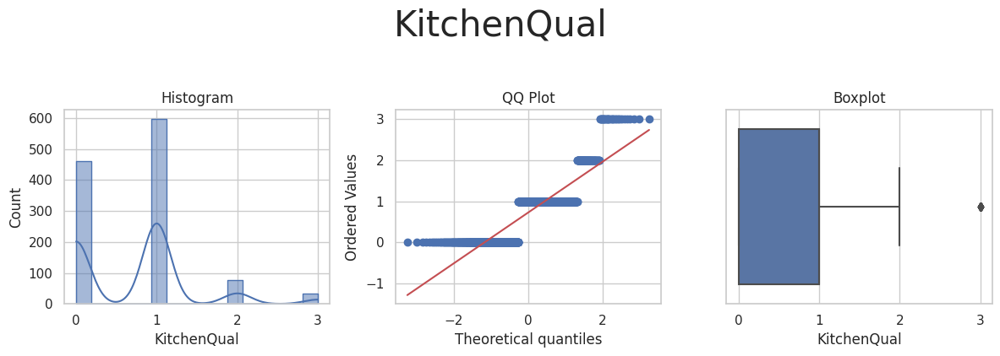

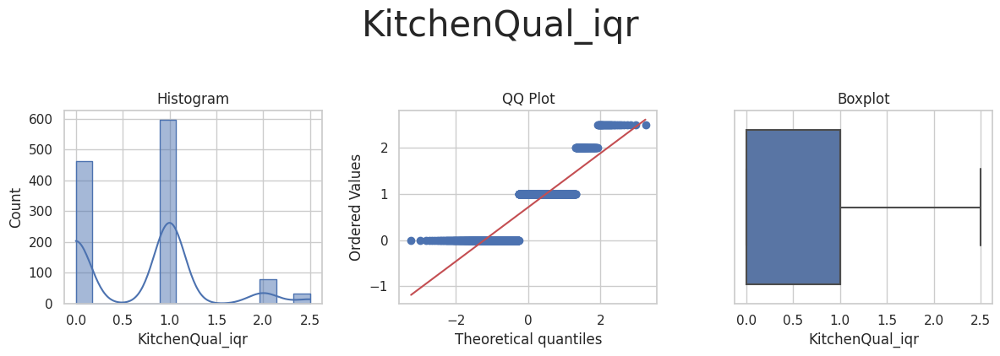



* Variable Analyzed: KitchenQual_power
* Applied transformation: ['KitchenQual_power_iqr'] 



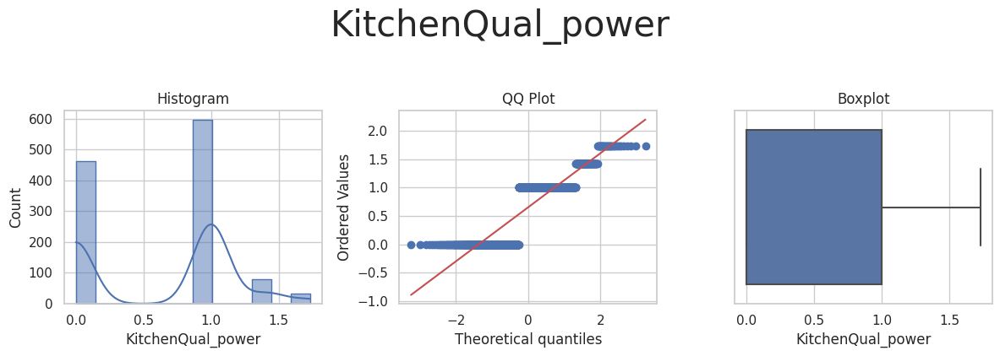

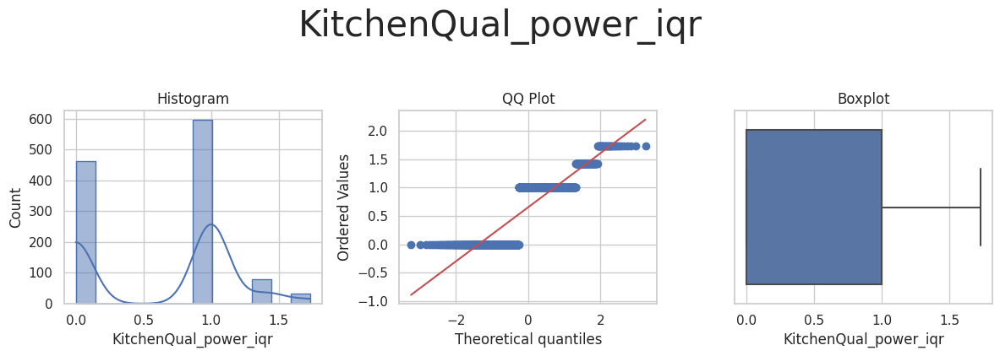



* Variable Analyzed: KitchenQual_yeo_johnson
* Applied transformation: ['KitchenQual_yeo_johnson_iqr'] 



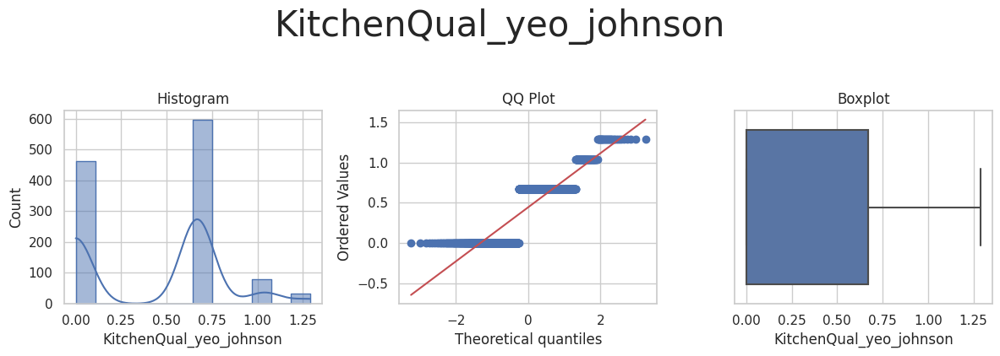

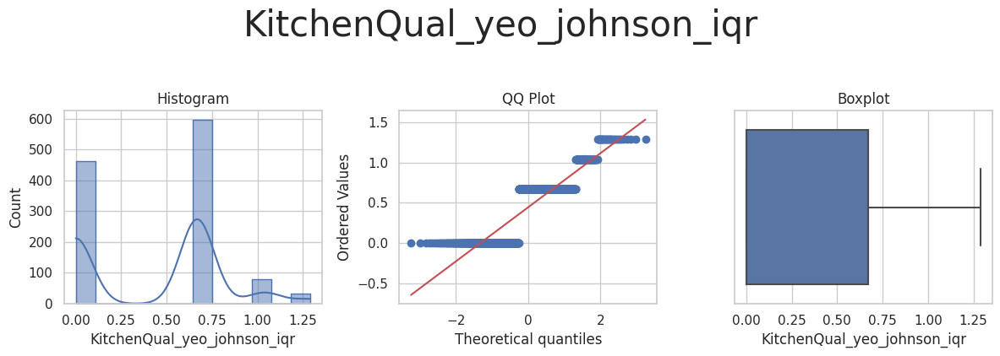



* Variable Analyzed: LotArea
* Applied transformation: ['LotArea_iqr'] 



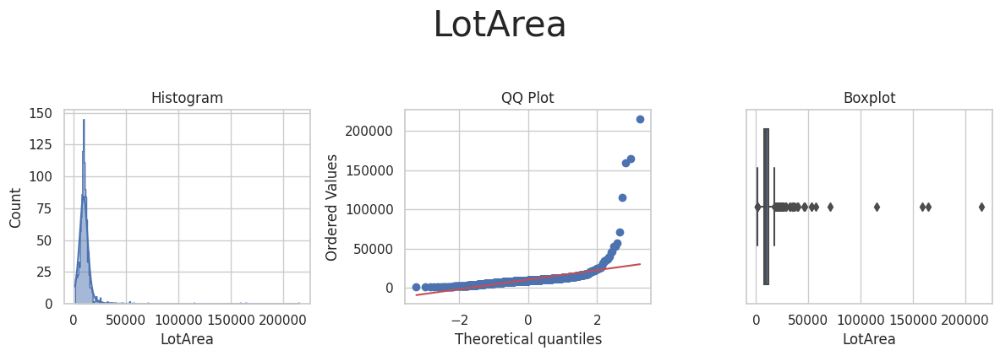

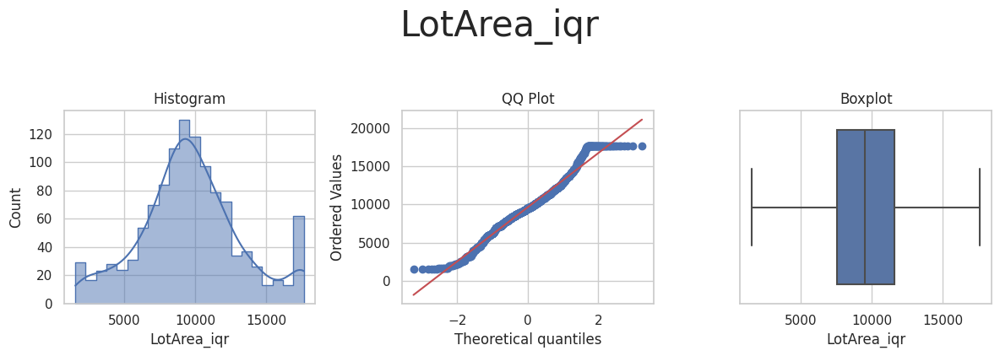



* Variable Analyzed: LotArea_log_e
* Applied transformation: ['LotArea_log_e_iqr'] 



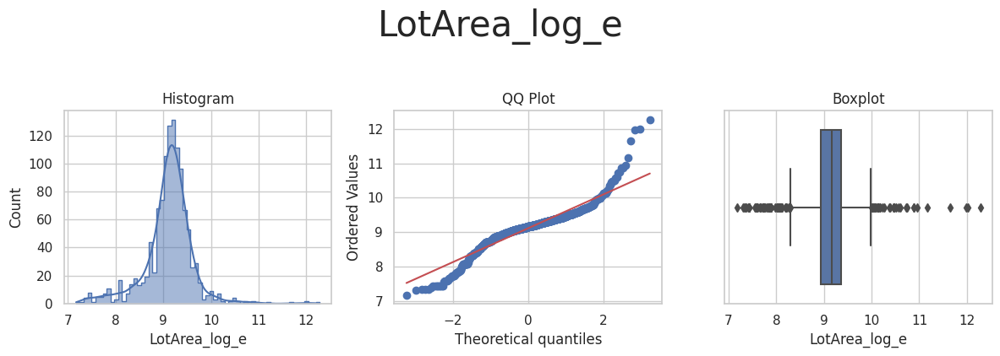

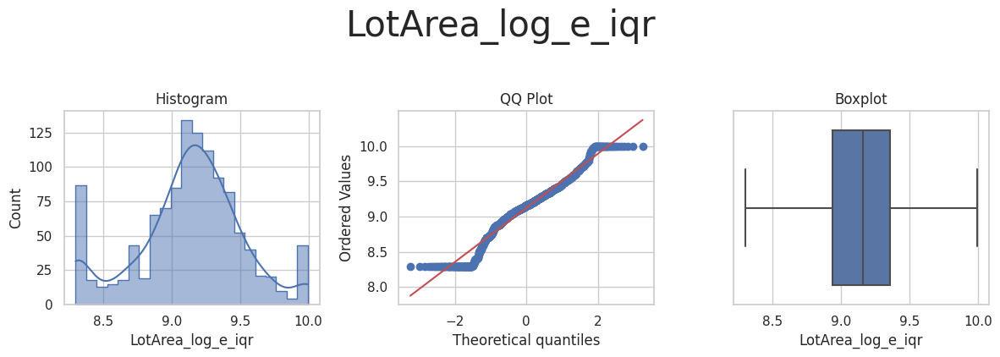



* Variable Analyzed: LotArea_log_10
* Applied transformation: ['LotArea_log_10_iqr'] 



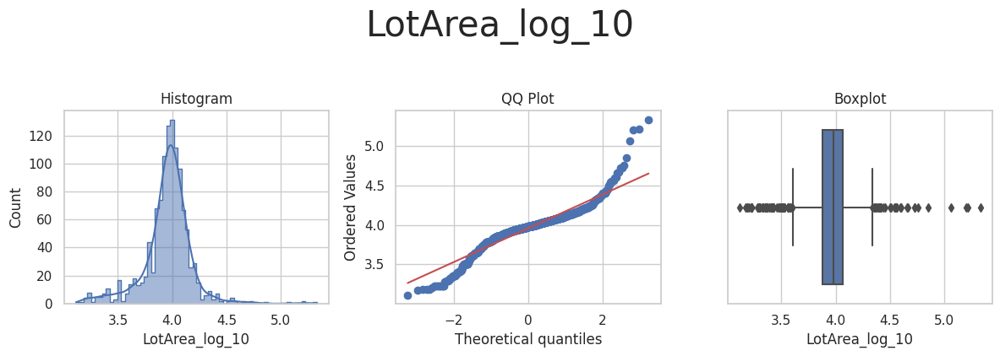

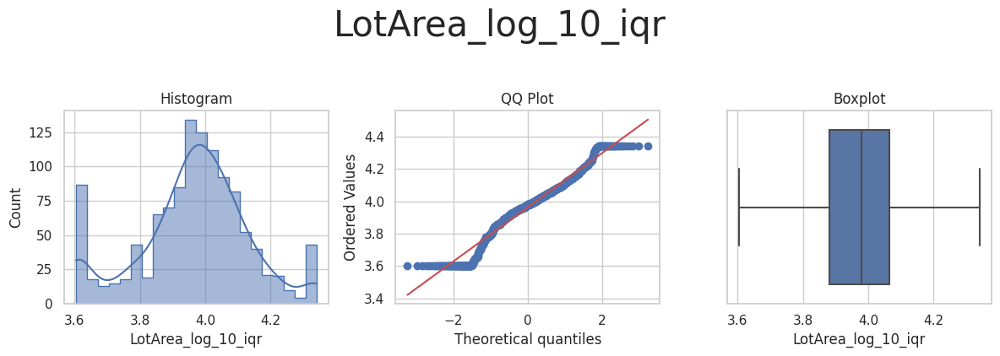



* Variable Analyzed: LotArea_reciprocal
* Applied transformation: ['LotArea_reciprocal_iqr'] 



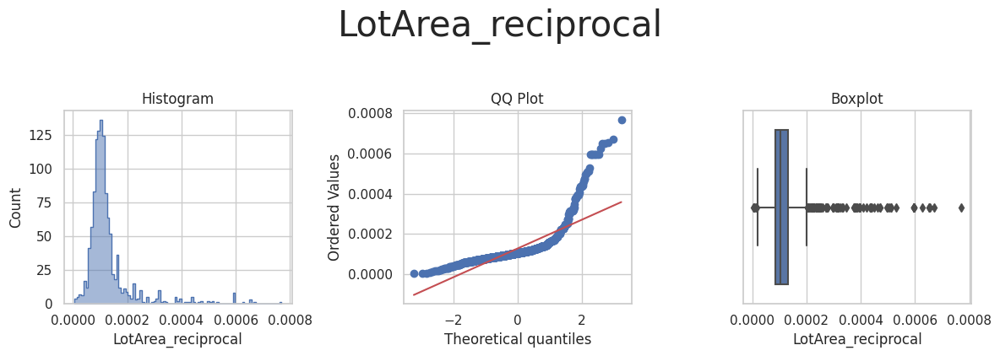

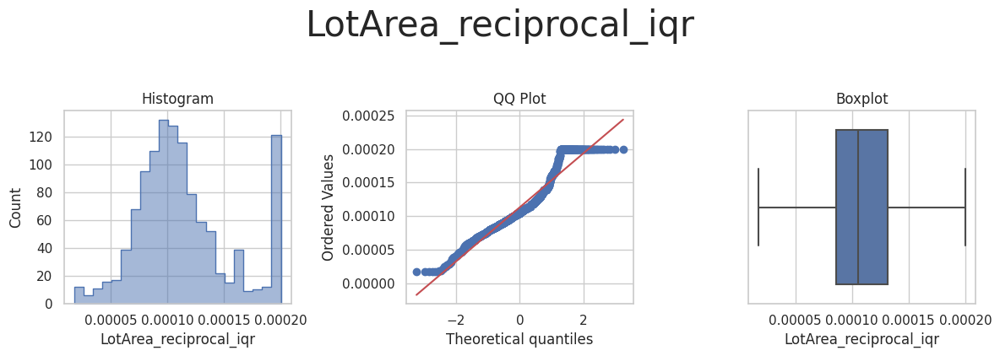



* Variable Analyzed: LotArea_power
* Applied transformation: ['LotArea_power_iqr'] 



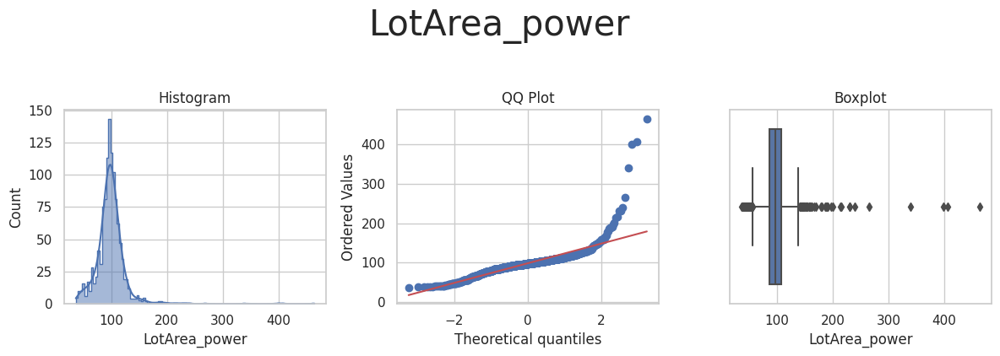

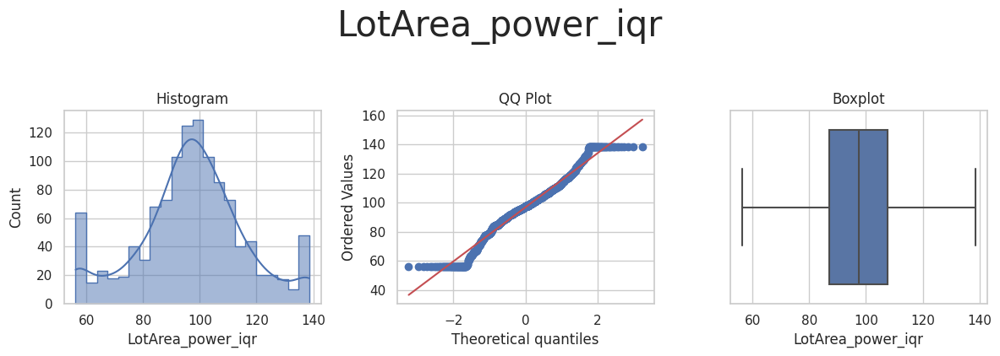



* Variable Analyzed: LotArea_box_cox
* Applied transformation: ['LotArea_box_cox_iqr'] 



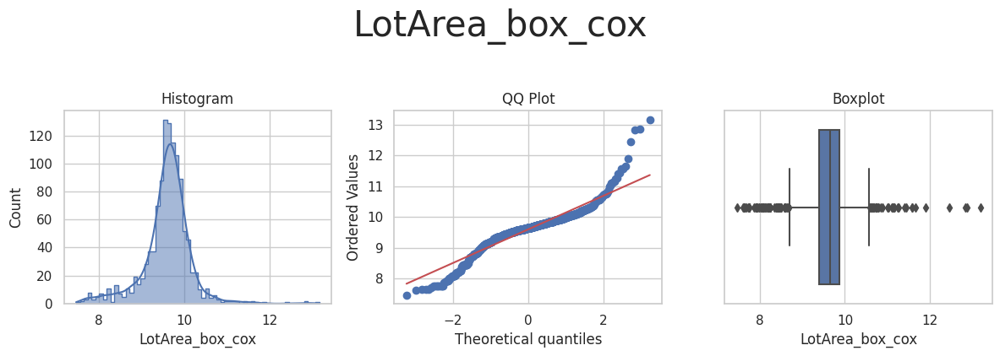

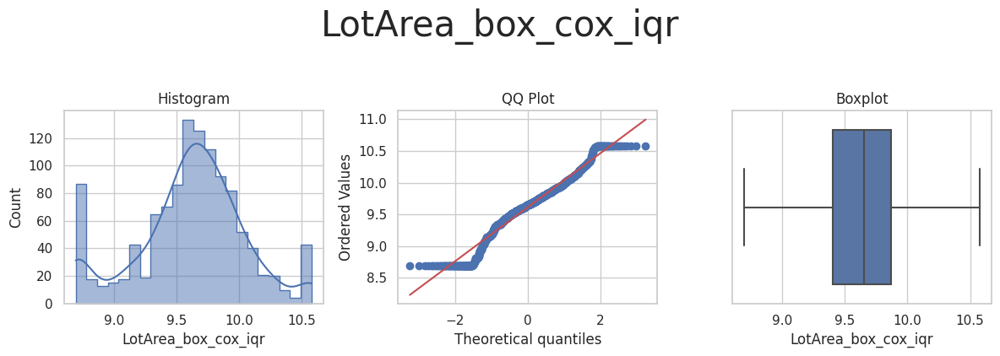



* Variable Analyzed: LotArea_yeo_johnson
* Applied transformation: ['LotArea_yeo_johnson_iqr'] 



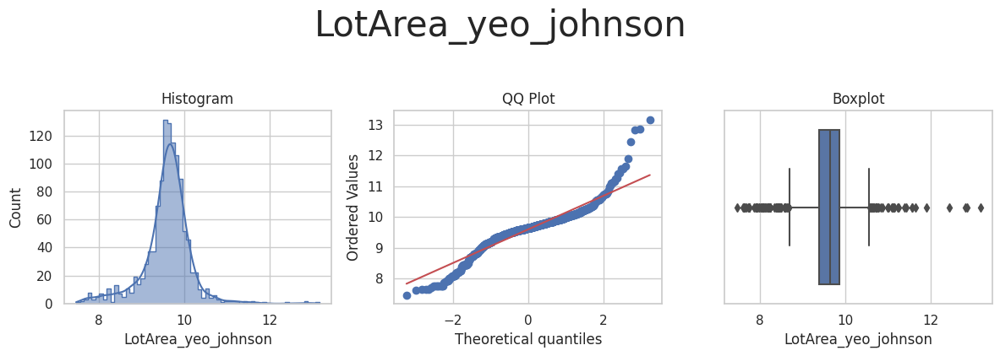

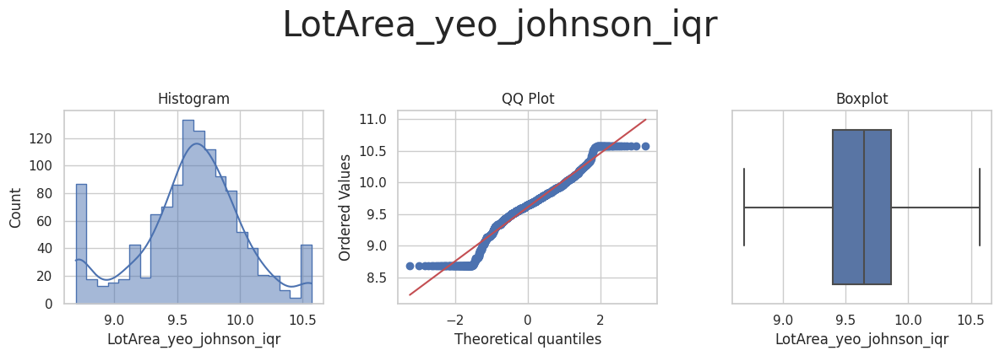



* Variable Analyzed: LotFrontage
* Applied transformation: ['LotFrontage_iqr'] 



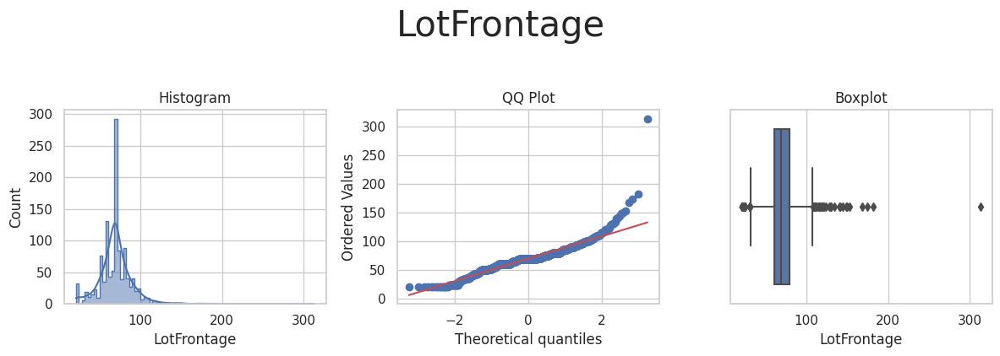

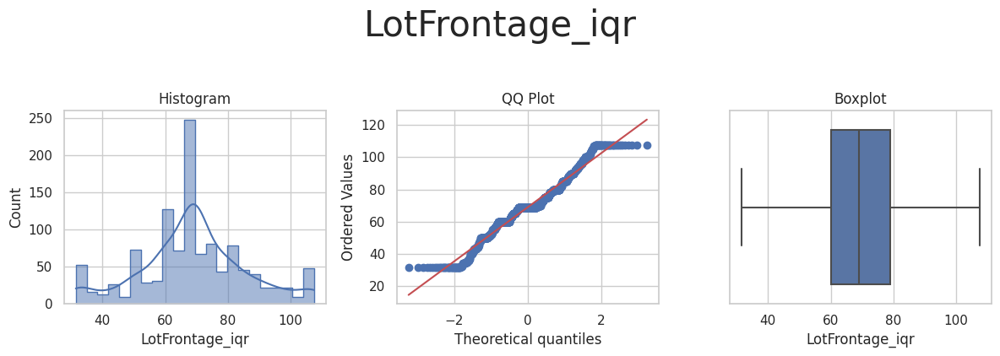



* Variable Analyzed: LotFrontage_log_e
* Applied transformation: ['LotFrontage_log_e_iqr'] 



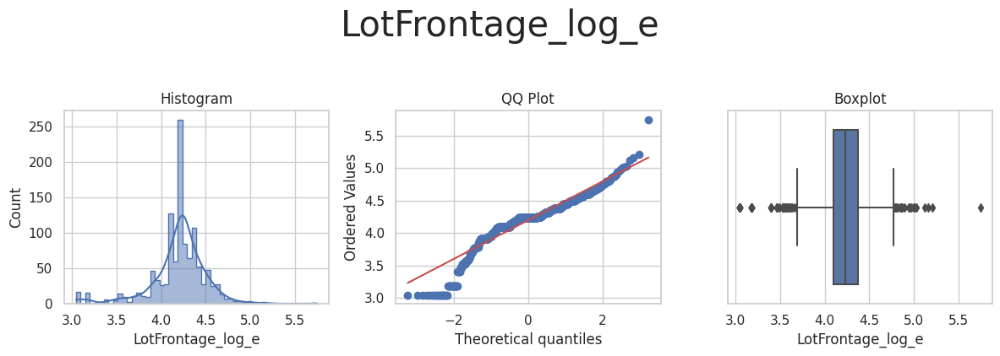

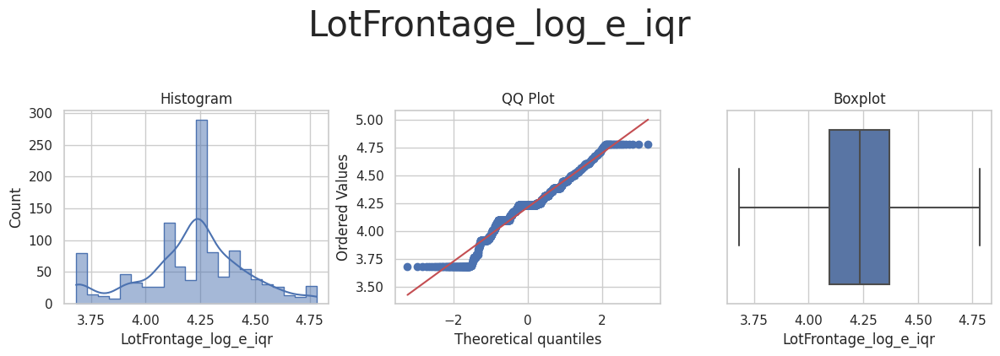



* Variable Analyzed: LotFrontage_log_10
* Applied transformation: ['LotFrontage_log_10_iqr'] 



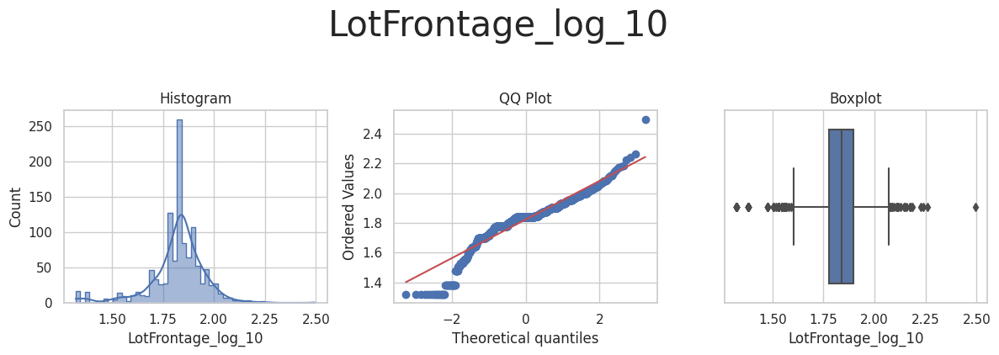

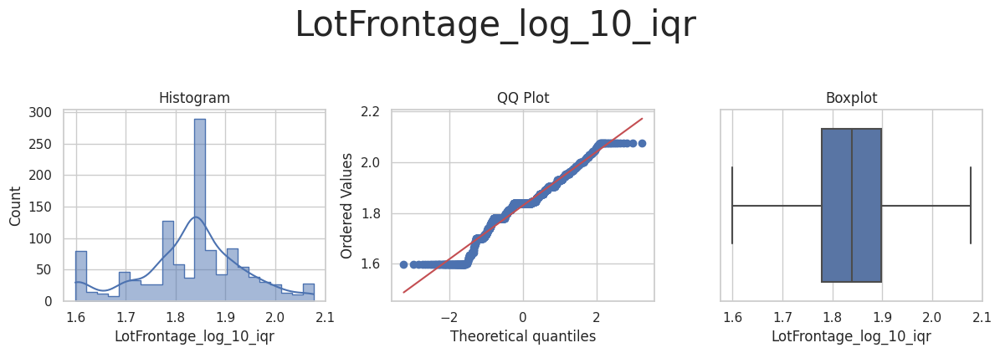



* Variable Analyzed: LotFrontage_reciprocal
* Applied transformation: ['LotFrontage_reciprocal_iqr'] 



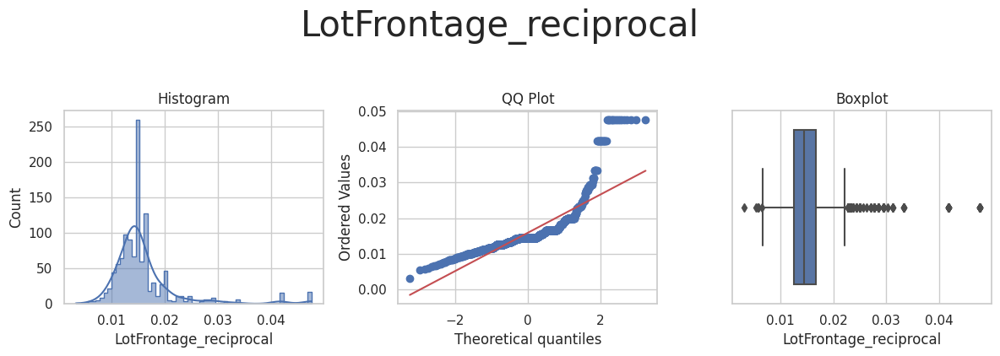

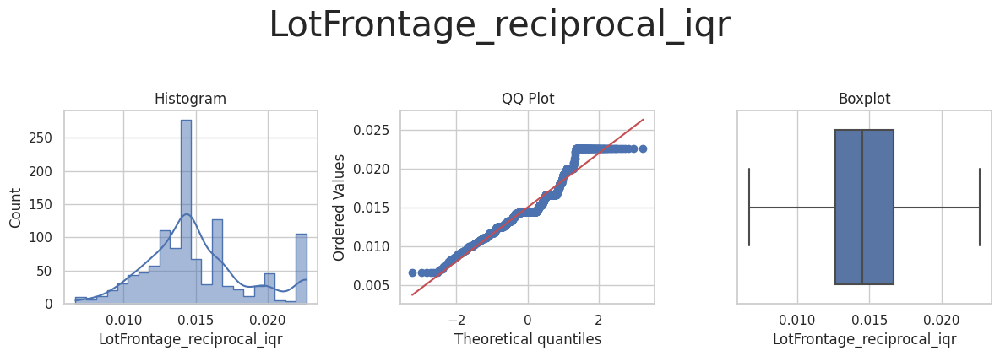



* Variable Analyzed: LotFrontage_power
* Applied transformation: ['LotFrontage_power_iqr'] 



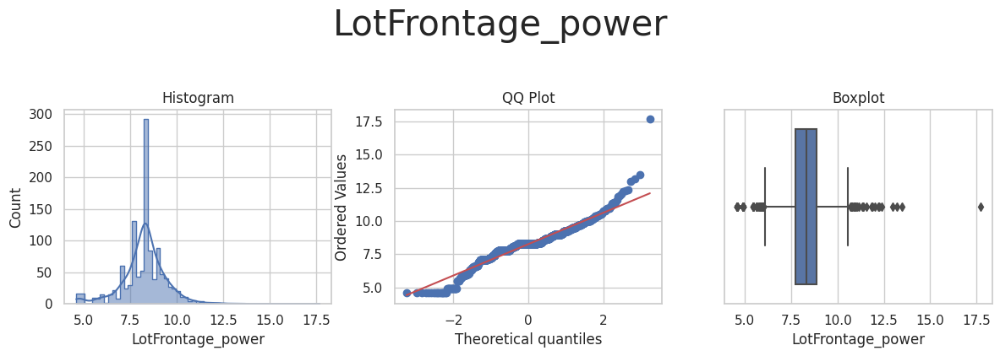

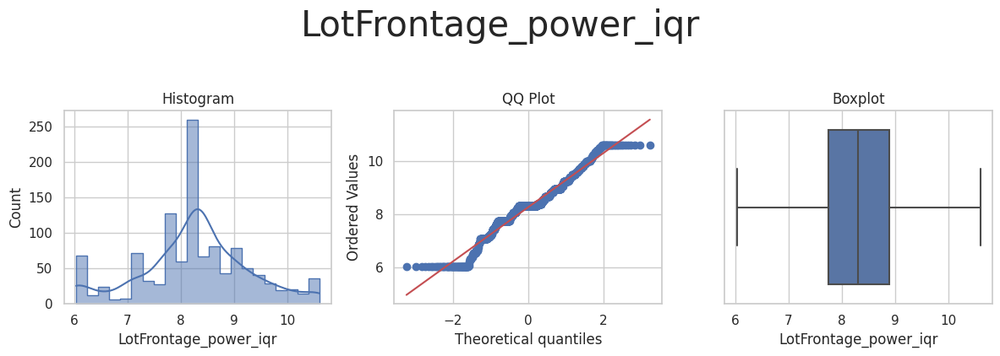



* Variable Analyzed: LotFrontage_box_cox
* Applied transformation: ['LotFrontage_box_cox_iqr'] 



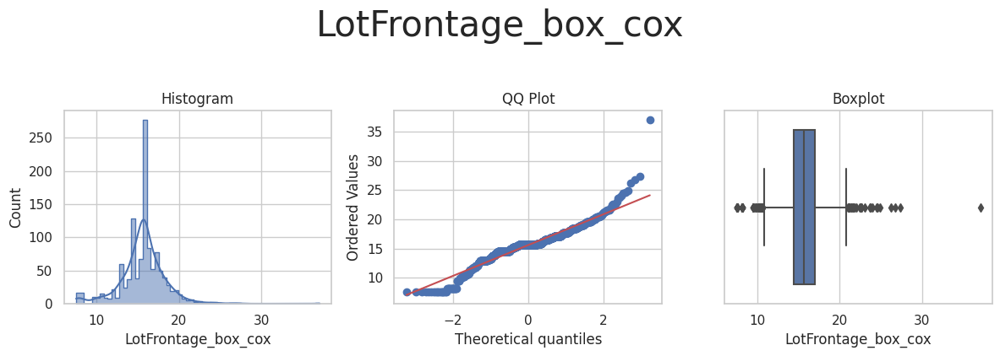

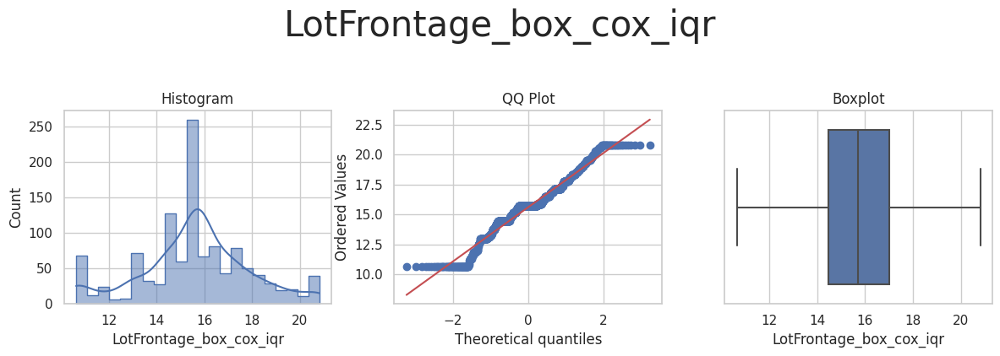



* Variable Analyzed: LotFrontage_yeo_johnson
* Applied transformation: ['LotFrontage_yeo_johnson_iqr'] 



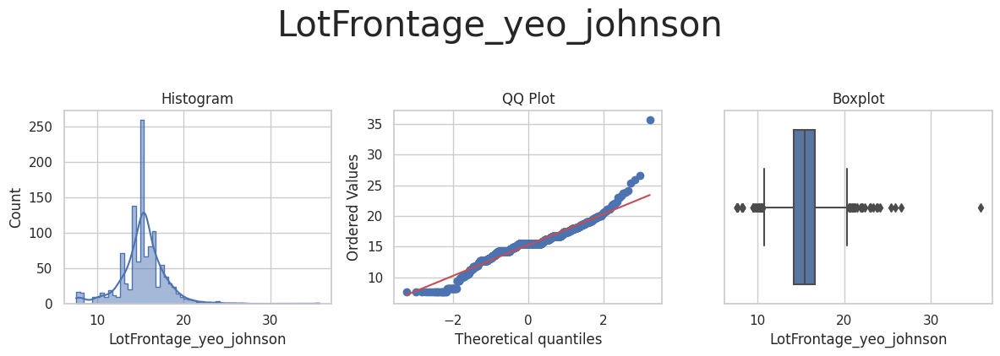

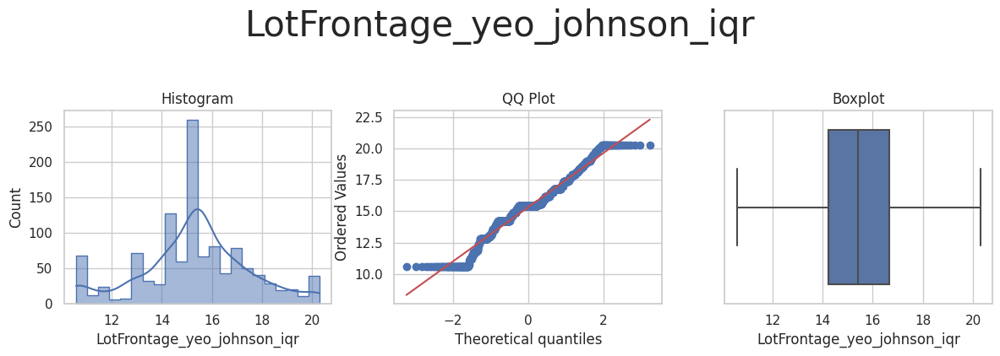



* Variable Analyzed: MasVnrArea
* Applied transformation: ['MasVnrArea_iqr'] 



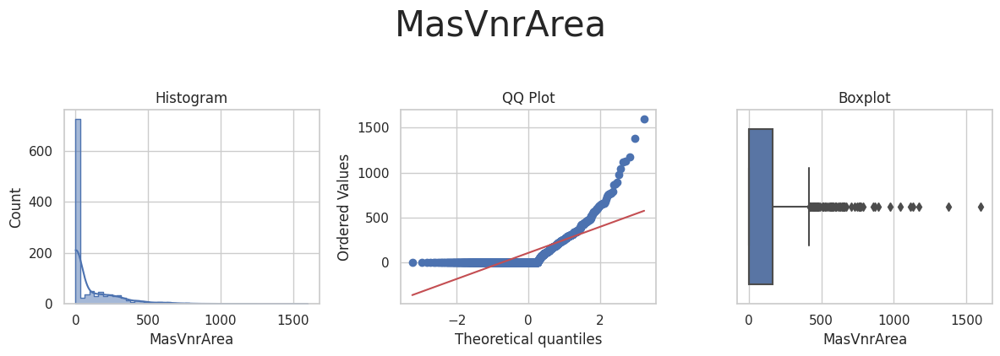

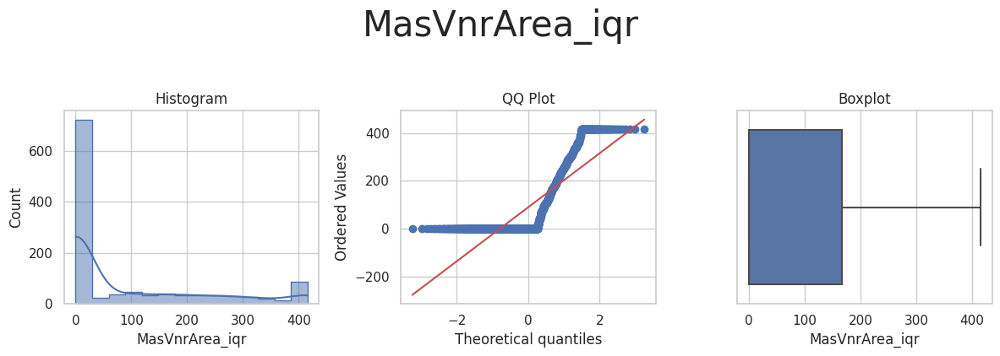



* Variable Analyzed: MasVnrArea_power
* Applied transformation: ['MasVnrArea_power_iqr'] 



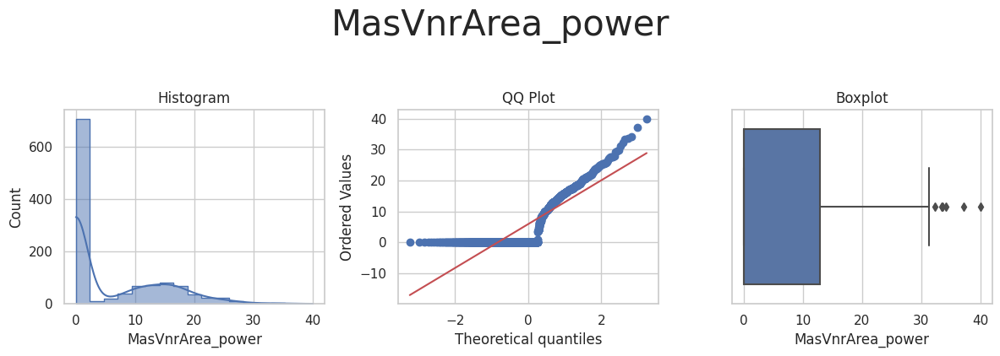

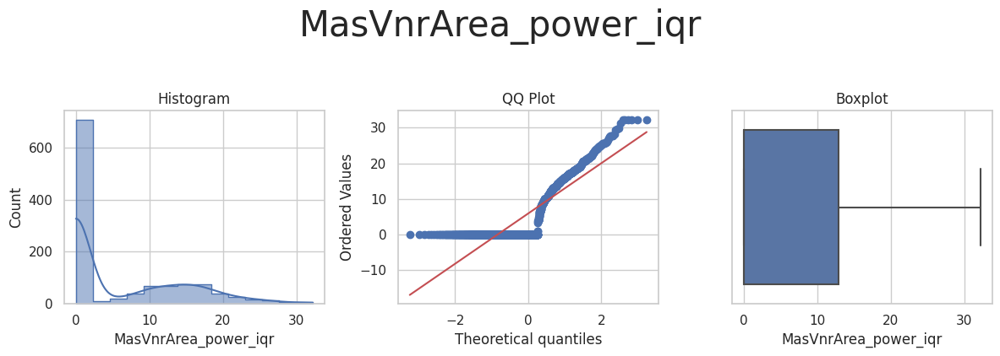



* Variable Analyzed: MasVnrArea_yeo_johnson
* Applied transformation: ['MasVnrArea_yeo_johnson_iqr'] 



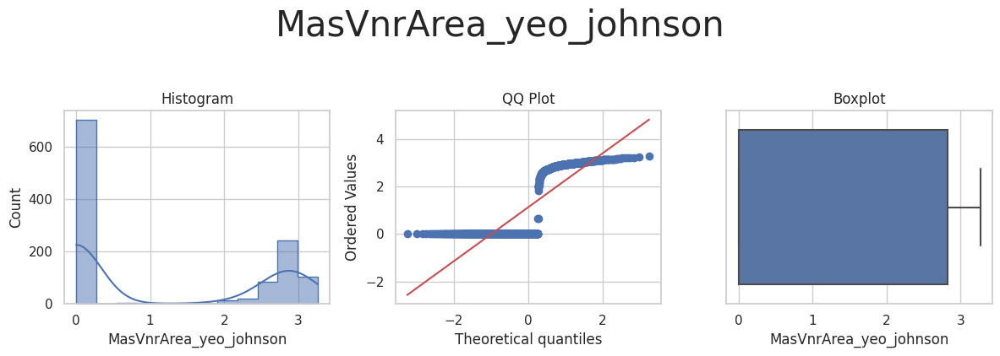

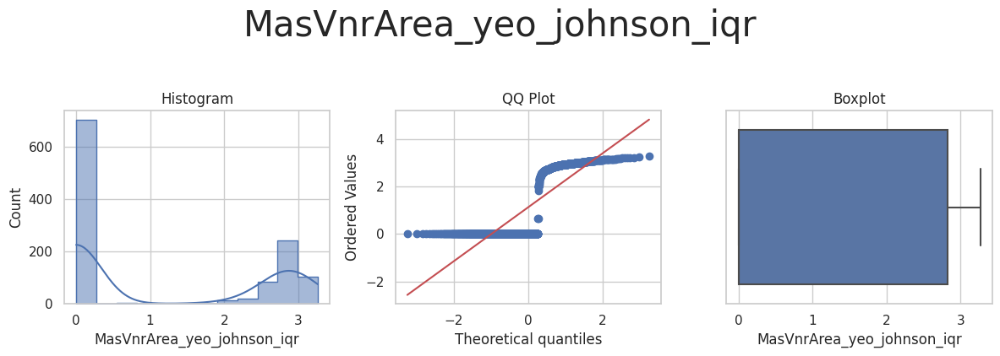



* Variable Analyzed: OpenPorchSF
* Applied transformation: ['OpenPorchSF_iqr'] 



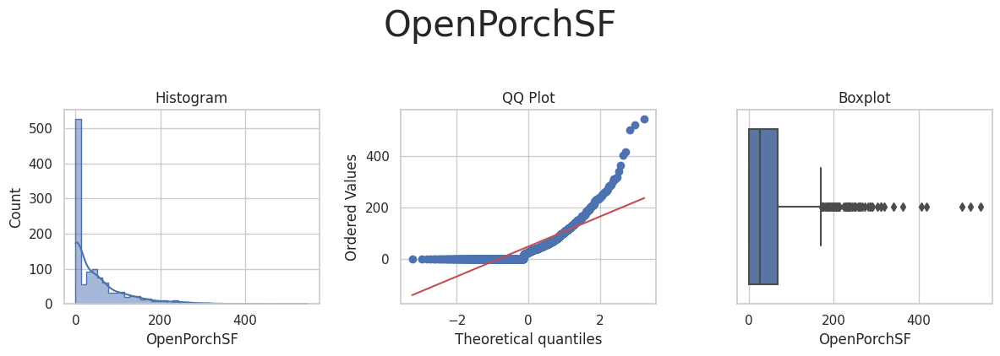

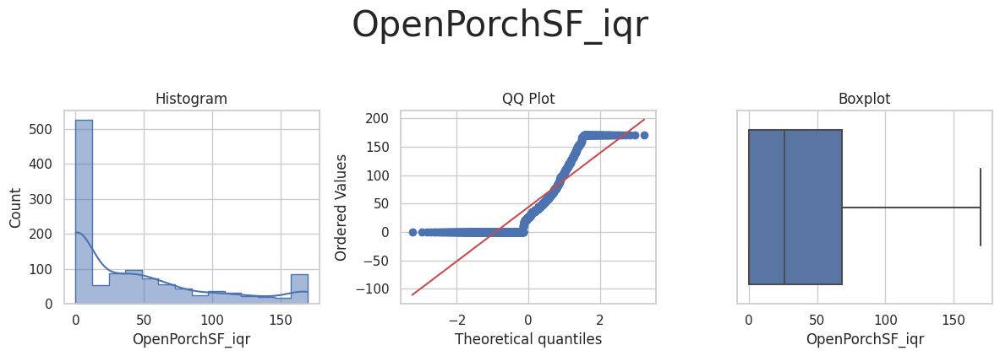



* Variable Analyzed: OpenPorchSF_power
* Applied transformation: ['OpenPorchSF_power_iqr'] 



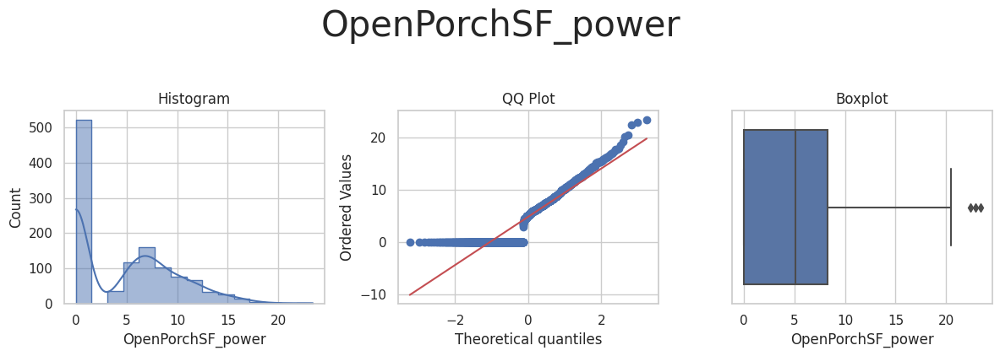

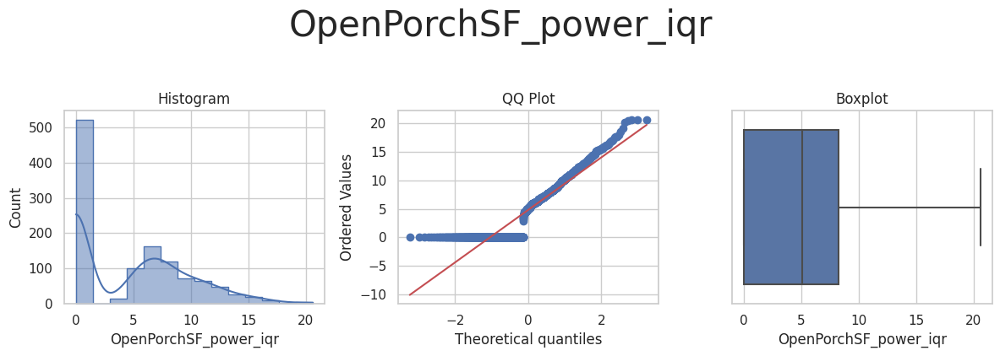



* Variable Analyzed: OpenPorchSF_yeo_johnson
* Applied transformation: ['OpenPorchSF_yeo_johnson_iqr'] 



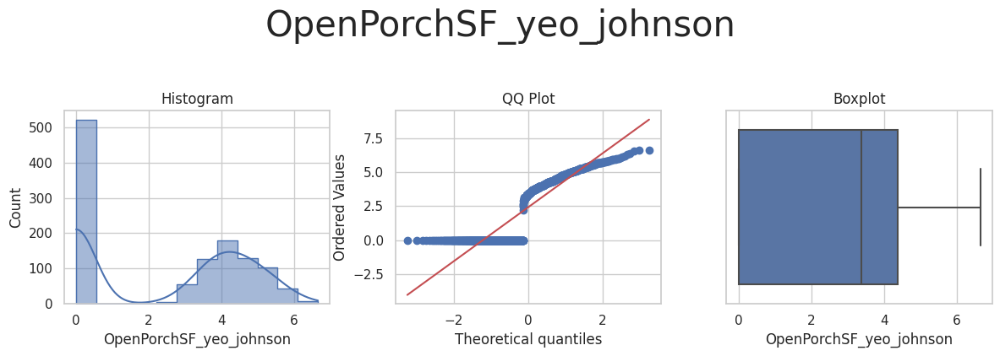

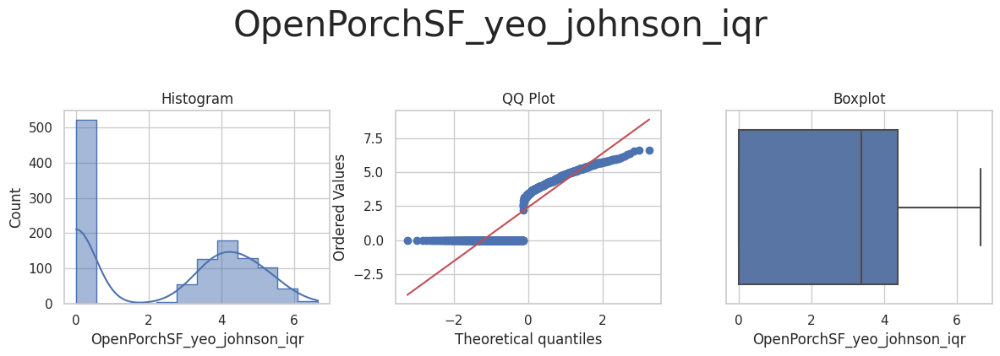



* Variable Analyzed: OverallCond
* Applied transformation: ['OverallCond_iqr'] 



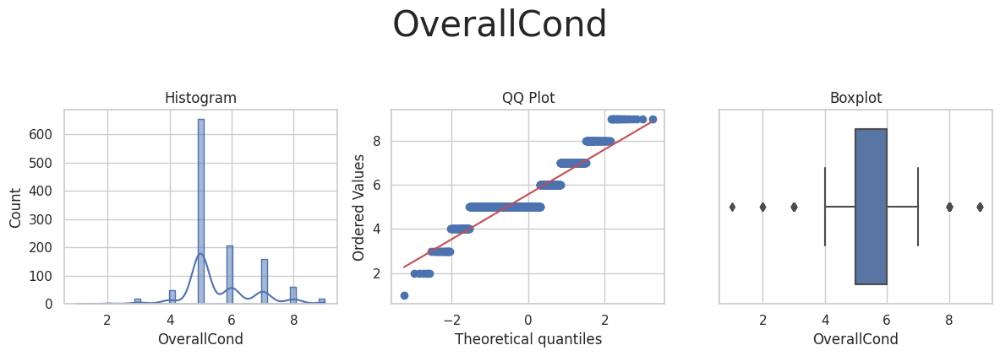

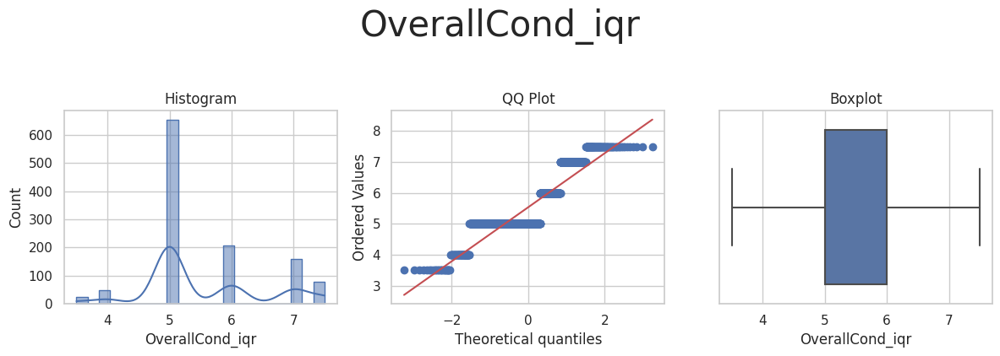



* Variable Analyzed: OverallCond_log_e
* Applied transformation: ['OverallCond_log_e_iqr'] 



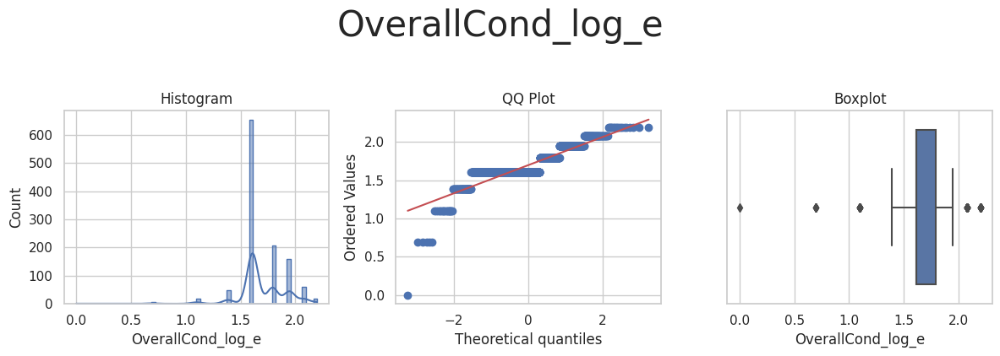

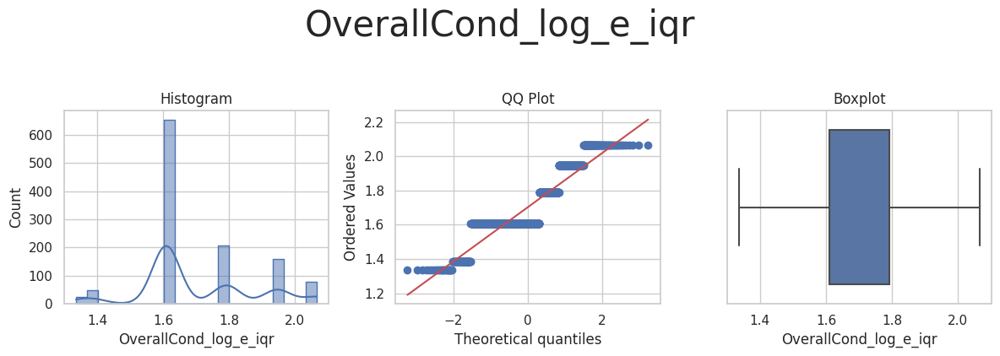



* Variable Analyzed: OverallCond_log_10
* Applied transformation: ['OverallCond_log_10_iqr'] 



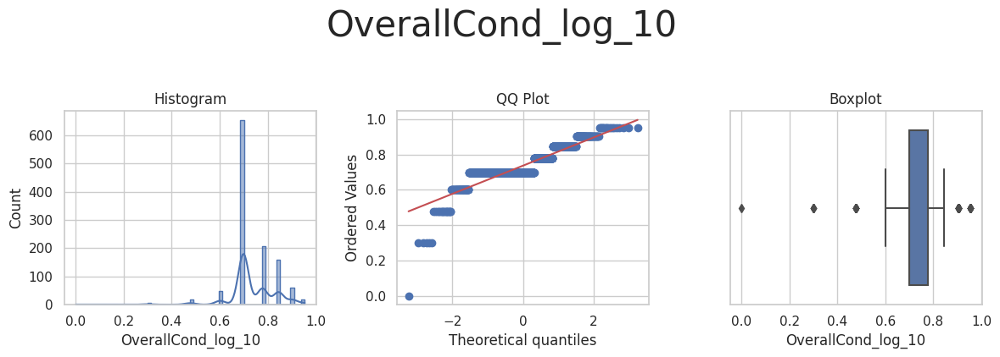

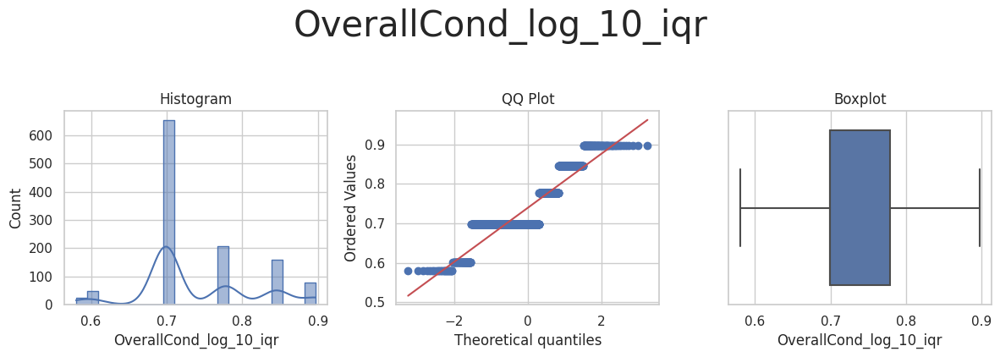



* Variable Analyzed: OverallCond_reciprocal
* Applied transformation: ['OverallCond_reciprocal_iqr'] 



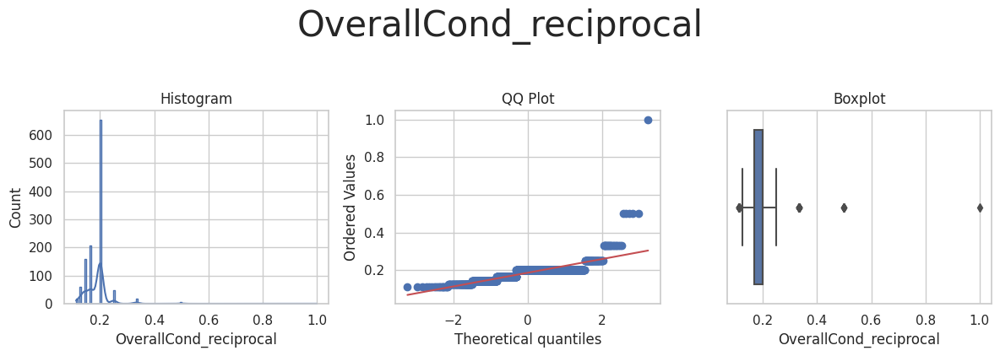

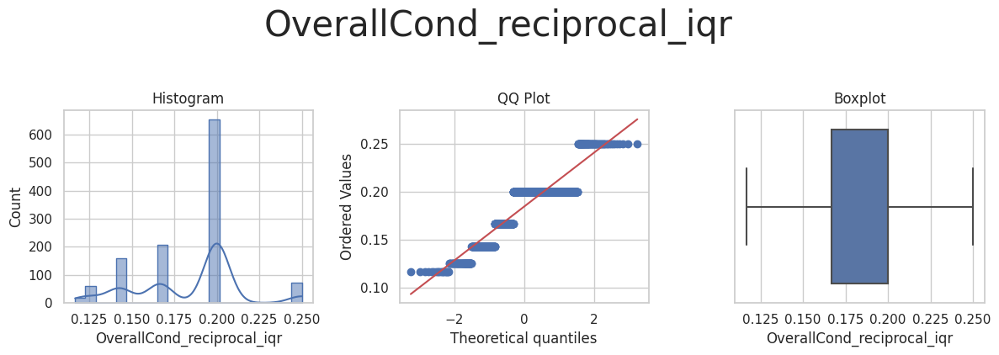



* Variable Analyzed: OverallCond_power
* Applied transformation: ['OverallCond_power_iqr'] 



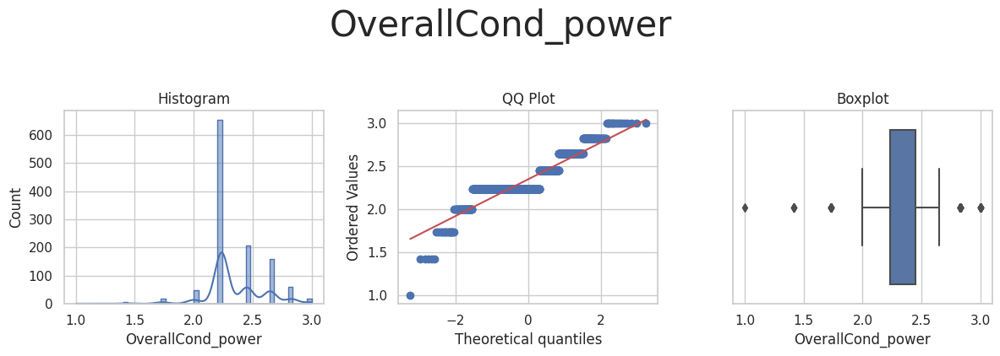

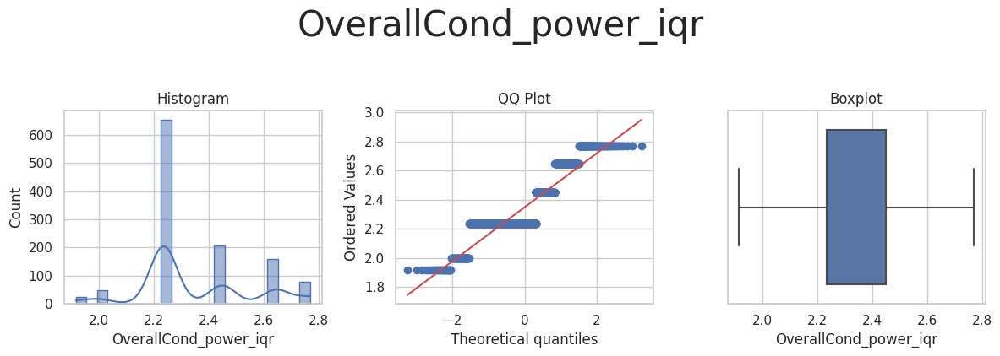



* Variable Analyzed: OverallCond_box_cox
* Applied transformation: ['OverallCond_box_cox_iqr'] 



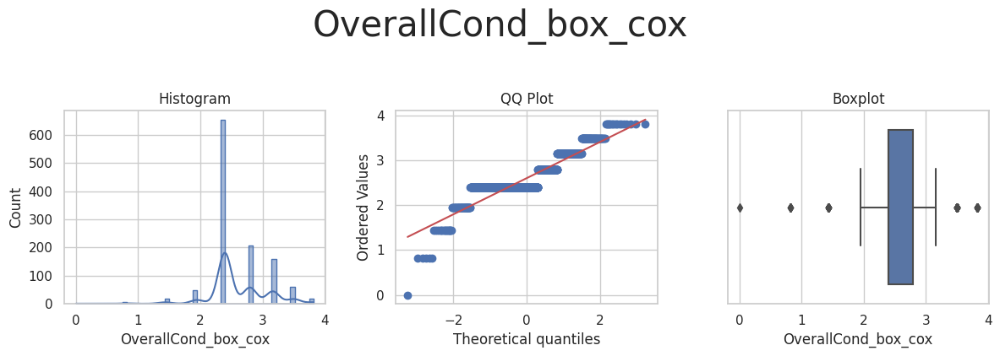

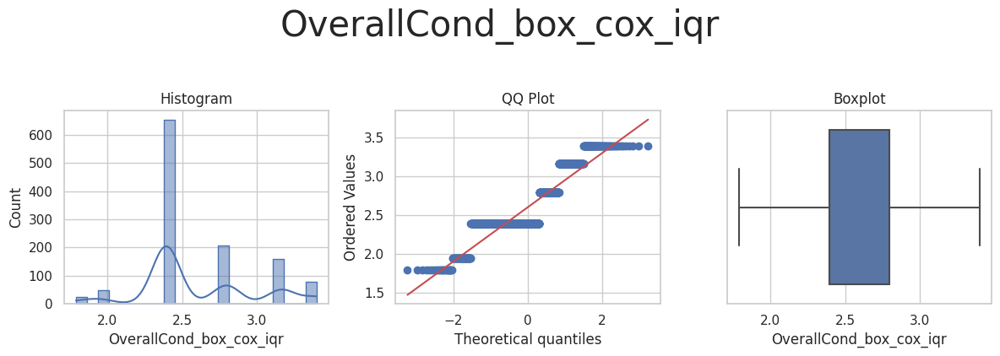



* Variable Analyzed: OverallCond_yeo_johnson
* Applied transformation: ['OverallCond_yeo_johnson_iqr'] 



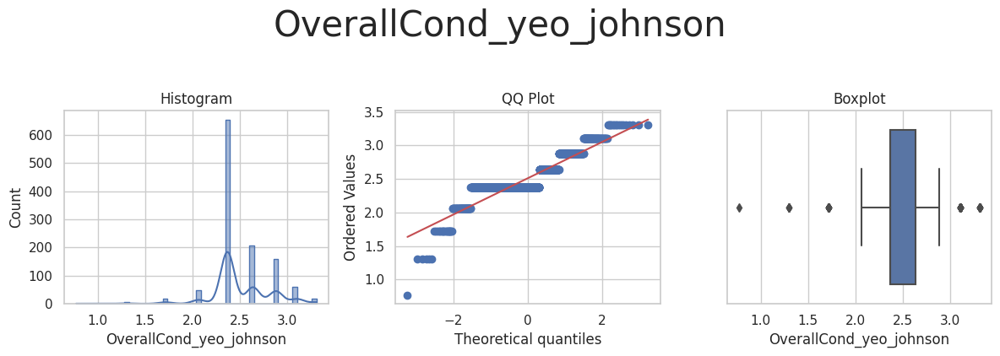

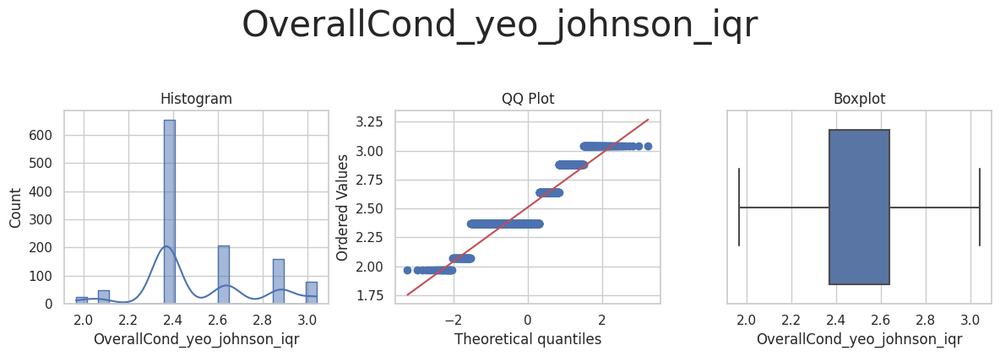



* Variable Analyzed: OverallQual
* Applied transformation: ['OverallQual_iqr'] 



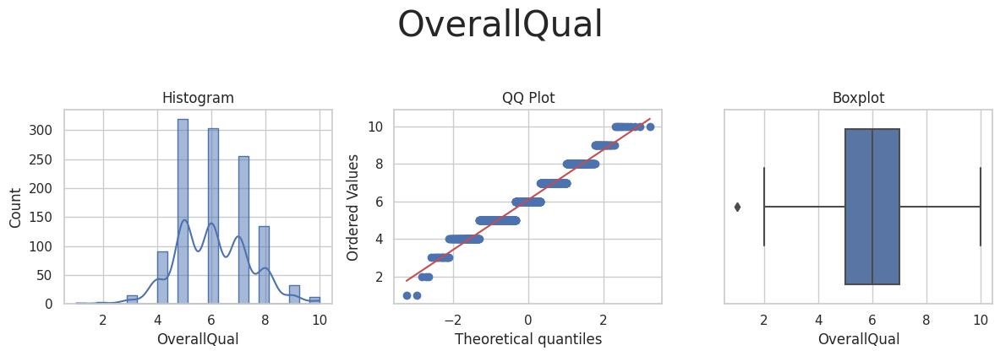

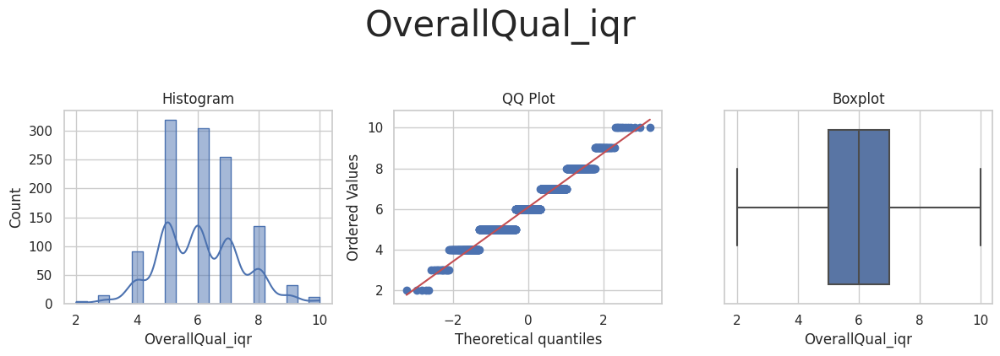



* Variable Analyzed: OverallQual_log_e
* Applied transformation: ['OverallQual_log_e_iqr'] 



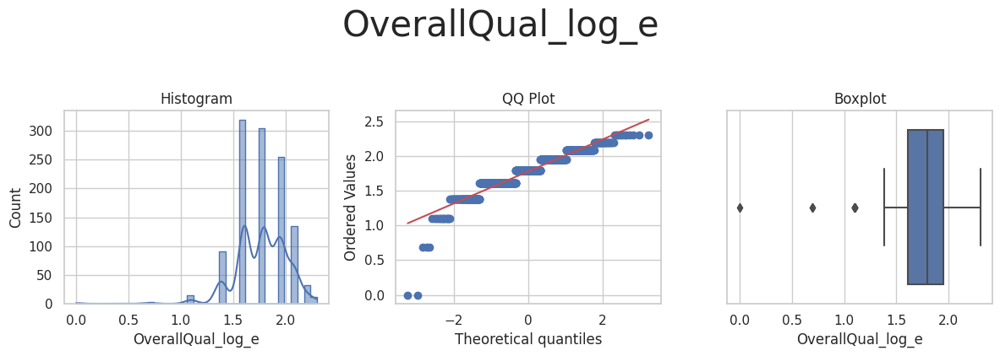

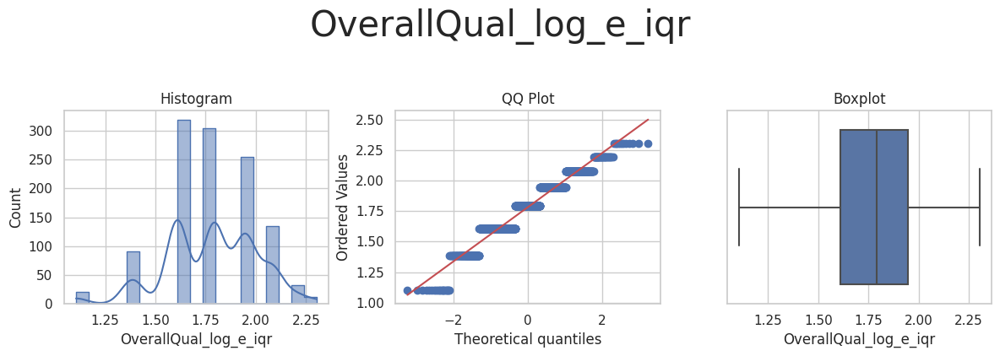



* Variable Analyzed: OverallQual_log_10
* Applied transformation: ['OverallQual_log_10_iqr'] 



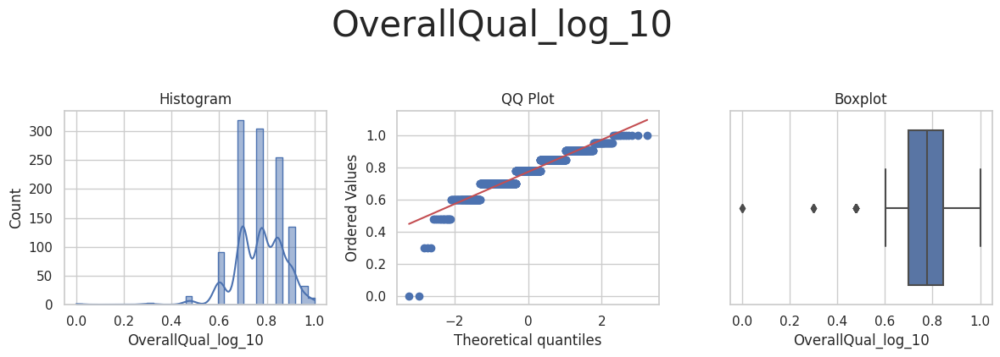

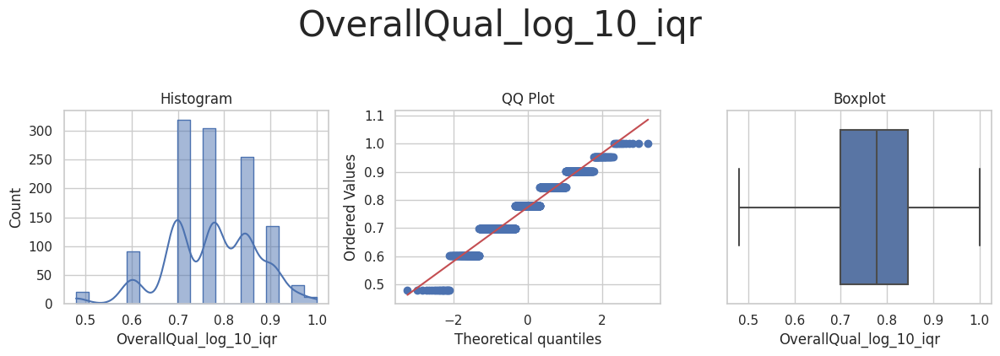



* Variable Analyzed: OverallQual_reciprocal
* Applied transformation: ['OverallQual_reciprocal_iqr'] 



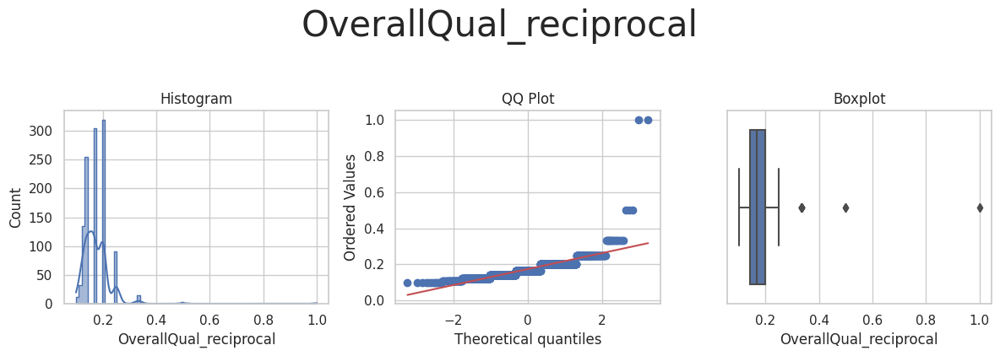

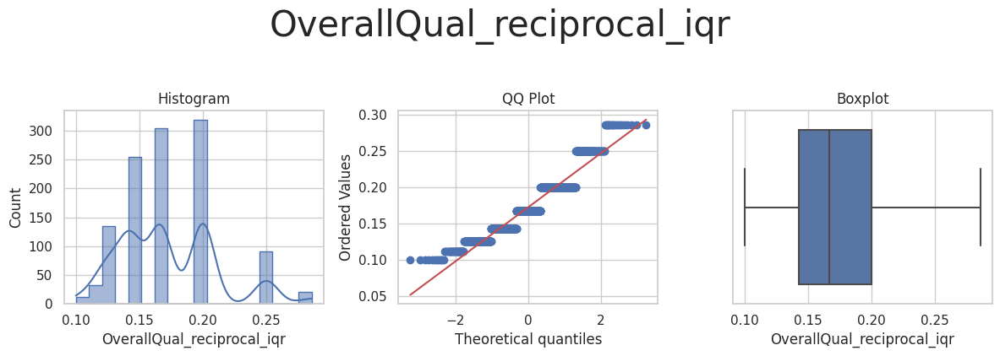



* Variable Analyzed: OverallQual_power
* Applied transformation: ['OverallQual_power_iqr'] 



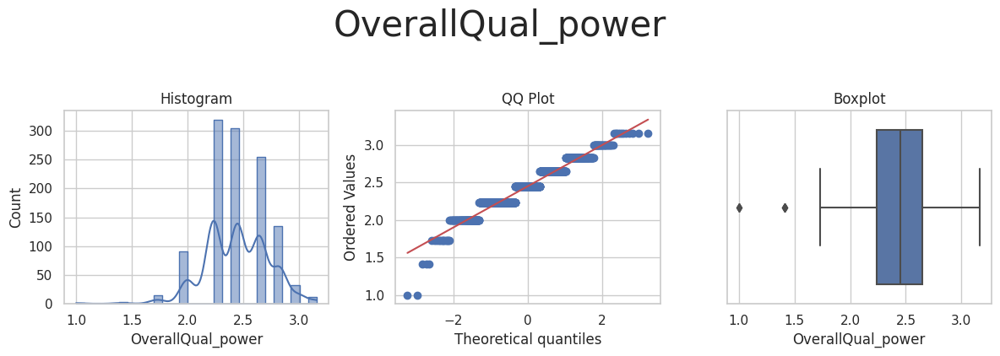

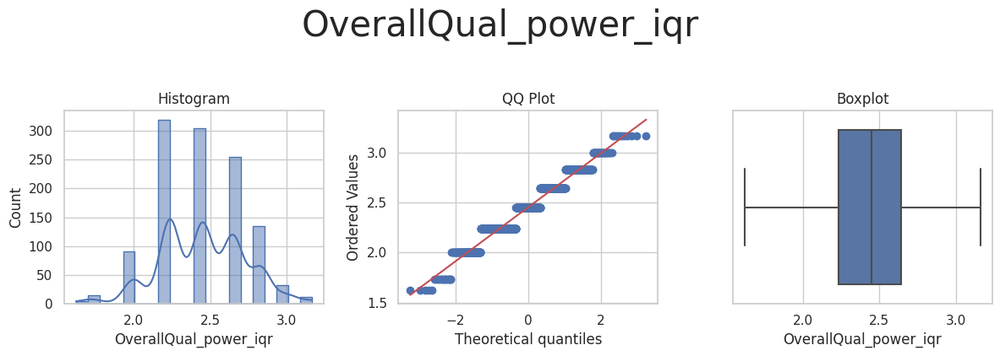



* Variable Analyzed: OverallQual_box_cox
* Applied transformation: ['OverallQual_box_cox_iqr'] 



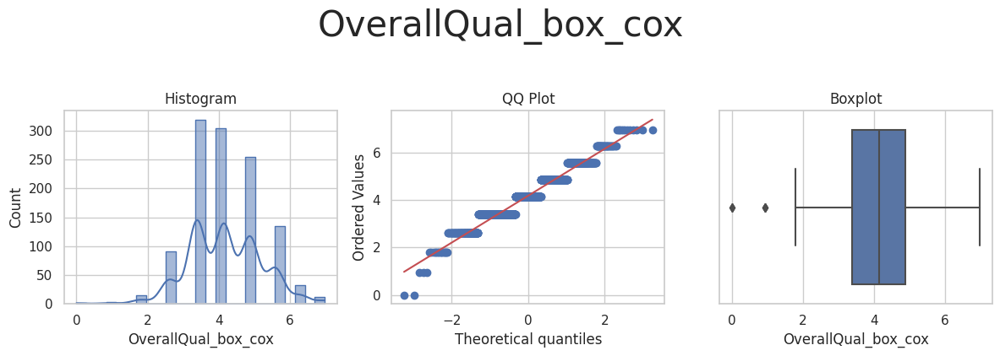

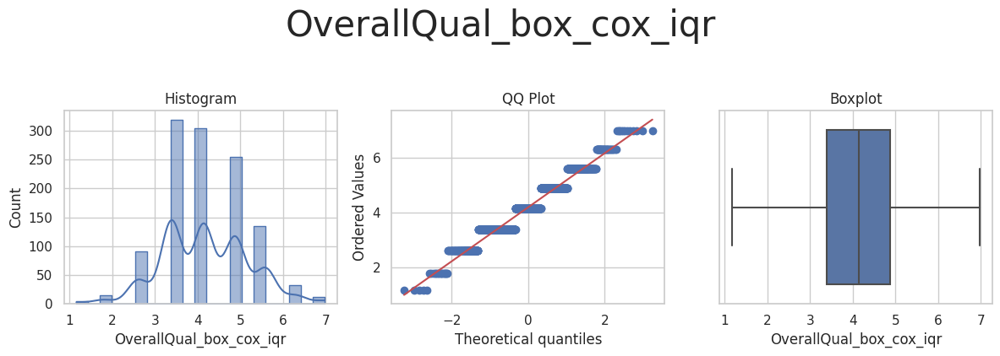



* Variable Analyzed: OverallQual_yeo_johnson
* Applied transformation: ['OverallQual_yeo_johnson_iqr'] 



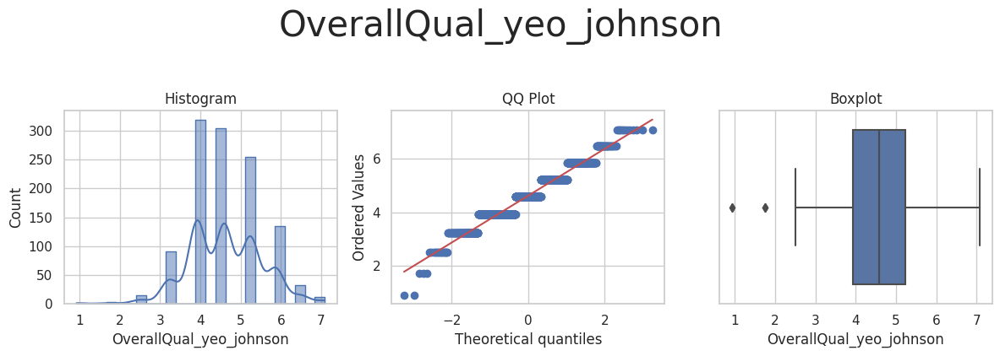

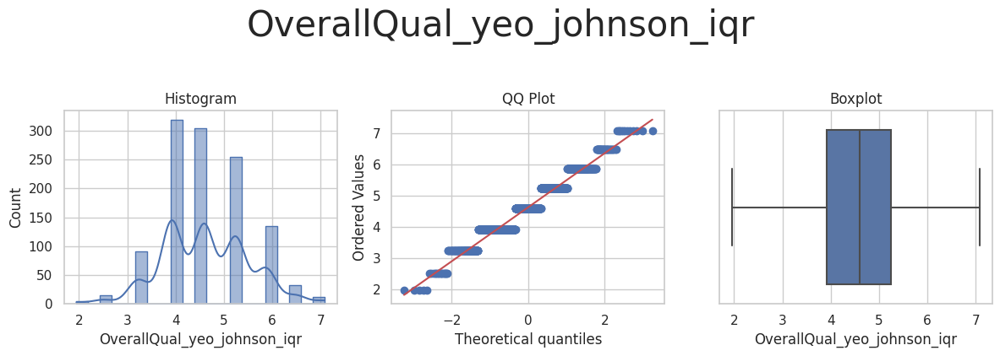



* Variable Analyzed: TotalBsmtSF
* Applied transformation: ['TotalBsmtSF_iqr'] 



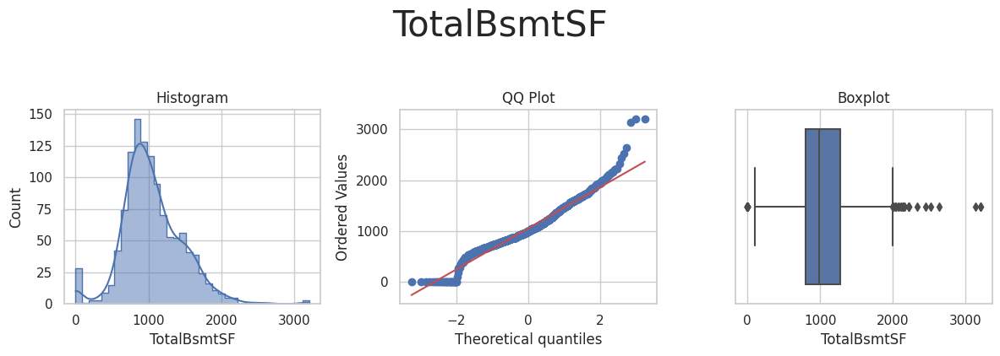

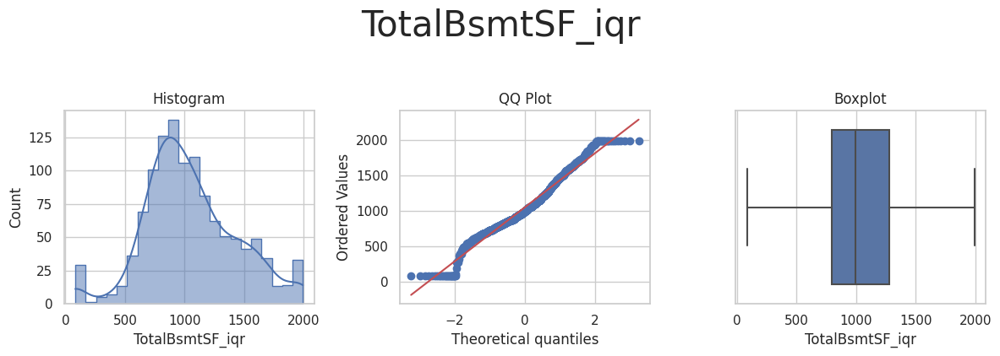



* Variable Analyzed: TotalBsmtSF_power
* Applied transformation: ['TotalBsmtSF_power_iqr'] 



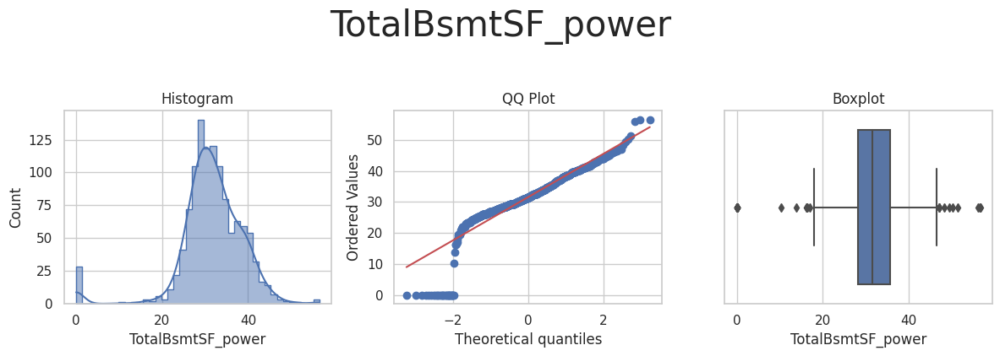

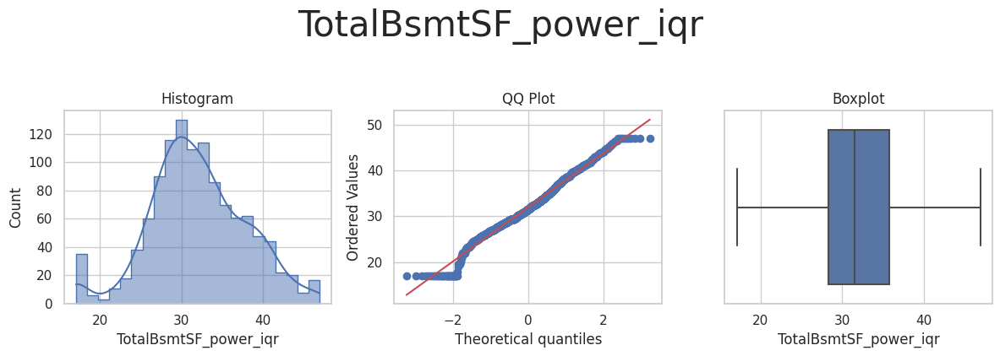



* Variable Analyzed: TotalBsmtSF_yeo_johnson
* Applied transformation: ['TotalBsmtSF_yeo_johnson_iqr'] 



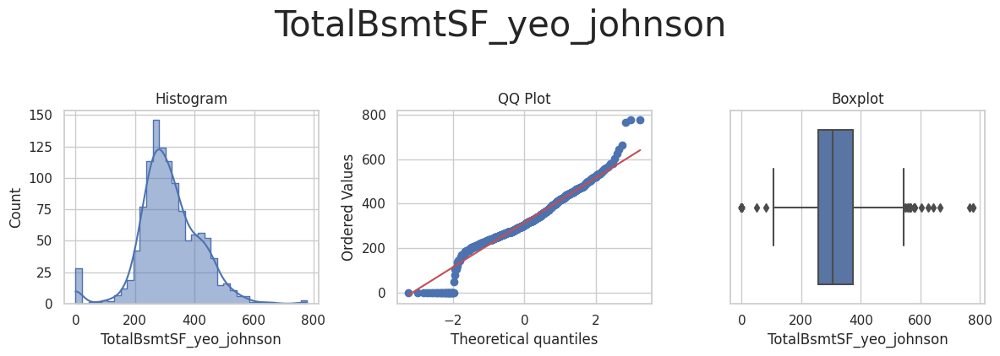

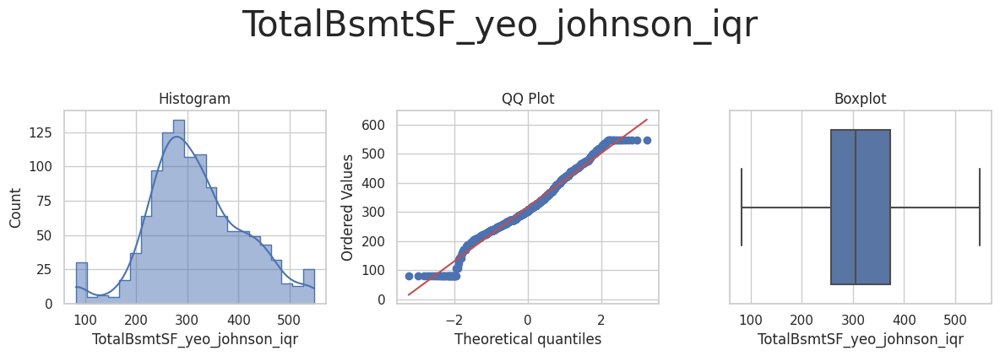



* Variable Analyzed: YearBuilt
* Applied transformation: ['YearBuilt_iqr'] 



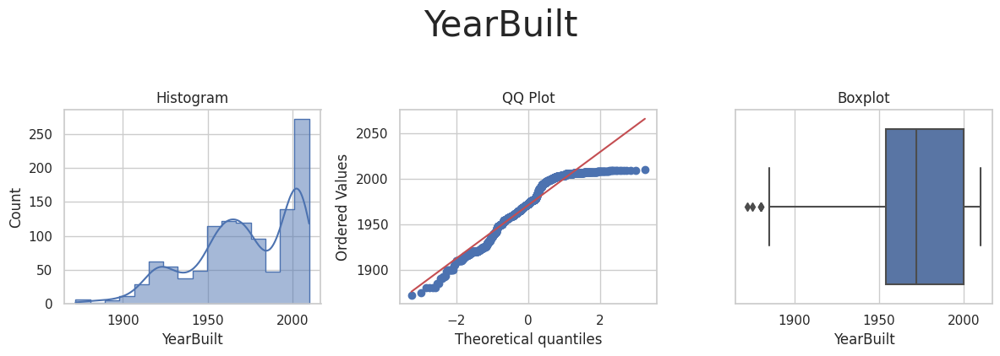

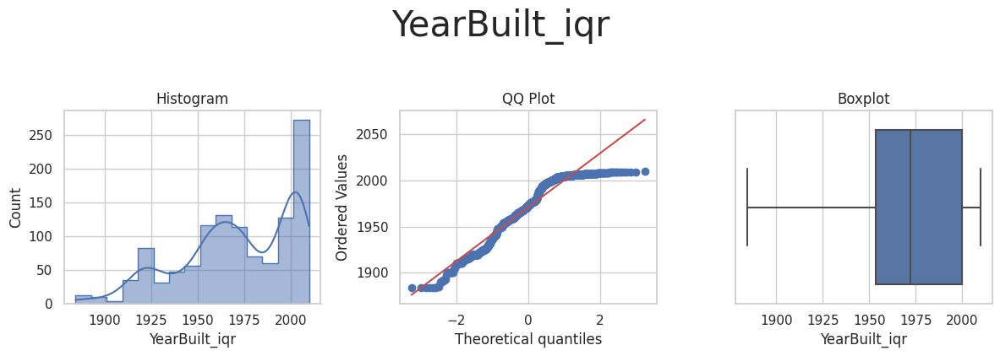



* Variable Analyzed: YearBuilt_log_e
* Applied transformation: ['YearBuilt_log_e_iqr'] 



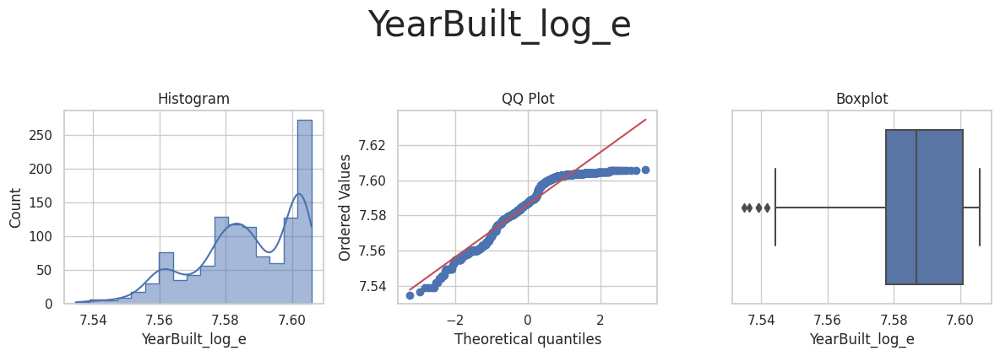

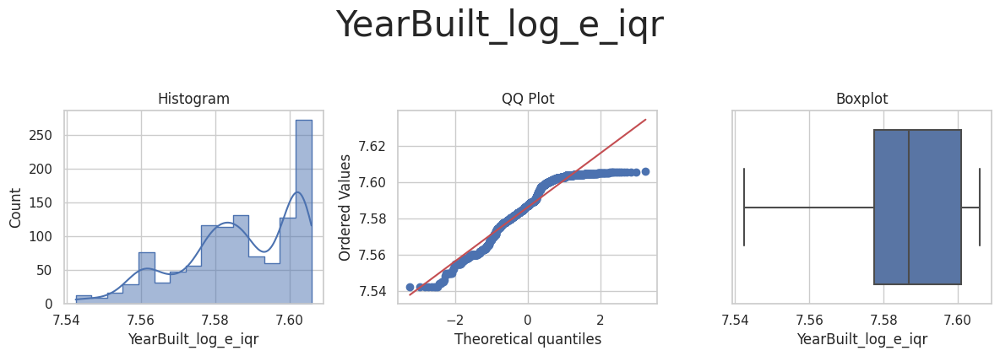



* Variable Analyzed: YearBuilt_log_10
* Applied transformation: ['YearBuilt_log_10_iqr'] 



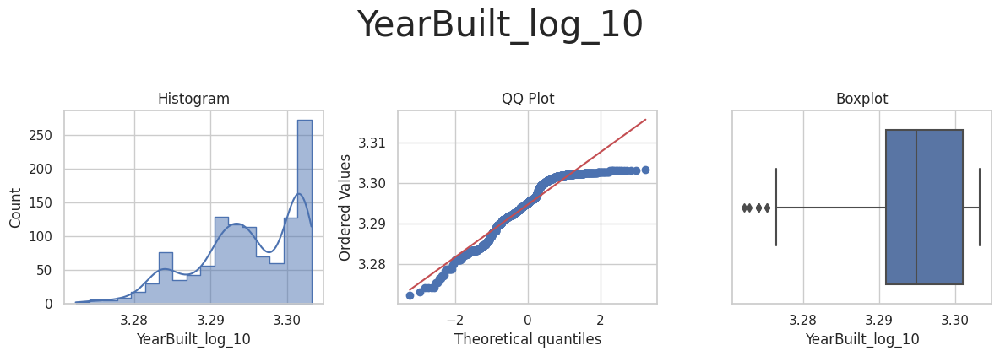

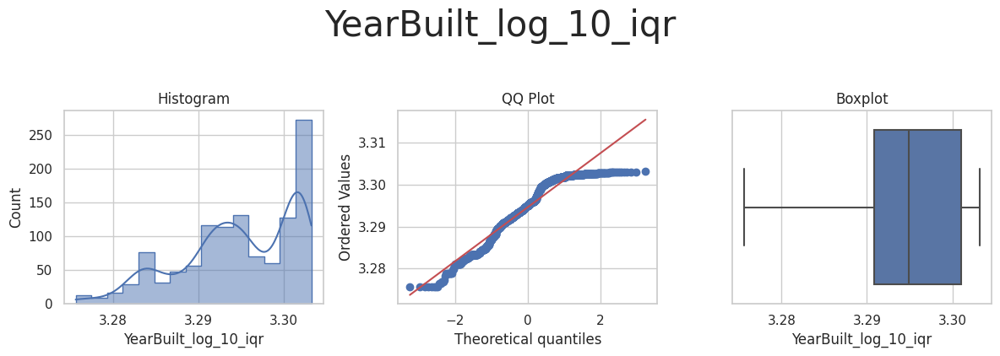



* Variable Analyzed: YearBuilt_reciprocal
* Applied transformation: ['YearBuilt_reciprocal_iqr'] 



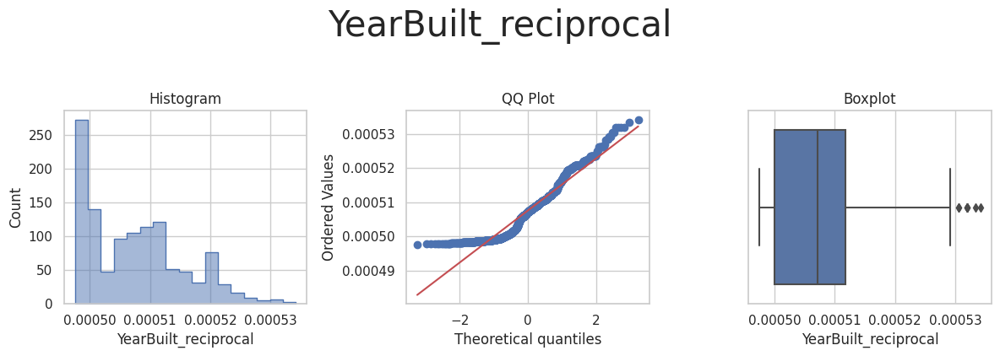

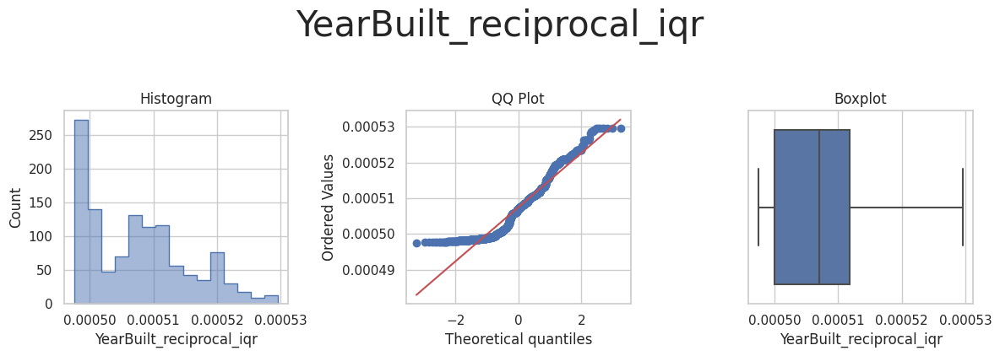



* Variable Analyzed: YearBuilt_power
* Applied transformation: ['YearBuilt_power_iqr'] 



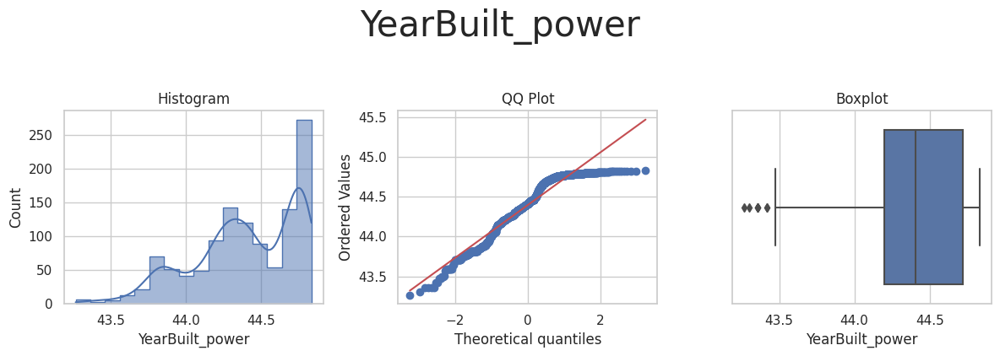

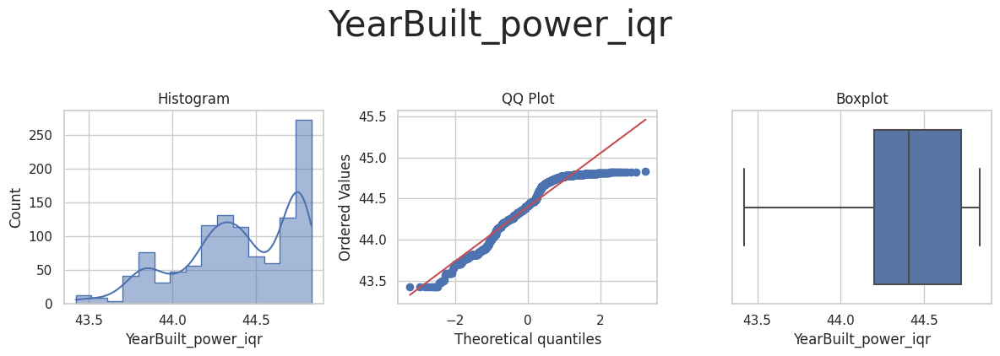



* Variable Analyzed: YearBuilt_box_cox
* Applied transformation: ['YearBuilt_box_cox_iqr'] 



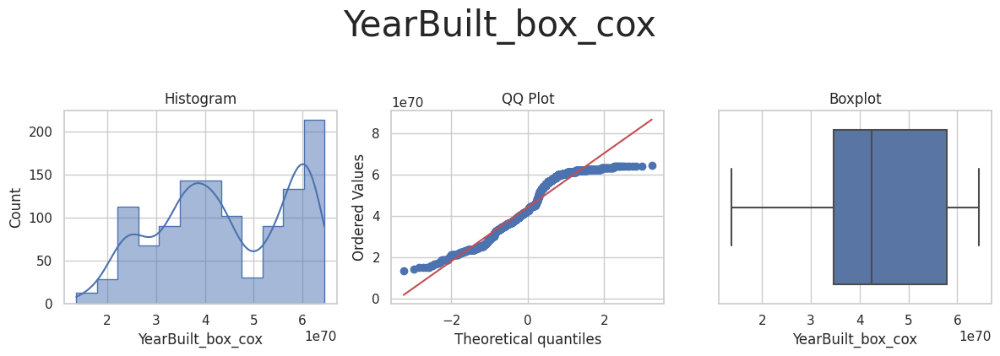

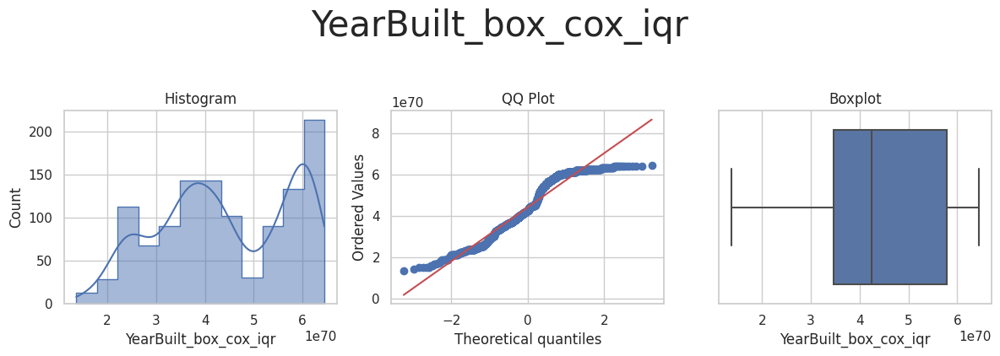



* Variable Analyzed: YearBuilt_yeo_johnson
* Applied transformation: ['YearBuilt_yeo_johnson_iqr'] 



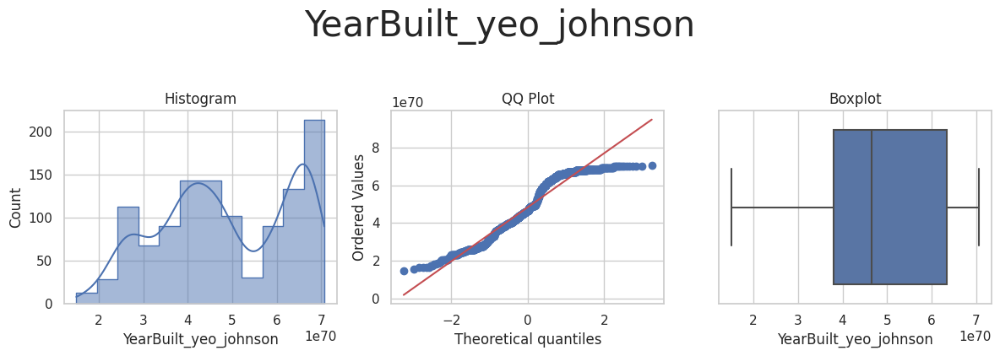

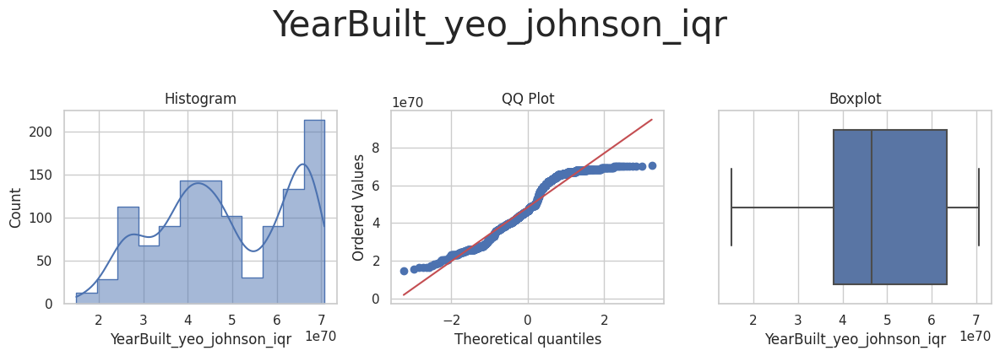



* Variable Analyzed: YearRemodAdd
* Applied transformation: ['YearRemodAdd_iqr'] 



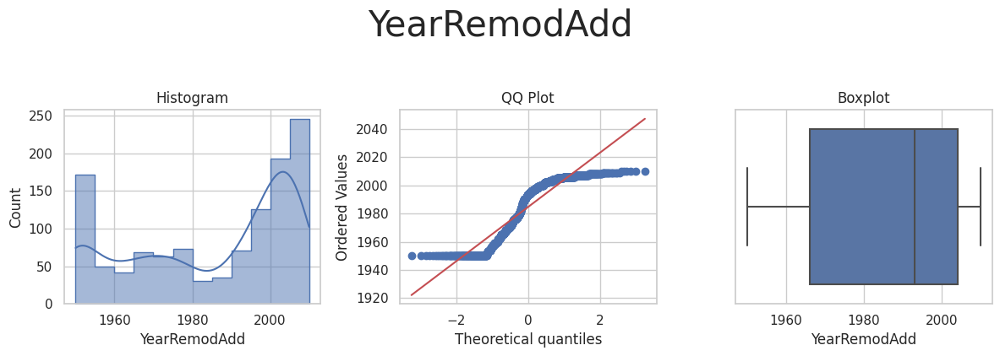

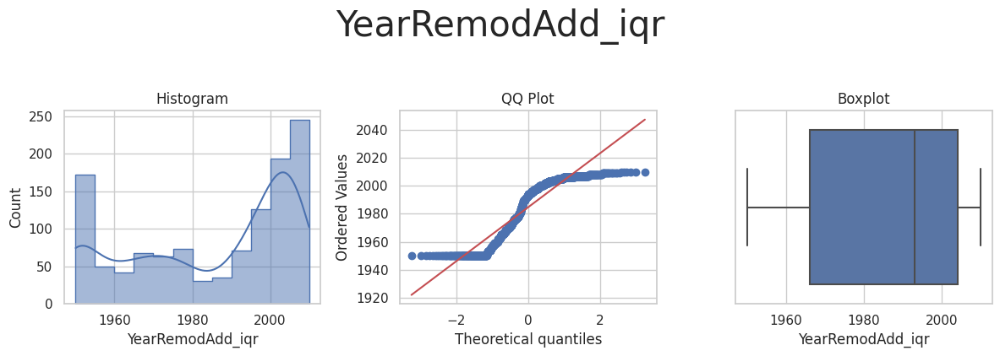



* Variable Analyzed: YearRemodAdd_log_e
* Applied transformation: ['YearRemodAdd_log_e_iqr'] 



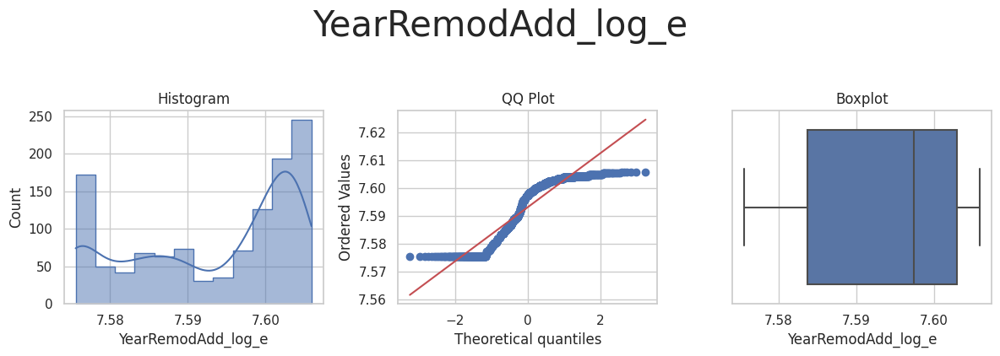

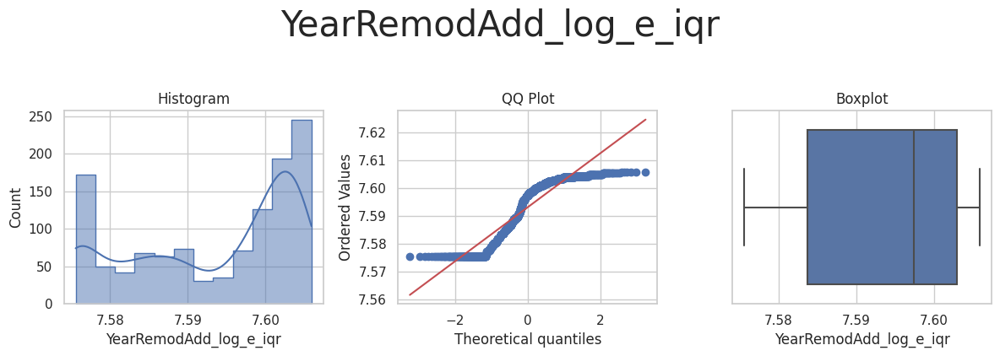



* Variable Analyzed: YearRemodAdd_log_10
* Applied transformation: ['YearRemodAdd_log_10_iqr'] 



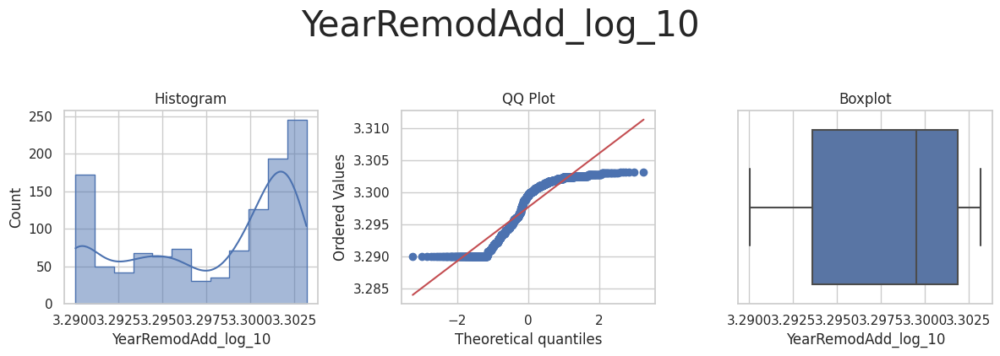

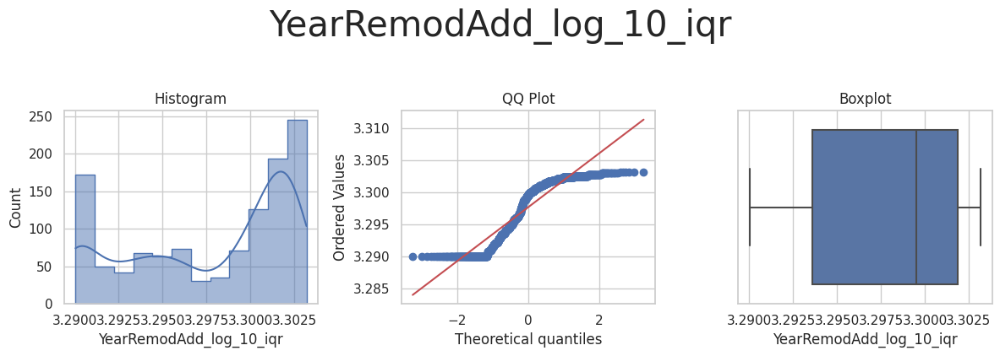



* Variable Analyzed: YearRemodAdd_reciprocal
* Applied transformation: ['YearRemodAdd_reciprocal_iqr'] 



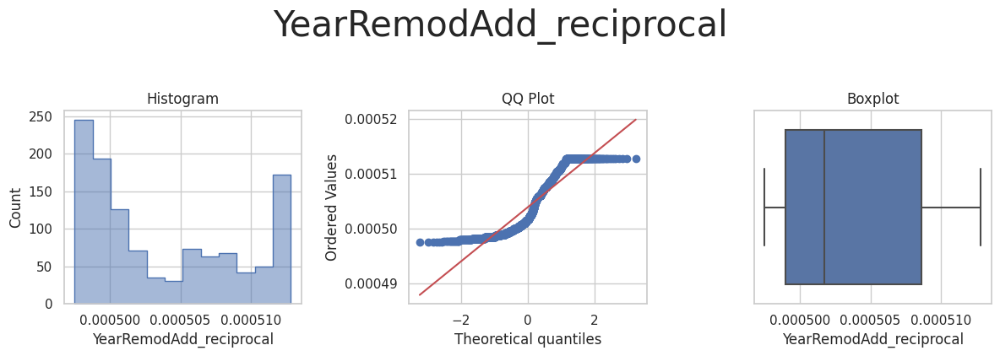

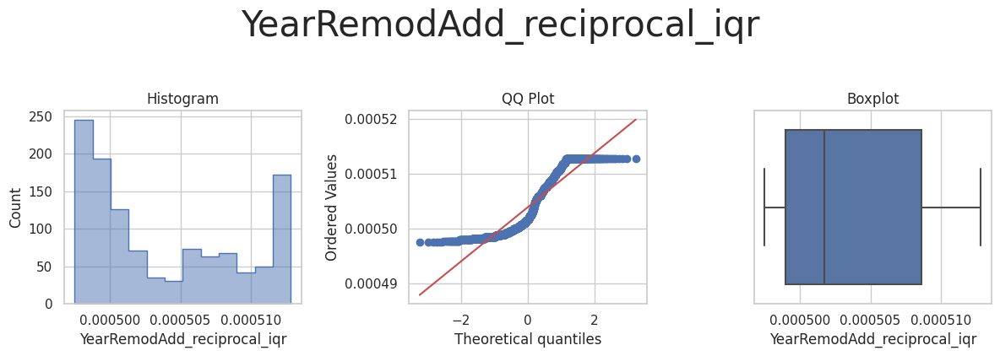



* Variable Analyzed: YearRemodAdd_power
* Applied transformation: ['YearRemodAdd_power_iqr'] 



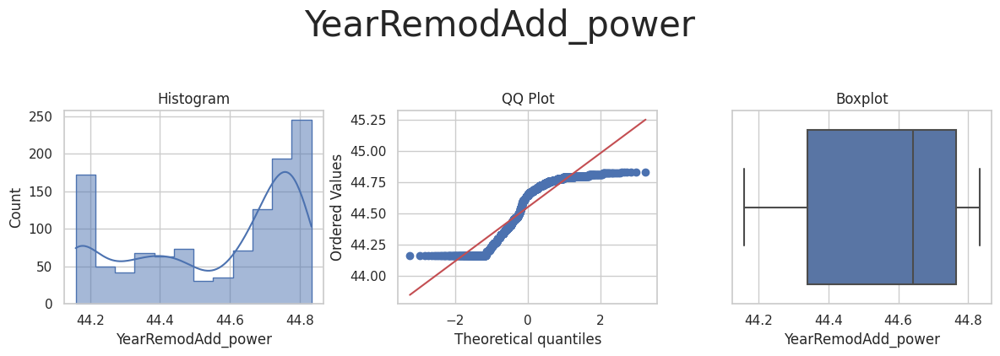

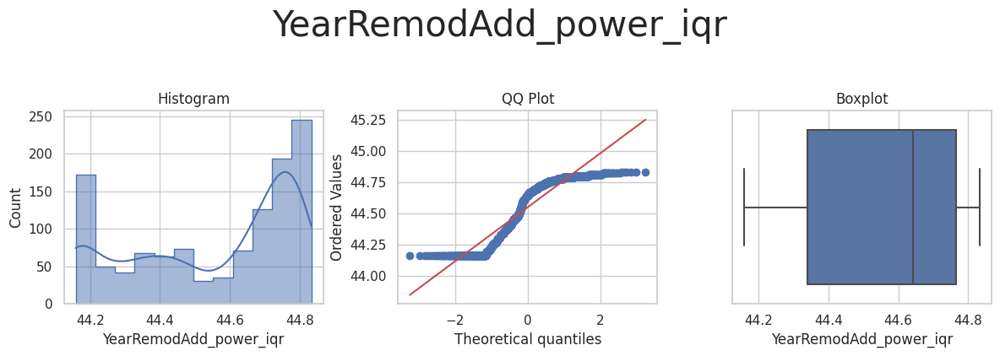



* Variable Analyzed: YearRemodAdd_box_cox
* Applied transformation: ['YearRemodAdd_box_cox_iqr'] 



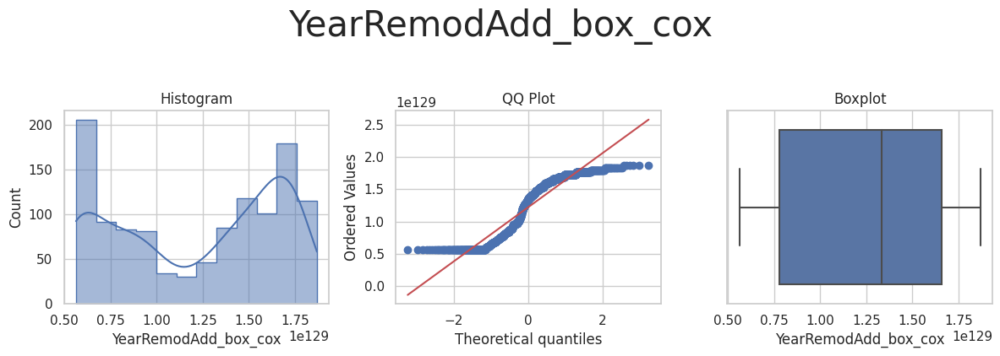

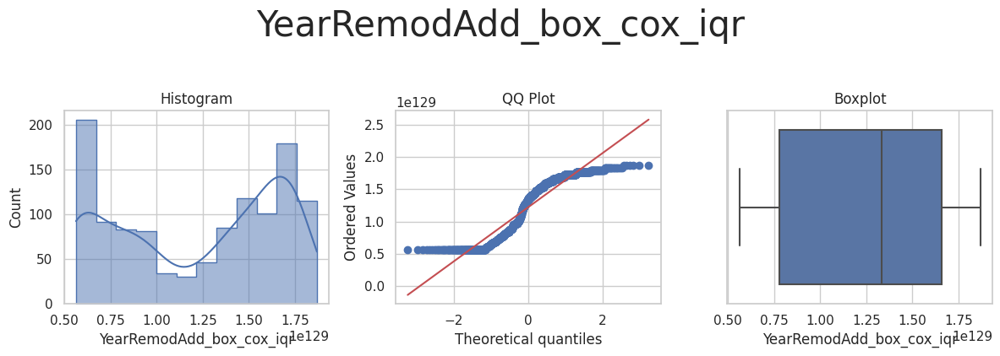



* Variable Analyzed: YearRemodAdd_yeo_johnson
* Applied transformation: ['YearRemodAdd_yeo_johnson_iqr'] 



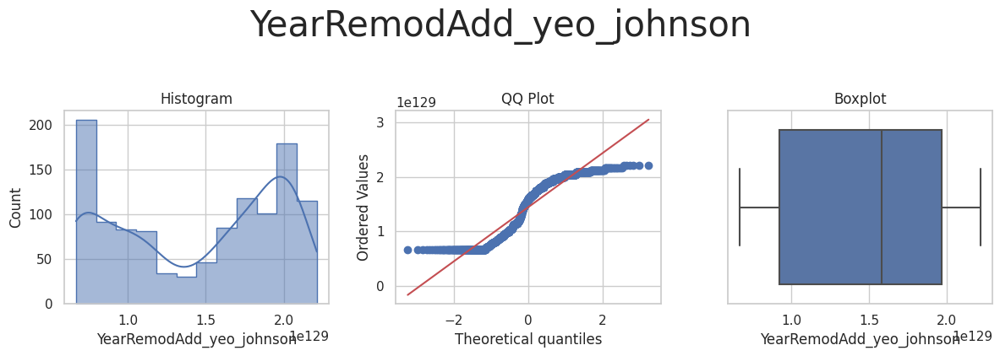

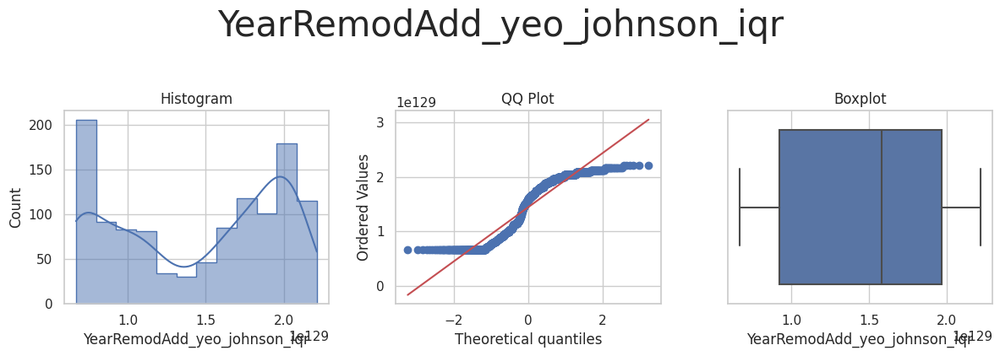

In [22]:
outliers = FeatureEngineeringAnalysis(df=df_method, analysis_type='outlier_winsorizer')

Analysis of the windsorized data shows, that the only variable that benefits from handling the outliers is the 'GrLivArea', so we will apply the Windsorizer transformation to only this one variable.

In [23]:
encoder = Winsorizer(capping_method='iqr', tail='both', fold=1.5, variables = ['GrLivArea'])

TrainSet = encoder.fit_transform(TrainSet)
TestSet = encoder.transform(TestSet)

print("* Outlier handling - Winsorization applied to 'GrLivArea' variable!")

* Outlier handling - Winsorization applied to 'GrLivArea' variable!


## Smart Correlation Selection

In [24]:
variables_smart_engineering = (TrainSet.select_dtypes(include=['float', 'int']).columns.to_list())
variables_smart_engineering.remove('SalePrice')
variables_smart_engineering

['1stFlrSF',
 '2ndFlrSF',
 'BedroomAbvGr',
 'BsmtExposure',
 'BsmtFinSF1',
 'BsmtFinType1',
 'BsmtUnfSF',
 'GarageArea',
 'GarageFinish',
 'GarageYrBlt',
 'GrLivArea',
 'KitchenQual',
 'LotArea',
 'LotFrontage',
 'MasVnrArea',
 'OpenPorchSF',
 'OverallCond',
 'OverallQual',
 'TotalBsmtSF',
 'YearBuilt',
 'YearRemodAdd']

In [25]:
df_method = TrainSet[variables_smart_engineering].copy()
df_method.head()

,1stFlrSF,2ndFlrSF,BedroomAbvGr,BsmtExposure,BsmtFinSF1,BsmtFinType1,BsmtUnfSF,GarageArea,GarageFinish,GarageYrBlt,...,KitchenQual,LotArea,LotFrontage,MasVnrArea,OpenPorchSF,OverallCond,OverallQual,TotalBsmtSF,YearBuilt,YearRemodAdd
0,7.850302,0.0,3.0,0,6.928203,0,40.321472,170.336793,0,2007.0,...,0,15.452051,193.293763,21.260292,4.880037,5,9,42.684892,2007,2007
1,7.087163,0.0,2.0,1,0.000000,0,28.758891,80.764330,0,1962.0,...,1,14.293967,143.485567,0.000000,0.000000,5,5,29.899833,1962,1962
2,7.167495,0.0,2.0,1,26.702060,1,12.415424,106.069606,0,1921.0,...,1,15.724559,177.681408,0.000000,0.000000,7,5,29.597297,1921,2006
3,7.765823,0.0,3.0,1,34.899857,2,18.106165,185.112468,1,2002.0,...,0,15.709931,159.422640,12.165525,4.237583,5,8,39.597980,2002,2002
4,7.667895,0.0,3.0,1,0.000000,0,37.617113,182.637793,1,2001.0,...,0,15.776694,233.040712,12.247449,4.572940,5,7,39.255573,2001,2002


In [26]:
from feature_engine.selection import SmartCorrelatedSelection
corr_sel = SmartCorrelatedSelection(variables=None, method="spearman", threshold=0.6, selection_method="variance")

corr_sel.fit_transform(df_method)
corr_sel.correlated_feature_sets_

[{'1stFlrSF', 'TotalBsmtSF'},
 {'2ndFlrSF', 'GrLivArea'},
 {'GarageYrBlt', 'YearBuilt', 'YearRemodAdd'}]

In [27]:
corr_sel.features_to_drop_

['1stFlrSF', 'GarageYrBlt', 'GrLivArea', 'YearRemodAdd']

---

# Conclusions


In this notebook, we conducted a thorough feature analysis and feature engineering on the dataset. We identified a set of data transformations and the variables they should be applied to. We created separate pipelines for each type of transformation. In the upcoming notebook, we will consolidate these pipelines into a single unified pipeline and select the optimal model for predicting the target variable.

Decided transformations


- **BsmtExposure**
  - Transformation: OrdinalEncoder, SmartCorrelatedSelection

- **BsmtFinType1**
  - Transformation: OrdinalEncoder, SmartCorrelatedSelection

- **GarageFinish**
  - Transformation: OrdinalEncoder, SmartCorrelatedSelection

- **KitchenQual**
  - Transformation: OrdinalEncoder, SmartCorrelatedSelection

- **OverallCond**
  - Transformation: SmartCorrelatedSelection

- **OverallQual**
  - Transformation: SmartCorrelatedSelection

- **1stFlrSF**
  - Transformation: Numerical - log_e, SmartCorrelatedSelection

- **2ndFlrSF**
  - Transformation: SmartCorrelatedSelection

- **BsmtFinSF1**
  - Transformation: SmartCorrelatedSelection

- **BsmtUnfSF**
  - Transformation: Numerical - yeo_johnson, SmartCorrelatedSelection

- **GarageArea**
  - Transformation: Numerical - yeo_johnson, SmartCorrelatedSelection

- **GrLivArea**
  - Transformation: Numerical - log_e, Windsorizer, SmartCorrelatedSelection

- **LotArea**
  - Transformation: Numerical - power, SmartCorrelatedSelection

- **LotFrontage**
  - Transformation: SmartCorrelatedSelection

- **MasVnrArea**
  - Transformation: SmartCorrelatedSelection

- **OpenPorchSF**
  - Transformation: SmartCorrelatedSelection

- **TotalBsmtSF**
  - Transformation: Numerical - yeo_johnson, SmartCorrelatedSelection

- **BedroomAbvGr**
  - Transformation: SmartCorrelatedSelection

- **GarageYrBlt**
  - Transformation: SmartCorrelatedSelection

- **YearBuilt**
  - Transformation: SmartCorrelatedSelection

- **YearRemodAdd**
  - Transformation: SmartCorrelatedSelection

- **SalePrice**
  - Transformation: None (target variable)